<a href="https://colab.research.google.com/github/suhas-arun/Neural-Networks/blob/master/CelebAGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The model requires the CelebA dataset to be downloaded from Kaggle. This requires a valid Kaggle API key to be uploaded below.

In [2]:
!pip install kaggle
from google.colab import files
files.upload();

Saving kaggle.json to kaggle.json


Download the dataset from [Kaggle](https://www.kaggle.com/jessicali9530/celeba-dataset).

In [3]:
!mkdir ~/.kaggle
!mv kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d jessicali9530/celeba-dataset
!mkdir data
!unzip celeba-dataset.zip -d data

Streaming output truncated to the last 5000 lines.
  inflating: data/img_align_celeba/img_align_celeba/197605.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197606.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197607.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197608.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197609.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197610.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197611.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197612.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197613.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197614.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197615.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197616.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197617.jpg  
  inflating: data/img_align_celeba/img_align_celeba/197618.jpg  
  inflating: data/img_align_celeba/img_

Import necessary packages

In [0]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
from tensorflow.keras import layers
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import time

Preprocess the image data. The images are scaled down to 64x64x3

In [0]:
path = "data/img_align_celeba/img_align_celeba"
image_files = np.sort(os.listdir(path)[:100000])
SHAPE = (64, 64, 3)

train_data = []
for im in image_files:
    image = load_img(f"{path}/{im}", target_size=SHAPE[:2])
    image = (img_to_array(image)/255)
    train_data.append(image)

train_data = np.array(train_data)

Plot sample images from the dataset

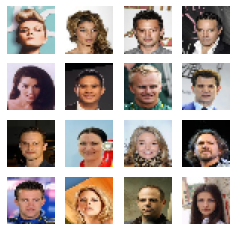

In [13]:
fig = plt.figure(figsize=(4, 4))

for i in range(16):
    plt.subplot(4, 4, i+1)
    plt.imshow((train_data[i+1]))
    plt.axis('off')

plt.show()

# Creating the Model

Both the generator and discriminator networks use Keras' Functional API.

## Generator
The generator network has the following architecture:
* Dense layer of 1024 neurons with ReLU activation
* Dense layer of 8192 neurons with ReLU activation
* Reshape layer to size (8, 8, 128)

* 3 sets of transposed convolutional layers and regular convolutional layers.
    * Transposed convolutional layers have kernel size and stride length of 2 and do not use bias.
    * Convolutional layers have kernel size 1 and use the ReLU activation function.

* Output convolutional layers with 3 filters (for 3 channels) with sigmoid activation.




In [0]:
def create_generator():
    input_noise = layers.Input(shape=(100,))
    gen = layers.Dense(1024, activation="relu")(input_noise)
    gen = layers.Dense(128*8*8, activation="relu")(gen)
    gen = layers.Reshape((8, 8, 128))(gen)

    gen = layers.Conv2DTranspose(128, kernel_size=(2, 2), strides=(2, 2), use_bias=False)(gen)
    gen = layers.Conv2D(64, (1, 1), activation="relu", padding="same")(gen)

    gen = layers.Conv2DTranspose(32, kernel_size=(2, 2), strides=(2, 2), use_bias=False)(gen)
    gen = layers.Conv2D(64, (1, 1), activation="relu", padding="same")(gen)

    gen = layers.Conv2DTranspose(32, kernel_size=(2, 2), strides=(2, 2), use_bias=False)(gen)
    gen = layers.Conv2D(64, (1, 1), activation="relu", padding="same")(gen)

    output = layers.Conv2D(3, (1, 1), activation="sigmoid", padding="same")(gen)
    
    generator = Model(input_noise, output)

    return generator

## Discriminator

The discriminator network has the following architecture:

* 3 sets of two convolutional layers followed by a max-pooling layer and a dropout layer.
    * Convolutional layers have kernel size of 3 and use the Leaky ReLU activation function.
    * The max-pooling layer uses a kernel size and stride length of 2.

* The output is flattened and passed into a dense layer of 1024 neurons ReLU activation.
* The final output is a single sigmoid neuron.

In [0]:
def create_discriminator():
    input_image = layers.Input(shape=SHAPE)

    dis = layers.Conv2D(32, (3, 3), padding="same")(input_image)
    dis = layers.LeakyReLU()(dis)
    dis = layers.Conv2D(32, (3, 3), padding="same")(dis)
    dis = layers.LeakyReLU()(dis)
    dis = layers.MaxPooling2D((2, 2), strides=(2, 2))(dis)
    dis = layers.Dropout(0.3)(dis)

    dis = layers.Conv2D(64, (3, 3), padding="same")(dis)
    dis = layers.LeakyReLU()(dis)
    dis = layers.Conv2D(64, (3, 3), padding="same")(dis)
    dis = layers.LeakyReLU()(dis)
    dis = layers.MaxPooling2D((2, 2), strides=(2, 2))(dis)
    dis = layers.Dropout(0.3)(dis)


    dis = layers.Conv2D(128, (3, 3), padding="same")(dis)
    dis = layers.LeakyReLU()(dis)
    dis = layers.Conv2D(128, (3, 3), padding="same")(dis)
    dis = layers.LeakyReLU()(dis)
    dis = layers.MaxPooling2D((2, 2), strides=(1, 1))(dis)
    dis = layers.Dropout(0.3)(dis)

        
    dis = layers.Flatten()(dis)
    dis = layers.Dense(1024, activation="relu")(dis)
    output = layers.Dense(1, activation="sigmoid")(dis)

    discriminator = Model(input_image, output)

    return discriminator

Define functions to generate and plot faces and to return random noise.

In [0]:
def get_noise(num_images=1, noise_dim=100):
    return np.random.normal(0, 1, (num_images, noise_dim))

def generate_images(num_images):
    imgs = generator.predict(get_noise(num_images))

    fig = plt.figure(figsize=(4, 4))

    for i in range(num_images):
        plt.subplot(4, 4, i+1)
        plt.imshow(imgs[i])
        plt.axis('off')

    plt.show()

Compile the two networks. Both networks use the Adam optimiser with learning rate 0.0001. The two models are combined and compiled with the binary crossentropy loss function.

In [49]:
generator = create_generator()
discriminator = create_discriminator()

optimiser = tf.keras.optimizers.Adam(0.0001, 0.5)

generator.compile(loss='binary_crossentropy', optimizer=optimiser)
discriminator.compile(loss='binary_crossentropy', optimizer = optimiser, metrics=['accuracy'])

combined_input = layers.Input(shape=(100,))
gen_image = generator(combined_input)
discriminator.trainable = False
valid = discriminator(gen_image)
combined = Model(combined_input, valid)
combined.compile(loss='binary_crossentropy', optimizer=optimiser)

generator.summary()
discriminator.summary()
combined.summary()

Model: "model_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_25 (InputLayer)        [(None, 100)]             0         
_________________________________________________________________
dense_31 (Dense)             (None, 1024)              103424    
_________________________________________________________________
dense_32 (Dense)             (None, 8192)              8396800   
_________________________________________________________________
reshape_8 (Reshape)          (None, 8, 8, 128)         0         
_________________________________________________________________
conv2d_transpose_23 (Conv2DT (None, 16, 16, 128)       65536     
_________________________________________________________________
conv2d_79 (Conv2D)           (None, 16, 16, 64)        8256      
_________________________________________________________________
conv2d_transpose_24 (Conv2DT (None, 32, 32, 32)        819

Training the models.

In [0]:
def train(train_images, noise, epochs, batch_size):
    num_images, noise_dim = noise.shape
    half_batch = int(batch_size / 2)
    history = []
    for epoch in range(epochs):
        # Train the discriminator 
        real_images = train_images[np.random.randint(0, train_images.shape[0], half_batch)]

        generated_images = generator.predict(get_noise(half_batch, noise_dim))

        discriminator_real_loss = discriminator.train_on_batch(real_images, np.ones((half_batch, 1)))
        discriminator_fake_loss = discriminator.train_on_batch(generated_images, np.zeros((half_batch, 1)))
        discriminator_loss = np.add(discriminator_real_loss, discriminator_fake_loss)

        # Train the generator

        input_noise = get_noise(batch_size, noise_dim)

        test = (np.array([1] * batch_size)).reshape(batch_size,1)

        generator_loss = combined.train_on_batch(input_noise, test)

        history.append([discriminator_loss, generator_loss])

        if epoch % 10 == 0:
            print(f"Epoch {epoch}, Discriminator: Loss: {discriminator_loss[0]} Accuracy: {discriminator_loss[1] / 2}, Generator Loss: {generator_loss}, Time: {time.time() - start_time}")

        if epoch % 100 == 0:
            generate_images(num_images)
            generator.save_weights("generator_weights")
    
    return history


The models are trained for 20000 epochs with batch size 512.

Epoch 0, Discriminator: Loss: 3.505078613758087 Accuracy: 0.474609375, Generator Loss: 0.30562838912010193, Time: 3.618411064147949


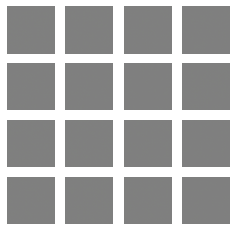

Epoch 10, Discriminator: Loss: 1.3188137412071228 Accuracy: 0.484375, Generator Loss: 0.7781978249549866, Time: 7.902115821838379
Epoch 20, Discriminator: Loss: 1.3774262070655823 Accuracy: 0.62890625, Generator Loss: 1.2750705480575562, Time: 11.311399936676025
Epoch 30, Discriminator: Loss: 0.7585098743438721 Accuracy: 0.970703125, Generator Loss: 1.4729325771331787, Time: 14.722740173339844
Epoch 40, Discriminator: Loss: 0.34199921786785126 Accuracy: 0.978515625, Generator Loss: 2.2552225589752197, Time: 18.13607668876648
Epoch 50, Discriminator: Loss: 0.029592446517199278 Accuracy: 0.998046875, Generator Loss: 4.012941837310791, Time: 21.56100296974182
Epoch 60, Discriminator: Loss: 0.5114142000675201 Accuracy: 0.88671875, Generator Loss: 9.90326976776123, Time: 24.970765590667725
Epoch 70, Discriminator: Loss: 0.297563761472702 Accuracy: 0.97265625, Generator Loss: 2.2389352321624756, Time: 28.3831946849823
Epoch 80, Discriminator: Loss: 0.522862121462822 Accuracy: 0.935546875, Ge

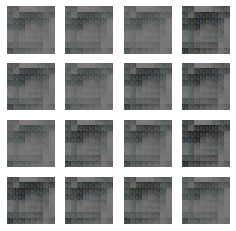

Epoch 110, Discriminator: Loss: 0.511203795671463 Accuracy: 0.919921875, Generator Loss: 2.3686435222625732, Time: 42.75226140022278
Epoch 120, Discriminator: Loss: 0.11744944006204605 Accuracy: 0.984375, Generator Loss: 3.433703899383545, Time: 46.16207242012024
Epoch 130, Discriminator: Loss: 0.1875782459974289 Accuracy: 0.9765625, Generator Loss: 3.891925811767578, Time: 49.58000588417053
Epoch 140, Discriminator: Loss: 0.3072621673345566 Accuracy: 0.951171875, Generator Loss: 2.9826505184173584, Time: 52.98567247390747
Epoch 150, Discriminator: Loss: 0.2958001643419266 Accuracy: 0.974609375, Generator Loss: 3.5312232971191406, Time: 56.41149663925171
Epoch 160, Discriminator: Loss: 0.2171562910079956 Accuracy: 0.982421875, Generator Loss: 3.0209946632385254, Time: 59.82401704788208
Epoch 170, Discriminator: Loss: 0.21907680481672287 Accuracy: 0.982421875, Generator Loss: 3.4488911628723145, Time: 63.24125933647156
Epoch 180, Discriminator: Loss: 0.20827822387218475 Accuracy: 0.9863

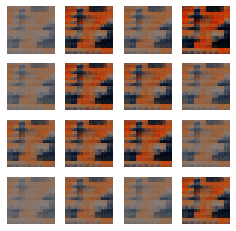

Epoch 210, Discriminator: Loss: 0.18519742041826248 Accuracy: 0.96875, Generator Loss: 4.735565185546875, Time: 77.82910895347595
Epoch 220, Discriminator: Loss: 0.24732055515050888 Accuracy: 0.962890625, Generator Loss: 5.270586013793945, Time: 81.23208522796631
Epoch 230, Discriminator: Loss: 0.17288141697645187 Accuracy: 0.982421875, Generator Loss: 3.2506885528564453, Time: 84.63456130027771
Epoch 240, Discriminator: Loss: 0.19985201209783554 Accuracy: 0.9765625, Generator Loss: 3.756068706512451, Time: 88.04694604873657
Epoch 250, Discriminator: Loss: 0.2318081259727478 Accuracy: 0.978515625, Generator Loss: 4.477246284484863, Time: 91.47222638130188
Epoch 260, Discriminator: Loss: 0.21581025421619415 Accuracy: 0.984375, Generator Loss: 4.003089904785156, Time: 94.8801167011261
Epoch 270, Discriminator: Loss: 0.13066577166318893 Accuracy: 0.98046875, Generator Loss: 4.610740661621094, Time: 98.29912495613098
Epoch 280, Discriminator: Loss: 0.12455332279205322 Accuracy: 0.98046875,

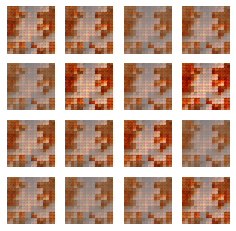

Epoch 310, Discriminator: Loss: 0.052011046558618546 Accuracy: 0.990234375, Generator Loss: 4.450675010681152, Time: 112.68004131317139
Epoch 320, Discriminator: Loss: 0.251010631211102 Accuracy: 0.955078125, Generator Loss: 4.400970458984375, Time: 116.09296441078186
Epoch 330, Discriminator: Loss: 0.1721765324473381 Accuracy: 0.97265625, Generator Loss: 4.394906044006348, Time: 119.50281000137329
Epoch 340, Discriminator: Loss: 0.059760063886642456 Accuracy: 0.994140625, Generator Loss: 4.455366611480713, Time: 122.91310691833496
Epoch 350, Discriminator: Loss: 0.09126705676317215 Accuracy: 0.990234375, Generator Loss: 4.77745246887207, Time: 126.34506106376648
Epoch 360, Discriminator: Loss: 0.20317451655864716 Accuracy: 0.97265625, Generator Loss: 5.257074356079102, Time: 129.79386925697327
Epoch 370, Discriminator: Loss: 0.10335145890712738 Accuracy: 0.9921875, Generator Loss: 4.526660442352295, Time: 133.2126109600067
Epoch 380, Discriminator: Loss: 0.11604705080389977 Accuracy: 

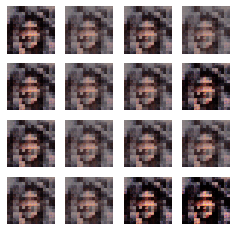

Epoch 410, Discriminator: Loss: 0.23773293942213058 Accuracy: 0.9765625, Generator Loss: 3.5324270725250244, Time: 147.64882922172546
Epoch 420, Discriminator: Loss: 0.3418016880750656 Accuracy: 0.9453125, Generator Loss: 4.419670581817627, Time: 151.07818746566772
Epoch 430, Discriminator: Loss: 0.252005971968174 Accuracy: 0.9609375, Generator Loss: 4.332856178283691, Time: 154.49414682388306
Epoch 440, Discriminator: Loss: 0.11230426467955112 Accuracy: 0.978515625, Generator Loss: 4.778680801391602, Time: 157.91237998008728
Epoch 450, Discriminator: Loss: 0.15082266181707382 Accuracy: 0.978515625, Generator Loss: 6.612905025482178, Time: 161.33947157859802
Epoch 460, Discriminator: Loss: 0.10319588705897331 Accuracy: 0.990234375, Generator Loss: 4.7389235496521, Time: 164.76235342025757
Epoch 470, Discriminator: Loss: 0.1424068734049797 Accuracy: 0.986328125, Generator Loss: 4.2977705001831055, Time: 168.18195867538452
Epoch 480, Discriminator: Loss: 0.07106713950634003 Accuracy: 0.9

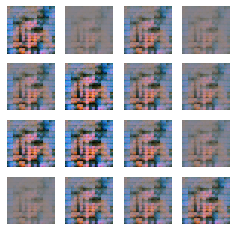

Epoch 510, Discriminator: Loss: 0.12974352797027677 Accuracy: 0.970703125, Generator Loss: 6.946666717529297, Time: 182.58833074569702
Epoch 520, Discriminator: Loss: 0.06959566101431847 Accuracy: 0.99609375, Generator Loss: 4.45062780380249, Time: 186.01700973510742
Epoch 530, Discriminator: Loss: 0.06739449314773083 Accuracy: 0.99609375, Generator Loss: 4.493801116943359, Time: 189.43994665145874
Epoch 540, Discriminator: Loss: 0.09639392793178558 Accuracy: 0.984375, Generator Loss: 4.653696537017822, Time: 192.8535933494568
Epoch 550, Discriminator: Loss: 0.05091232806444168 Accuracy: 0.994140625, Generator Loss: 5.282364845275879, Time: 196.27782702445984
Epoch 560, Discriminator: Loss: 0.07296082563698292 Accuracy: 0.994140625, Generator Loss: 5.409738540649414, Time: 199.92936539649963
Epoch 570, Discriminator: Loss: 0.04612790793180466 Accuracy: 0.994140625, Generator Loss: 5.676332473754883, Time: 203.3608431816101
Epoch 580, Discriminator: Loss: 0.02124800276942551 Accuracy: 0

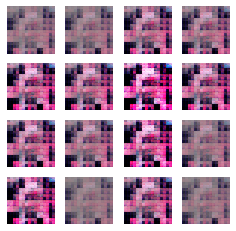

Epoch 610, Discriminator: Loss: 0.04301447403850034 Accuracy: 0.994140625, Generator Loss: 8.474006652832031, Time: 217.77036929130554
Epoch 620, Discriminator: Loss: 0.25616133864969015 Accuracy: 0.955078125, Generator Loss: 7.174105167388916, Time: 221.18290090560913
Epoch 630, Discriminator: Loss: 0.22966299951076508 Accuracy: 0.96484375, Generator Loss: 4.877086639404297, Time: 224.59920239448547
Epoch 640, Discriminator: Loss: 0.41051332745701075 Accuracy: 0.93359375, Generator Loss: 4.968469142913818, Time: 228.0153489112854
Epoch 650, Discriminator: Loss: 0.11151740700006485 Accuracy: 0.98046875, Generator Loss: 4.714218616485596, Time: 231.43159008026123
Epoch 660, Discriminator: Loss: 0.12393616884946823 Accuracy: 0.98828125, Generator Loss: 5.016650199890137, Time: 234.8403594493866
Epoch 670, Discriminator: Loss: 0.1063750833272934 Accuracy: 0.9921875, Generator Loss: 6.624712944030762, Time: 238.25536489486694
Epoch 680, Discriminator: Loss: 0.06853679567575455 Accuracy: 0.

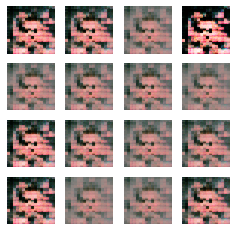

Epoch 710, Discriminator: Loss: 0.17168737202882767 Accuracy: 0.994140625, Generator Loss: 3.828533172607422, Time: 252.68141341209412
Epoch 720, Discriminator: Loss: 0.1857873573899269 Accuracy: 0.986328125, Generator Loss: 3.538008689880371, Time: 256.11410427093506
Epoch 730, Discriminator: Loss: 0.4382052421569824 Accuracy: 0.939453125, Generator Loss: 2.651219606399536, Time: 259.5464222431183
Epoch 740, Discriminator: Loss: 0.3881991356611252 Accuracy: 0.9609375, Generator Loss: 2.3839197158813477, Time: 262.995707988739
Epoch 750, Discriminator: Loss: 0.22912229597568512 Accuracy: 0.978515625, Generator Loss: 2.746957778930664, Time: 266.4433844089508
Epoch 760, Discriminator: Loss: 0.20132581144571304 Accuracy: 0.978515625, Generator Loss: 2.8598344326019287, Time: 269.8891324996948
Epoch 770, Discriminator: Loss: 0.17933356761932373 Accuracy: 0.984375, Generator Loss: 3.0019519329071045, Time: 273.3051931858063
Epoch 780, Discriminator: Loss: 0.17742954939603806 Accuracy: 0.98

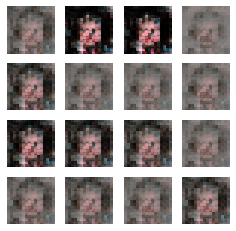

Epoch 810, Discriminator: Loss: 0.12145227938890457 Accuracy: 0.984375, Generator Loss: 4.078266143798828, Time: 287.7108383178711
Epoch 820, Discriminator: Loss: 0.17033540457487106 Accuracy: 0.9765625, Generator Loss: 4.278928279876709, Time: 291.13548469543457
Epoch 830, Discriminator: Loss: 0.17328865826129913 Accuracy: 0.978515625, Generator Loss: 4.040387153625488, Time: 294.5560097694397
Epoch 840, Discriminator: Loss: 0.6482170820236206 Accuracy: 0.87890625, Generator Loss: 3.3202996253967285, Time: 297.9800498485565
Epoch 850, Discriminator: Loss: 0.1458110511302948 Accuracy: 0.97265625, Generator Loss: 4.268185615539551, Time: 301.40199065208435
Epoch 860, Discriminator: Loss: 0.21989530324935913 Accuracy: 0.96875, Generator Loss: 4.645150661468506, Time: 304.80568861961365
Epoch 870, Discriminator: Loss: 0.13590899109840393 Accuracy: 0.974609375, Generator Loss: 4.4079155921936035, Time: 308.2137348651886
Epoch 880, Discriminator: Loss: 0.172858364880085 Accuracy: 0.98242187

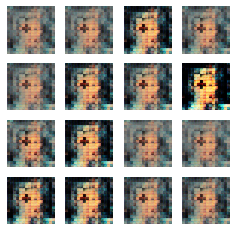

Epoch 910, Discriminator: Loss: 0.09535811841487885 Accuracy: 0.986328125, Generator Loss: 4.911394119262695, Time: 322.84738755226135
Epoch 920, Discriminator: Loss: 0.044886769726872444 Accuracy: 0.994140625, Generator Loss: 5.0004353523254395, Time: 326.26976013183594
Epoch 930, Discriminator: Loss: 0.16118773818016052 Accuracy: 0.982421875, Generator Loss: 5.142375946044922, Time: 329.68188643455505
Epoch 940, Discriminator: Loss: 0.2746613621711731 Accuracy: 0.943359375, Generator Loss: 5.889614105224609, Time: 333.0951497554779
Epoch 950, Discriminator: Loss: 0.7575257103890181 Accuracy: 0.89453125, Generator Loss: 4.995905876159668, Time: 336.5197653770447
Epoch 960, Discriminator: Loss: 0.07874433323740959 Accuracy: 0.990234375, Generator Loss: 4.316542625427246, Time: 339.9360327720642
Epoch 970, Discriminator: Loss: 0.2630789130926132 Accuracy: 0.958984375, Generator Loss: 4.112761497497559, Time: 343.3454341888428
Epoch 980, Discriminator: Loss: 0.11019999161362648 Accuracy:

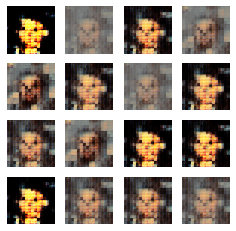

Epoch 1010, Discriminator: Loss: 0.1966734565794468 Accuracy: 0.9765625, Generator Loss: 4.766661167144775, Time: 357.7610182762146
Epoch 1020, Discriminator: Loss: 0.26590412855148315 Accuracy: 0.958984375, Generator Loss: 5.272582054138184, Time: 361.1780741214752
Epoch 1030, Discriminator: Loss: 0.15056228451430798 Accuracy: 0.97265625, Generator Loss: 4.861255645751953, Time: 364.59214901924133
Epoch 1040, Discriminator: Loss: 0.05806676484644413 Accuracy: 0.99609375, Generator Loss: 4.736464977264404, Time: 368.013370513916
Epoch 1050, Discriminator: Loss: 0.14829204976558685 Accuracy: 0.982421875, Generator Loss: 5.6657233238220215, Time: 371.42511463165283
Epoch 1060, Discriminator: Loss: 0.07602002657949924 Accuracy: 0.990234375, Generator Loss: 6.007357597351074, Time: 374.83314323425293
Epoch 1070, Discriminator: Loss: 0.013756349682807922 Accuracy: 0.998046875, Generator Loss: 6.8665852546691895, Time: 378.2375373840332
Epoch 1080, Discriminator: Loss: 0.027230561710894108 A

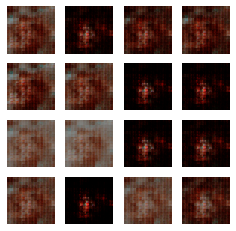

Epoch 1110, Discriminator: Loss: 0.11791989579796791 Accuracy: 0.986328125, Generator Loss: 4.57055139541626, Time: 392.61066699028015
Epoch 1120, Discriminator: Loss: 0.2893659472465515 Accuracy: 0.970703125, Generator Loss: 5.957361698150635, Time: 396.01722383499146
Epoch 1130, Discriminator: Loss: 0.11183682084083557 Accuracy: 0.990234375, Generator Loss: 3.1595492362976074, Time: 399.4108769893646
Epoch 1140, Discriminator: Loss: 0.13016708567738533 Accuracy: 0.98046875, Generator Loss: 3.7748706340789795, Time: 402.8216278553009
Epoch 1150, Discriminator: Loss: 0.19464676827192307 Accuracy: 0.978515625, Generator Loss: 4.3749589920043945, Time: 406.24280643463135
Epoch 1160, Discriminator: Loss: 0.21047745645046234 Accuracy: 0.97265625, Generator Loss: 3.6847662925720215, Time: 409.6539170742035
Epoch 1170, Discriminator: Loss: 0.17312046885490417 Accuracy: 0.9765625, Generator Loss: 3.6754684448242188, Time: 413.07073044776917
Epoch 1180, Discriminator: Loss: 0.15788908302783966

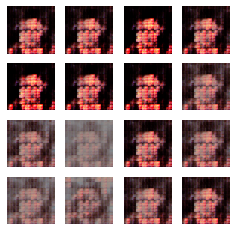

Epoch 1210, Discriminator: Loss: 0.10046497732400894 Accuracy: 0.9921875, Generator Loss: 4.53316593170166, Time: 427.742555141449
Epoch 1220, Discriminator: Loss: 0.08238597214221954 Accuracy: 0.9921875, Generator Loss: 4.778611183166504, Time: 431.1575677394867
Epoch 1230, Discriminator: Loss: 0.12891783192753792 Accuracy: 0.98046875, Generator Loss: 4.800177574157715, Time: 434.61354327201843
Epoch 1240, Discriminator: Loss: 0.09311247244477272 Accuracy: 0.98828125, Generator Loss: 5.505086898803711, Time: 438.0539629459381
Epoch 1250, Discriminator: Loss: 0.09831911325454712 Accuracy: 0.986328125, Generator Loss: 4.672382354736328, Time: 441.4919092655182
Epoch 1260, Discriminator: Loss: 0.2113240584731102 Accuracy: 0.97265625, Generator Loss: 4.945759296417236, Time: 444.9052324295044
Epoch 1270, Discriminator: Loss: 0.18319425731897354 Accuracy: 0.96875, Generator Loss: 4.944004535675049, Time: 448.3286852836609
Epoch 1280, Discriminator: Loss: 0.5238575339317322 Accuracy: 0.9179

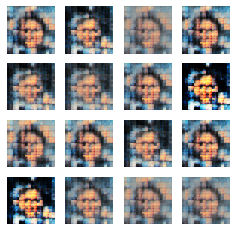

Epoch 1310, Discriminator: Loss: 0.055795714259147644 Accuracy: 0.9921875, Generator Loss: 4.2040696144104, Time: 462.69853687286377
Epoch 1320, Discriminator: Loss: 0.0897693820297718 Accuracy: 0.98828125, Generator Loss: 4.289587020874023, Time: 466.12009286880493
Epoch 1330, Discriminator: Loss: 0.1113457940518856 Accuracy: 0.982421875, Generator Loss: 5.082804203033447, Time: 469.540602684021
Epoch 1340, Discriminator: Loss: 0.14120573177933693 Accuracy: 0.982421875, Generator Loss: 4.889033317565918, Time: 472.96168541908264
Epoch 1350, Discriminator: Loss: 0.1463274322450161 Accuracy: 0.984375, Generator Loss: 5.057271480560303, Time: 476.3993856906891
Epoch 1360, Discriminator: Loss: 0.04218036448583007 Accuracy: 0.9921875, Generator Loss: 6.050412178039551, Time: 479.82451844215393
Epoch 1370, Discriminator: Loss: 0.1202787272632122 Accuracy: 0.990234375, Generator Loss: 4.894551753997803, Time: 483.247376203537
Epoch 1380, Discriminator: Loss: 0.03304378129541874 Accuracy: 0.9

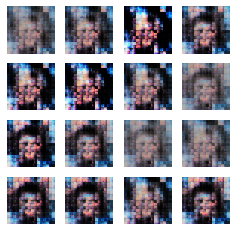

Epoch 1410, Discriminator: Loss: 0.18908263742923737 Accuracy: 0.982421875, Generator Loss: 4.651417255401611, Time: 497.6724112033844
Epoch 1420, Discriminator: Loss: 0.4001474790275097 Accuracy: 0.947265625, Generator Loss: 4.638733863830566, Time: 501.09120869636536
Epoch 1430, Discriminator: Loss: 0.14987634494900703 Accuracy: 0.98828125, Generator Loss: 4.955002307891846, Time: 504.515748500824
Epoch 1440, Discriminator: Loss: 0.1846486944705248 Accuracy: 0.966796875, Generator Loss: 4.681058883666992, Time: 507.92260336875916
Epoch 1450, Discriminator: Loss: 0.15242163091897964 Accuracy: 0.982421875, Generator Loss: 4.900986194610596, Time: 511.33588910102844
Epoch 1460, Discriminator: Loss: 0.08487072959542274 Accuracy: 0.986328125, Generator Loss: 5.23842716217041, Time: 514.7427270412445
Epoch 1470, Discriminator: Loss: 0.08579776994884014 Accuracy: 0.98046875, Generator Loss: 5.873301029205322, Time: 518.1714611053467
Epoch 1480, Discriminator: Loss: 0.12611448764801025 Accur

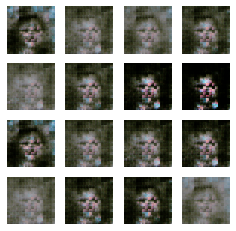

Epoch 1510, Discriminator: Loss: 0.08632115554064512 Accuracy: 0.986328125, Generator Loss: 5.982768535614014, Time: 532.8568835258484
Epoch 1520, Discriminator: Loss: 3.509233236312866 Accuracy: 0.705078125, Generator Loss: 3.8137643337249756, Time: 536.285728931427
Epoch 1530, Discriminator: Loss: 0.04409256763756275 Accuracy: 0.998046875, Generator Loss: 4.694657325744629, Time: 539.6973731517792
Epoch 1540, Discriminator: Loss: 0.030906413681805134 Accuracy: 0.994140625, Generator Loss: 4.813828468322754, Time: 543.129711151123
Epoch 1550, Discriminator: Loss: 0.01666547660715878 Accuracy: 1.0, Generator Loss: 4.7109246253967285, Time: 546.5651350021362
Epoch 1560, Discriminator: Loss: 0.027743693441152573 Accuracy: 0.998046875, Generator Loss: 4.838224411010742, Time: 549.9878702163696
Epoch 1570, Discriminator: Loss: 0.07266829535365105 Accuracy: 0.99609375, Generator Loss: 5.019810676574707, Time: 553.400824546814
Epoch 1580, Discriminator: Loss: 0.49255892634391785 Accuracy: 0.

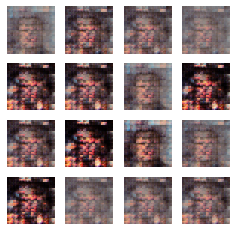

Epoch 1610, Discriminator: Loss: 0.15077751874923706 Accuracy: 0.974609375, Generator Loss: 3.890225887298584, Time: 567.7982556819916
Epoch 1620, Discriminator: Loss: 0.17868857830762863 Accuracy: 0.9765625, Generator Loss: 3.832712411880493, Time: 571.2231369018555
Epoch 1630, Discriminator: Loss: 0.06636601686477661 Accuracy: 0.994140625, Generator Loss: 4.247507572174072, Time: 574.6799688339233
Epoch 1640, Discriminator: Loss: 0.1205146573483944 Accuracy: 0.9765625, Generator Loss: 4.935984134674072, Time: 578.1191618442535
Epoch 1650, Discriminator: Loss: 0.18311578780412674 Accuracy: 0.974609375, Generator Loss: 5.929346084594727, Time: 581.5467250347137
Epoch 1660, Discriminator: Loss: 0.10428407043218613 Accuracy: 0.98828125, Generator Loss: 4.420910835266113, Time: 584.9633922576904
Epoch 1670, Discriminator: Loss: 0.16857265681028366 Accuracy: 0.978515625, Generator Loss: 4.517298221588135, Time: 588.3836538791656
Epoch 1680, Discriminator: Loss: 0.16290800273418427 Accuracy

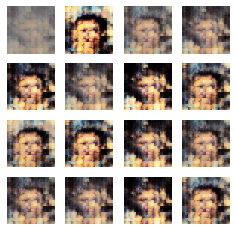

Epoch 1710, Discriminator: Loss: 0.09908421710133553 Accuracy: 0.994140625, Generator Loss: 4.0325822830200195, Time: 602.8244135379791
Epoch 1720, Discriminator: Loss: 0.1544867753982544 Accuracy: 0.97265625, Generator Loss: 4.040930271148682, Time: 606.254421710968
Epoch 1730, Discriminator: Loss: 0.13482049107551575 Accuracy: 0.98046875, Generator Loss: 5.331846237182617, Time: 609.6823048591614
Epoch 1740, Discriminator: Loss: 0.09111063554883003 Accuracy: 0.984375, Generator Loss: 4.721647262573242, Time: 613.0877590179443
Epoch 1750, Discriminator: Loss: 0.1432926207780838 Accuracy: 0.978515625, Generator Loss: 4.769102096557617, Time: 616.5106105804443
Epoch 1760, Discriminator: Loss: 0.12158545106649399 Accuracy: 0.984375, Generator Loss: 4.7598876953125, Time: 619.9258894920349
Epoch 1770, Discriminator: Loss: 0.10146359354257584 Accuracy: 0.98828125, Generator Loss: 4.905683517456055, Time: 623.3679351806641
Epoch 1780, Discriminator: Loss: 0.03505008481442928 Accuracy: 0.994

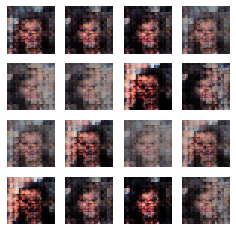

Epoch 1810, Discriminator: Loss: 0.175303403288126 Accuracy: 0.974609375, Generator Loss: 3.843611717224121, Time: 637.8135652542114
Epoch 1820, Discriminator: Loss: 0.2173447534441948 Accuracy: 0.96875, Generator Loss: 4.307660102844238, Time: 641.5128202438354
Epoch 1830, Discriminator: Loss: 0.14394516497850418 Accuracy: 0.98046875, Generator Loss: 4.232085704803467, Time: 644.9359169006348
Epoch 1840, Discriminator: Loss: 0.0972202867269516 Accuracy: 0.990234375, Generator Loss: 4.208217620849609, Time: 648.356348991394
Epoch 1850, Discriminator: Loss: 0.11242841929197311 Accuracy: 0.986328125, Generator Loss: 4.272976875305176, Time: 651.803261756897
Epoch 1860, Discriminator: Loss: 0.09529060125350952 Accuracy: 0.990234375, Generator Loss: 4.795712947845459, Time: 655.2330195903778
Epoch 1870, Discriminator: Loss: 0.14657675474882126 Accuracy: 0.98046875, Generator Loss: 5.214713096618652, Time: 658.6724050045013
Epoch 1880, Discriminator: Loss: 0.3698224499821663 Accuracy: 0.941

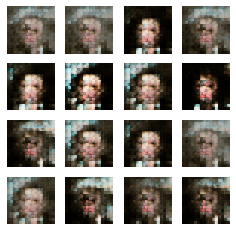

Epoch 1910, Discriminator: Loss: 0.21479790657758713 Accuracy: 0.96875, Generator Loss: 4.392024517059326, Time: 673.0941970348358
Epoch 1920, Discriminator: Loss: 0.16281885653734207 Accuracy: 0.978515625, Generator Loss: 4.079477787017822, Time: 676.5176613330841
Epoch 1930, Discriminator: Loss: 0.1978512555360794 Accuracy: 0.970703125, Generator Loss: 4.607692718505859, Time: 679.9542527198792
Epoch 1940, Discriminator: Loss: 0.11029311642050743 Accuracy: 0.984375, Generator Loss: 4.80582332611084, Time: 683.3695886135101
Epoch 1950, Discriminator: Loss: 0.21911933994852006 Accuracy: 0.9609375, Generator Loss: 6.469034671783447, Time: 686.7828905582428
Epoch 1960, Discriminator: Loss: 0.13711706176400185 Accuracy: 0.96875, Generator Loss: 4.8519110679626465, Time: 690.2028503417969
Epoch 1970, Discriminator: Loss: 0.09279706701636314 Accuracy: 0.990234375, Generator Loss: 4.464184761047363, Time: 693.6250367164612
Epoch 1980, Discriminator: Loss: 1.0110730901360512 Accuracy: 0.82617

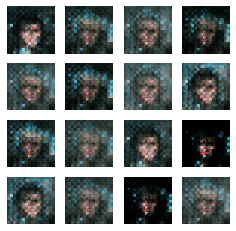

Epoch 2010, Discriminator: Loss: 0.04430838115513325 Accuracy: 0.99609375, Generator Loss: 4.641846656799316, Time: 708.0523734092712
Epoch 2020, Discriminator: Loss: 0.361526183784008 Accuracy: 0.95703125, Generator Loss: 5.290616035461426, Time: 711.4808232784271
Epoch 2030, Discriminator: Loss: 0.08807848766446114 Accuracy: 0.990234375, Generator Loss: 4.404470920562744, Time: 714.9153847694397
Epoch 2040, Discriminator: Loss: 0.12889688834547997 Accuracy: 0.98828125, Generator Loss: 4.686960220336914, Time: 718.350811958313
Epoch 2050, Discriminator: Loss: 0.11418167687952518 Accuracy: 0.986328125, Generator Loss: 7.4360504150390625, Time: 721.7808203697205
Epoch 2060, Discriminator: Loss: 0.1307508572936058 Accuracy: 0.986328125, Generator Loss: 4.516434192657471, Time: 725.1961088180542
Epoch 2070, Discriminator: Loss: 0.1337333545088768 Accuracy: 0.990234375, Generator Loss: 4.177964687347412, Time: 728.6246538162231
Epoch 2080, Discriminator: Loss: 0.1090402603149414 Accuracy: 

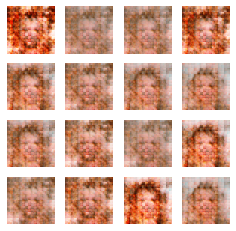

Epoch 2110, Discriminator: Loss: 0.05018167104572058 Accuracy: 0.994140625, Generator Loss: 5.168219566345215, Time: 743.1420147418976
Epoch 2120, Discriminator: Loss: 0.07677678018808365 Accuracy: 0.99609375, Generator Loss: 7.965351104736328, Time: 746.565238237381
Epoch 2130, Discriminator: Loss: 0.1760744471102953 Accuracy: 0.97265625, Generator Loss: 4.280657768249512, Time: 750.004399061203
Epoch 2140, Discriminator: Loss: 0.30414994060993195 Accuracy: 0.94921875, Generator Loss: 3.485826015472412, Time: 753.4389193058014
Epoch 2150, Discriminator: Loss: 0.17309017479419708 Accuracy: 0.986328125, Generator Loss: 3.7664175033569336, Time: 756.8722984790802
Epoch 2160, Discriminator: Loss: 0.2755201905965805 Accuracy: 0.96484375, Generator Loss: 4.046735763549805, Time: 760.5534203052521
Epoch 2170, Discriminator: Loss: 0.3446862492710352 Accuracy: 0.935546875, Generator Loss: 3.887343168258667, Time: 763.9837682247162
Epoch 2180, Discriminator: Loss: 0.16783760860562325 Accuracy: 

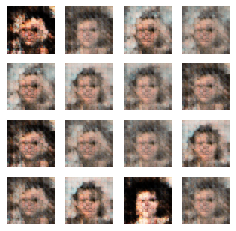

Epoch 2210, Discriminator: Loss: 0.17586736381053925 Accuracy: 0.97265625, Generator Loss: 4.487594127655029, Time: 778.4838395118713
Epoch 2220, Discriminator: Loss: 0.2894027978181839 Accuracy: 0.951171875, Generator Loss: 5.461307048797607, Time: 781.9159157276154
Epoch 2230, Discriminator: Loss: 0.25532907992601395 Accuracy: 0.955078125, Generator Loss: 4.446514129638672, Time: 785.3369524478912
Epoch 2240, Discriminator: Loss: 0.13481371849775314 Accuracy: 0.982421875, Generator Loss: 4.1873345375061035, Time: 788.7750446796417
Epoch 2250, Discriminator: Loss: 0.07596051879227161 Accuracy: 0.9921875, Generator Loss: 4.953843116760254, Time: 792.204922914505
Epoch 2260, Discriminator: Loss: 0.11923258565366268 Accuracy: 0.990234375, Generator Loss: 5.773420333862305, Time: 795.6291739940643
Epoch 2270, Discriminator: Loss: 0.2649366185069084 Accuracy: 0.970703125, Generator Loss: 6.083561420440674, Time: 799.0604996681213
Epoch 2280, Discriminator: Loss: 0.18496184796094894 Accurac

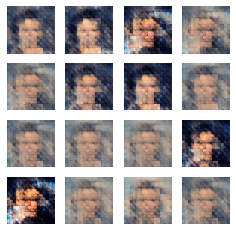

Epoch 2310, Discriminator: Loss: 0.10840102657675743 Accuracy: 0.98046875, Generator Loss: 4.559946060180664, Time: 813.473019361496
Epoch 2320, Discriminator: Loss: 0.05555093102157116 Accuracy: 0.998046875, Generator Loss: 4.825384140014648, Time: 816.8811085224152
Epoch 2330, Discriminator: Loss: 0.06147961877286434 Accuracy: 0.990234375, Generator Loss: 4.4749836921691895, Time: 820.2941915988922
Epoch 2340, Discriminator: Loss: 0.06975380331277847 Accuracy: 0.990234375, Generator Loss: 4.6731109619140625, Time: 823.7009422779083
Epoch 2350, Discriminator: Loss: 0.07764667458832264 Accuracy: 0.984375, Generator Loss: 5.337771892547607, Time: 827.1073977947235
Epoch 2360, Discriminator: Loss: 0.03226852789521217 Accuracy: 0.99609375, Generator Loss: 5.438625335693359, Time: 830.4912633895874
Epoch 2370, Discriminator: Loss: 0.2091310415416956 Accuracy: 0.955078125, Generator Loss: 6.394587993621826, Time: 833.9042119979858
Epoch 2380, Discriminator: Loss: 0.12180502340197563 Accurac

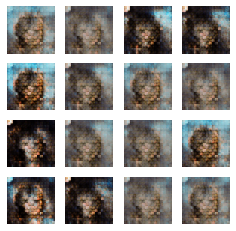

Epoch 2410, Discriminator: Loss: 0.2046070471405983 Accuracy: 0.9609375, Generator Loss: 4.670454502105713, Time: 848.2133975028992
Epoch 2420, Discriminator: Loss: 0.20614778250455856 Accuracy: 0.974609375, Generator Loss: 3.9433751106262207, Time: 851.6002535820007
Epoch 2430, Discriminator: Loss: 0.23934004455804825 Accuracy: 0.95703125, Generator Loss: 3.489910840988159, Time: 854.998025894165
Epoch 2440, Discriminator: Loss: 0.09498704969882965 Accuracy: 0.984375, Generator Loss: 3.980919122695923, Time: 858.3914849758148
Epoch 2450, Discriminator: Loss: 0.07453563809394836 Accuracy: 0.990234375, Generator Loss: 4.272165298461914, Time: 861.7824013233185
Epoch 2460, Discriminator: Loss: 0.07281340286135674 Accuracy: 0.98828125, Generator Loss: 4.419004440307617, Time: 865.1889505386353
Epoch 2470, Discriminator: Loss: 0.10370074212551117 Accuracy: 0.984375, Generator Loss: 4.480118751525879, Time: 868.5933451652527
Epoch 2480, Discriminator: Loss: 0.24254468828439713 Accuracy: 0.9

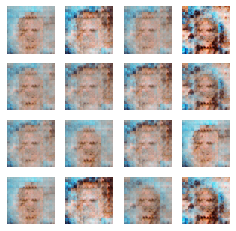

Epoch 2510, Discriminator: Loss: 0.16060078144073486 Accuracy: 0.978515625, Generator Loss: 6.587233543395996, Time: 883.1838662624359
Epoch 2520, Discriminator: Loss: 0.1282615289092064 Accuracy: 0.982421875, Generator Loss: 6.154580593109131, Time: 886.625303030014
Epoch 2530, Discriminator: Loss: 0.17476199567317963 Accuracy: 0.966796875, Generator Loss: 6.726126194000244, Time: 890.0678372383118
Epoch 2540, Discriminator: Loss: 0.10061560571193695 Accuracy: 0.982421875, Generator Loss: 7.084488391876221, Time: 893.4880616664886
Epoch 2550, Discriminator: Loss: 0.11196703277528286 Accuracy: 0.974609375, Generator Loss: 7.195642948150635, Time: 896.8954982757568
Epoch 2560, Discriminator: Loss: 0.11217333376407623 Accuracy: 0.98828125, Generator Loss: 6.857822895050049, Time: 900.2830784320831
Epoch 2570, Discriminator: Loss: 0.08633843995630741 Accuracy: 0.98828125, Generator Loss: 5.378686904907227, Time: 903.6940603256226
Epoch 2580, Discriminator: Loss: 0.061420753598213196 Accur

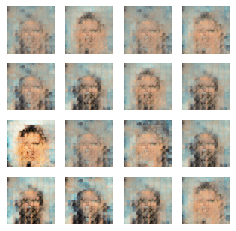

Epoch 2610, Discriminator: Loss: 0.09714581817388535 Accuracy: 0.984375, Generator Loss: 4.363123416900635, Time: 918.0608832836151
Epoch 2620, Discriminator: Loss: 0.29598443512804806 Accuracy: 0.943359375, Generator Loss: 5.667155742645264, Time: 921.4678771495819
Epoch 2630, Discriminator: Loss: 0.02650782186537981 Accuracy: 0.998046875, Generator Loss: 5.33824348449707, Time: 924.868058681488
Epoch 2640, Discriminator: Loss: 0.20955601707100868 Accuracy: 0.97265625, Generator Loss: 4.155124187469482, Time: 928.263130903244
Epoch 2650, Discriminator: Loss: 0.12191175669431686 Accuracy: 0.982421875, Generator Loss: 5.752899646759033, Time: 931.6657316684723
Epoch 2660, Discriminator: Loss: 0.05548311583697796 Accuracy: 0.990234375, Generator Loss: 5.167490005493164, Time: 935.0706412792206
Epoch 2670, Discriminator: Loss: 0.47621765406802297 Accuracy: 0.908203125, Generator Loss: 4.351653099060059, Time: 938.4781773090363
Epoch 2680, Discriminator: Loss: 0.1053135134279728 Accuracy: 

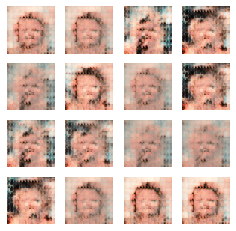

Epoch 2710, Discriminator: Loss: 0.08072315528988838 Accuracy: 0.990234375, Generator Loss: 4.335545063018799, Time: 952.8107957839966
Epoch 2720, Discriminator: Loss: 0.13991958647966385 Accuracy: 0.986328125, Generator Loss: 6.18597936630249, Time: 956.2074310779572
Epoch 2730, Discriminator: Loss: 0.24968942790292203 Accuracy: 0.953125, Generator Loss: 6.349788665771484, Time: 959.6074633598328
Epoch 2740, Discriminator: Loss: 0.14198706299066544 Accuracy: 0.97265625, Generator Loss: 5.489008903503418, Time: 963.0017611980438
Epoch 2750, Discriminator: Loss: 0.10975952912122011 Accuracy: 0.982421875, Generator Loss: 5.8517537117004395, Time: 966.3874382972717
Epoch 2760, Discriminator: Loss: 0.10297508910298347 Accuracy: 0.98828125, Generator Loss: 7.738052845001221, Time: 969.7715218067169
Epoch 2770, Discriminator: Loss: 0.42172129545360804 Accuracy: 0.93359375, Generator Loss: 4.219165802001953, Time: 973.1795878410339
Epoch 2780, Discriminator: Loss: 0.09166901558637619 Accuracy

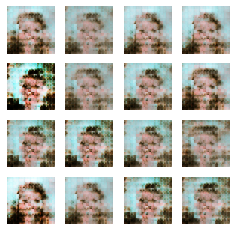

Epoch 2810, Discriminator: Loss: 0.15436730533838272 Accuracy: 0.98046875, Generator Loss: 4.732348442077637, Time: 987.7431585788727
Epoch 2820, Discriminator: Loss: 0.04554952681064606 Accuracy: 0.998046875, Generator Loss: 4.24932336807251, Time: 991.1458702087402
Epoch 2830, Discriminator: Loss: 0.038505977019667625 Accuracy: 0.99609375, Generator Loss: 4.432724952697754, Time: 994.563001871109
Epoch 2840, Discriminator: Loss: 0.24999936670064926 Accuracy: 0.970703125, Generator Loss: 4.616462707519531, Time: 997.971312046051
Epoch 2850, Discriminator: Loss: 0.15139083564281464 Accuracy: 0.974609375, Generator Loss: 4.248437881469727, Time: 1001.3793261051178
Epoch 2860, Discriminator: Loss: 0.09059195220470428 Accuracy: 0.986328125, Generator Loss: 4.499037265777588, Time: 1004.7820477485657
Epoch 2870, Discriminator: Loss: 0.10648871958255768 Accuracy: 0.98046875, Generator Loss: 4.260588645935059, Time: 1008.1910948753357
Epoch 2880, Discriminator: Loss: 0.11005987972021103 Accu

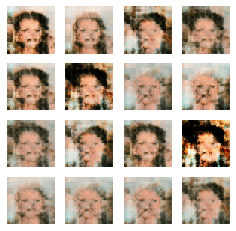

Epoch 2910, Discriminator: Loss: 0.09775925800204277 Accuracy: 0.986328125, Generator Loss: 4.508765697479248, Time: 1022.512469291687
Epoch 2920, Discriminator: Loss: 0.15211324393749237 Accuracy: 0.9765625, Generator Loss: 5.484617233276367, Time: 1025.9152195453644
Epoch 2930, Discriminator: Loss: 0.16913606226444244 Accuracy: 0.974609375, Generator Loss: 5.309398651123047, Time: 1029.3156967163086
Epoch 2940, Discriminator: Loss: 0.09677852317690849 Accuracy: 0.98828125, Generator Loss: 4.8624114990234375, Time: 1032.7060098648071
Epoch 2950, Discriminator: Loss: 0.09281623363494873 Accuracy: 0.990234375, Generator Loss: 5.115691184997559, Time: 1036.0918786525726
Epoch 2960, Discriminator: Loss: 0.18242895603179932 Accuracy: 0.96484375, Generator Loss: 7.783544063568115, Time: 1039.4606022834778
Epoch 2970, Discriminator: Loss: 0.47355872578918934 Accuracy: 0.939453125, Generator Loss: 8.244479179382324, Time: 1042.8573088645935
Epoch 2980, Discriminator: Loss: 0.0550596434623003 

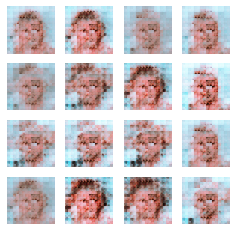

Epoch 3010, Discriminator: Loss: 0.13234921917319298 Accuracy: 0.982421875, Generator Loss: 5.495692253112793, Time: 1057.1633958816528
Epoch 3020, Discriminator: Loss: 0.20215342193841934 Accuracy: 0.97265625, Generator Loss: 6.724833965301514, Time: 1060.5424239635468
Epoch 3030, Discriminator: Loss: 0.19193480536341667 Accuracy: 0.958984375, Generator Loss: 4.045386791229248, Time: 1063.921476840973
Epoch 3040, Discriminator: Loss: 0.11047066003084183 Accuracy: 0.98828125, Generator Loss: 4.446660995483398, Time: 1067.30672955513
Epoch 3050, Discriminator: Loss: 0.0899985209107399 Accuracy: 0.9921875, Generator Loss: 4.487072944641113, Time: 1070.6873514652252
Epoch 3060, Discriminator: Loss: 0.1254083476960659 Accuracy: 0.986328125, Generator Loss: 4.879760265350342, Time: 1074.0882675647736
Epoch 3070, Discriminator: Loss: 0.09652035310864449 Accuracy: 0.9921875, Generator Loss: 4.944393634796143, Time: 1077.4954977035522
Epoch 3080, Discriminator: Loss: 0.09151919931173325 Accura

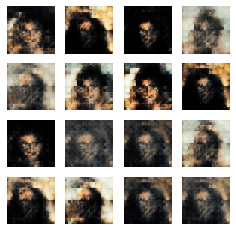

Epoch 3110, Discriminator: Loss: 0.08429301157593727 Accuracy: 0.9921875, Generator Loss: 4.904929161071777, Time: 1092.0300600528717
Epoch 3120, Discriminator: Loss: 0.058049289509654045 Accuracy: 0.990234375, Generator Loss: 5.435110092163086, Time: 1095.4107842445374
Epoch 3130, Discriminator: Loss: 0.12067187950015068 Accuracy: 0.986328125, Generator Loss: 6.336066722869873, Time: 1098.7918248176575
Epoch 3140, Discriminator: Loss: 0.19060847908258438 Accuracy: 0.974609375, Generator Loss: 7.0980987548828125, Time: 1102.1662406921387
Epoch 3150, Discriminator: Loss: 1.4344764053821564 Accuracy: 0.765625, Generator Loss: 5.094022750854492, Time: 1105.5621564388275
Epoch 3160, Discriminator: Loss: 0.27902497351169586 Accuracy: 0.958984375, Generator Loss: 3.4325406551361084, Time: 1108.9360010623932
Epoch 3170, Discriminator: Loss: 0.3297797292470932 Accuracy: 0.94921875, Generator Loss: 3.5625784397125244, Time: 1112.3233869075775
Epoch 3180, Discriminator: Loss: 0.2653072774410248 

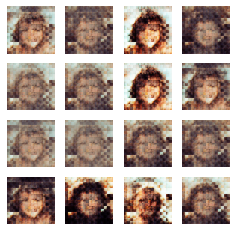

Epoch 3210, Discriminator: Loss: 0.18620174378156662 Accuracy: 0.97265625, Generator Loss: 3.9289822578430176, Time: 1126.5659575462341
Epoch 3220, Discriminator: Loss: 0.40317296981811523 Accuracy: 0.9296875, Generator Loss: 4.8001017570495605, Time: 1129.9580805301666
Epoch 3230, Discriminator: Loss: 0.2363143116235733 Accuracy: 0.95703125, Generator Loss: 4.999139308929443, Time: 1133.32754778862
Epoch 3240, Discriminator: Loss: 0.2158254198729992 Accuracy: 0.96484375, Generator Loss: 4.20880126953125, Time: 1136.6935336589813
Epoch 3250, Discriminator: Loss: 0.08007072098553181 Accuracy: 0.990234375, Generator Loss: 4.86929988861084, Time: 1140.0556907653809
Epoch 3260, Discriminator: Loss: 0.6202808022499084 Accuracy: 0.873046875, Generator Loss: 4.4732842445373535, Time: 1143.4264891147614
Epoch 3270, Discriminator: Loss: 0.14118684269487858 Accuracy: 0.978515625, Generator Loss: 4.283105373382568, Time: 1146.802452802658
Epoch 3280, Discriminator: Loss: 0.2749807760119438 Accura

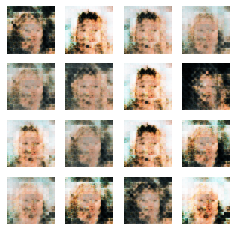

Epoch 3310, Discriminator: Loss: 0.07477248460054398 Accuracy: 0.9921875, Generator Loss: 4.847647666931152, Time: 1160.9741377830505
Epoch 3320, Discriminator: Loss: 0.09822280704975128 Accuracy: 0.986328125, Generator Loss: 5.063579559326172, Time: 1164.3580565452576
Epoch 3330, Discriminator: Loss: 0.10675879940390587 Accuracy: 0.984375, Generator Loss: 4.937920570373535, Time: 1167.7318964004517
Epoch 3340, Discriminator: Loss: 0.15458116680383682 Accuracy: 0.98046875, Generator Loss: 5.611844062805176, Time: 1171.0921094417572
Epoch 3350, Discriminator: Loss: 0.10182386264204979 Accuracy: 0.98828125, Generator Loss: 5.96425724029541, Time: 1174.457069158554
Epoch 3360, Discriminator: Loss: 0.19152623414993286 Accuracy: 0.96875, Generator Loss: 4.880115985870361, Time: 1177.8204555511475
Epoch 3370, Discriminator: Loss: 0.14838144928216934 Accuracy: 0.982421875, Generator Loss: 6.542835712432861, Time: 1181.1909294128418
Epoch 3380, Discriminator: Loss: 0.06705307308584452 Accuracy

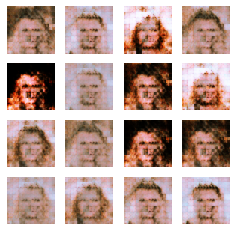

Epoch 3410, Discriminator: Loss: 0.1530037559568882 Accuracy: 0.966796875, Generator Loss: 4.27768087387085, Time: 1195.4309117794037
Epoch 3420, Discriminator: Loss: 0.1369888037443161 Accuracy: 0.982421875, Generator Loss: 5.403137683868408, Time: 1199.1037442684174
Epoch 3430, Discriminator: Loss: 0.20270225778222084 Accuracy: 0.9609375, Generator Loss: 4.999396324157715, Time: 1202.4882259368896
Epoch 3440, Discriminator: Loss: 0.3290286064147949 Accuracy: 0.951171875, Generator Loss: 5.501166820526123, Time: 1205.8730533123016
Epoch 3450, Discriminator: Loss: 0.22949915379285812 Accuracy: 0.974609375, Generator Loss: 4.4581403732299805, Time: 1209.2809302806854
Epoch 3460, Discriminator: Loss: 0.1599385030567646 Accuracy: 0.9765625, Generator Loss: 4.586785793304443, Time: 1212.6763603687286
Epoch 3470, Discriminator: Loss: 0.14379286766052246 Accuracy: 0.98046875, Generator Loss: 4.807538986206055, Time: 1216.0509808063507
Epoch 3480, Discriminator: Loss: 0.09521814808249474 Accu

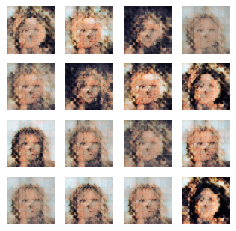

Epoch 3510, Discriminator: Loss: 0.16773613542318344 Accuracy: 0.978515625, Generator Loss: 5.831149101257324, Time: 1230.2425031661987
Epoch 3520, Discriminator: Loss: 0.06439351290464401 Accuracy: 0.99609375, Generator Loss: 5.977540969848633, Time: 1233.6081211566925
Epoch 3530, Discriminator: Loss: 0.1619623303413391 Accuracy: 0.96875, Generator Loss: 7.693361759185791, Time: 1236.9751698970795
Epoch 3540, Discriminator: Loss: 0.1447992529720068 Accuracy: 0.978515625, Generator Loss: 5.010557174682617, Time: 1240.349442243576
Epoch 3550, Discriminator: Loss: 0.03819428477436304 Accuracy: 0.994140625, Generator Loss: 6.099640369415283, Time: 1243.7259991168976
Epoch 3560, Discriminator: Loss: 0.1339215561747551 Accuracy: 0.9765625, Generator Loss: 5.6981682777404785, Time: 1247.09486079216
Epoch 3570, Discriminator: Loss: 0.08963885717093945 Accuracy: 0.9921875, Generator Loss: 5.990018367767334, Time: 1250.4748237133026
Epoch 3580, Discriminator: Loss: 0.9003049544990063 Accuracy: 

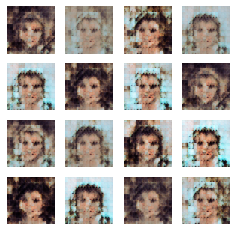

Epoch 3610, Discriminator: Loss: 0.3766217529773712 Accuracy: 0.94140625, Generator Loss: 6.001387119293213, Time: 1264.6890535354614
Epoch 3620, Discriminator: Loss: 0.0991765670478344 Accuracy: 0.986328125, Generator Loss: 4.742074966430664, Time: 1268.0533385276794
Epoch 3630, Discriminator: Loss: 0.45280663669109344 Accuracy: 0.92578125, Generator Loss: 3.986337184906006, Time: 1271.4207952022552
Epoch 3640, Discriminator: Loss: 0.3673902601003647 Accuracy: 0.9296875, Generator Loss: 7.492578506469727, Time: 1274.792194366455
Epoch 3650, Discriminator: Loss: 0.15124738961458206 Accuracy: 0.97265625, Generator Loss: 4.925969123840332, Time: 1278.1604347229004
Epoch 3660, Discriminator: Loss: 0.17546525970101357 Accuracy: 0.96875, Generator Loss: 4.844953536987305, Time: 1281.5308973789215
Epoch 3670, Discriminator: Loss: 0.09535430744290352 Accuracy: 0.98828125, Generator Loss: 4.7144551277160645, Time: 1284.9197764396667
Epoch 3680, Discriminator: Loss: 0.18255654349923134 Accuracy

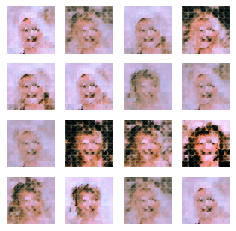

Epoch 3710, Discriminator: Loss: 0.13211167976260185 Accuracy: 0.98046875, Generator Loss: 5.873067855834961, Time: 1299.2525646686554
Epoch 3720, Discriminator: Loss: 0.23274286091327667 Accuracy: 0.96875, Generator Loss: 7.124110221862793, Time: 1302.640347957611
Epoch 3730, Discriminator: Loss: 0.09779225662350655 Accuracy: 0.994140625, Generator Loss: 5.678322792053223, Time: 1306.0324280261993
Epoch 3740, Discriminator: Loss: 0.1251021847128868 Accuracy: 0.984375, Generator Loss: 5.584338188171387, Time: 1309.4168694019318
Epoch 3750, Discriminator: Loss: 0.0666014775633812 Accuracy: 0.990234375, Generator Loss: 5.665605545043945, Time: 1312.8078014850616
Epoch 3760, Discriminator: Loss: 0.15434139966964722 Accuracy: 0.97265625, Generator Loss: 6.525038242340088, Time: 1316.1801216602325
Epoch 3770, Discriminator: Loss: 0.17945664003491402 Accuracy: 0.974609375, Generator Loss: 5.636465549468994, Time: 1319.8313281536102
Epoch 3780, Discriminator: Loss: 0.09299585595726967 Accurac

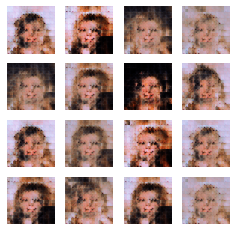

Epoch 3810, Discriminator: Loss: 0.8534655570983887 Accuracy: 0.84375, Generator Loss: 7.367154121398926, Time: 1334.1770100593567
Epoch 3820, Discriminator: Loss: 0.1542833298444748 Accuracy: 0.978515625, Generator Loss: 4.742702960968018, Time: 1337.5657505989075
Epoch 3830, Discriminator: Loss: 0.18380852043628693 Accuracy: 0.9765625, Generator Loss: 4.771242618560791, Time: 1340.9640316963196
Epoch 3840, Discriminator: Loss: 0.14856881648302078 Accuracy: 0.9765625, Generator Loss: 5.205994606018066, Time: 1344.35715508461
Epoch 3850, Discriminator: Loss: 0.20652343332767487 Accuracy: 0.970703125, Generator Loss: 7.5564422607421875, Time: 1347.770209312439
Epoch 3860, Discriminator: Loss: 0.11745393183082342 Accuracy: 0.978515625, Generator Loss: 6.360408782958984, Time: 1351.2042682170868
Epoch 3870, Discriminator: Loss: 0.2118619754910469 Accuracy: 0.962890625, Generator Loss: 5.940360069274902, Time: 1354.6191058158875
Epoch 3880, Discriminator: Loss: 0.18859514594078064 Accuracy

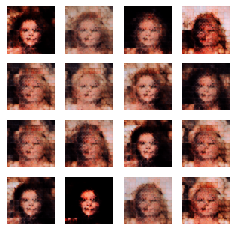

Epoch 3910, Discriminator: Loss: 0.11719287931919098 Accuracy: 0.984375, Generator Loss: 5.176425933837891, Time: 1368.8705303668976
Epoch 3920, Discriminator: Loss: 0.18685972690582275 Accuracy: 0.984375, Generator Loss: 5.421591281890869, Time: 1372.2701950073242
Epoch 3930, Discriminator: Loss: 0.1091507226228714 Accuracy: 0.986328125, Generator Loss: 4.878505706787109, Time: 1375.6733412742615
Epoch 3940, Discriminator: Loss: 0.264192596077919 Accuracy: 0.96875, Generator Loss: 6.283172607421875, Time: 1379.0703003406525
Epoch 3950, Discriminator: Loss: 0.06749744154512882 Accuracy: 0.9921875, Generator Loss: 5.313838005065918, Time: 1382.4660243988037
Epoch 3960, Discriminator: Loss: 0.19864099100232124 Accuracy: 0.9609375, Generator Loss: 5.436648368835449, Time: 1385.8683454990387
Epoch 3970, Discriminator: Loss: 0.32271481305360794 Accuracy: 0.943359375, Generator Loss: 4.649319648742676, Time: 1389.272022485733
Epoch 3980, Discriminator: Loss: 0.10427580773830414 Accuracy: 0.9

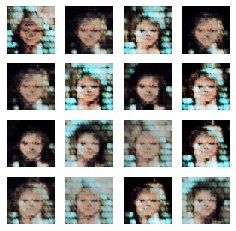

Epoch 4010, Discriminator: Loss: 0.12169822864234447 Accuracy: 0.978515625, Generator Loss: 5.792457580566406, Time: 1403.575752735138
Epoch 4020, Discriminator: Loss: 0.26780475676059723 Accuracy: 0.9609375, Generator Loss: 4.857553958892822, Time: 1406.9603559970856
Epoch 4030, Discriminator: Loss: 0.0985206589102745 Accuracy: 0.98046875, Generator Loss: 5.335386753082275, Time: 1410.338238477707
Epoch 4040, Discriminator: Loss: 0.3651571273803711 Accuracy: 0.943359375, Generator Loss: 8.816073417663574, Time: 1413.7289803028107
Epoch 4050, Discriminator: Loss: 0.12404540926218033 Accuracy: 0.982421875, Generator Loss: 5.043021202087402, Time: 1417.1256816387177
Epoch 4060, Discriminator: Loss: 0.07190128415822983 Accuracy: 0.994140625, Generator Loss: 5.480337142944336, Time: 1420.4990816116333
Epoch 4070, Discriminator: Loss: 0.16961056366562843 Accuracy: 0.97265625, Generator Loss: 5.086357116699219, Time: 1423.8945970535278
Epoch 4080, Discriminator: Loss: 0.03397249837871641 Acc

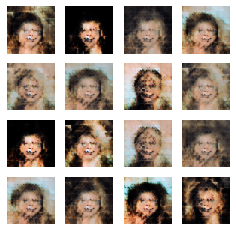

Epoch 4110, Discriminator: Loss: 0.1450723335146904 Accuracy: 0.978515625, Generator Loss: 5.162850379943848, Time: 1438.4532558918
Epoch 4120, Discriminator: Loss: 0.17452530190348625 Accuracy: 0.974609375, Generator Loss: 5.214620590209961, Time: 1441.8441972732544
Epoch 4130, Discriminator: Loss: 0.04435689002275467 Accuracy: 0.99609375, Generator Loss: 6.426471710205078, Time: 1445.2475399971008
Epoch 4140, Discriminator: Loss: 0.2143934778869152 Accuracy: 0.96484375, Generator Loss: 4.785919666290283, Time: 1448.6543662548065
Epoch 4150, Discriminator: Loss: 0.3008749298751354 Accuracy: 0.9453125, Generator Loss: 4.386161804199219, Time: 1452.0403707027435
Epoch 4160, Discriminator: Loss: 0.2689129412174225 Accuracy: 0.958984375, Generator Loss: 4.489221572875977, Time: 1455.4184119701385
Epoch 4170, Discriminator: Loss: 0.1664007194340229 Accuracy: 0.974609375, Generator Loss: 4.3358354568481445, Time: 1458.8000962734222
Epoch 4180, Discriminator: Loss: 0.07067519798874855 Accura

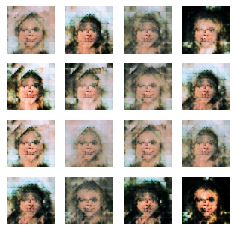

Epoch 4210, Discriminator: Loss: 0.10269347578287125 Accuracy: 0.982421875, Generator Loss: 5.159531593322754, Time: 1473.1033554077148
Epoch 4220, Discriminator: Loss: 0.18776707910001278 Accuracy: 0.96484375, Generator Loss: 5.414452075958252, Time: 1476.5101761817932
Epoch 4230, Discriminator: Loss: 0.062291502952575684 Accuracy: 0.9921875, Generator Loss: 5.448240280151367, Time: 1479.916258573532
Epoch 4240, Discriminator: Loss: 0.10187816619873047 Accuracy: 0.98828125, Generator Loss: 5.7298431396484375, Time: 1483.3286592960358
Epoch 4250, Discriminator: Loss: 0.2287985384464264 Accuracy: 0.953125, Generator Loss: 9.400660514831543, Time: 1486.740911245346
Epoch 4260, Discriminator: Loss: 0.16846951469779015 Accuracy: 0.9609375, Generator Loss: 7.405031681060791, Time: 1490.1251573562622
Epoch 4270, Discriminator: Loss: 0.11246659979224205 Accuracy: 0.984375, Generator Loss: 5.242764949798584, Time: 1493.5214116573334
Epoch 4280, Discriminator: Loss: 0.06229344755411148 Accuracy

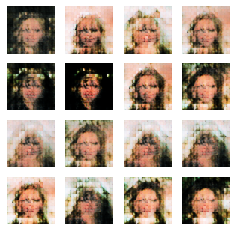

Epoch 4310, Discriminator: Loss: 0.0997808538377285 Accuracy: 0.986328125, Generator Loss: 5.473776817321777, Time: 1507.85325050354
Epoch 4320, Discriminator: Loss: 0.06899910978972912 Accuracy: 0.9921875, Generator Loss: 5.524306297302246, Time: 1511.2864775657654
Epoch 4330, Discriminator: Loss: 0.07671952247619629 Accuracy: 0.98828125, Generator Loss: 6.0222697257995605, Time: 1514.6778695583344
Epoch 4340, Discriminator: Loss: 0.15384657680988312 Accuracy: 0.96875, Generator Loss: 7.633559703826904, Time: 1518.0723993778229
Epoch 4350, Discriminator: Loss: 0.2256365343928337 Accuracy: 0.962890625, Generator Loss: 6.437056064605713, Time: 1521.469229221344
Epoch 4360, Discriminator: Loss: 0.0462912917137146 Accuracy: 0.990234375, Generator Loss: 6.881556510925293, Time: 1524.8604245185852
Epoch 4370, Discriminator: Loss: 0.09687536023557186 Accuracy: 0.98828125, Generator Loss: 5.626801490783691, Time: 1528.2557032108307
Epoch 4380, Discriminator: Loss: 0.0757884569466114 Accuracy:

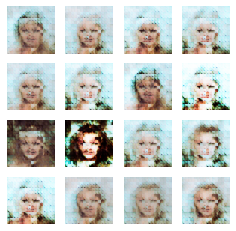

Epoch 4410, Discriminator: Loss: 0.10124986246228218 Accuracy: 0.98828125, Generator Loss: 7.132936954498291, Time: 1542.8188273906708
Epoch 4420, Discriminator: Loss: 0.1166522279381752 Accuracy: 0.984375, Generator Loss: 6.315274715423584, Time: 1546.2070813179016
Epoch 4430, Discriminator: Loss: 0.16932322829961777 Accuracy: 0.98046875, Generator Loss: 7.3974928855896, Time: 1549.5907182693481
Epoch 4440, Discriminator: Loss: 0.08717604354023933 Accuracy: 0.9921875, Generator Loss: 5.3669023513793945, Time: 1552.9867117404938
Epoch 4450, Discriminator: Loss: 0.09899388998746872 Accuracy: 0.98828125, Generator Loss: 5.611570358276367, Time: 1556.39373087883
Epoch 4460, Discriminator: Loss: 0.04607500694692135 Accuracy: 0.994140625, Generator Loss: 6.329404830932617, Time: 1559.784679889679
Epoch 4470, Discriminator: Loss: 0.09596739336848259 Accuracy: 0.990234375, Generator Loss: 7.015013694763184, Time: 1563.181999206543
Epoch 4480, Discriminator: Loss: 0.08141699060797691 Accuracy:

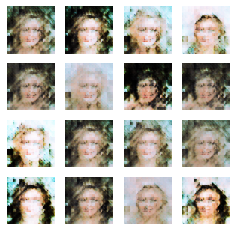

Epoch 4510, Discriminator: Loss: 0.09332515671849251 Accuracy: 0.986328125, Generator Loss: 6.707749366760254, Time: 1577.5157368183136
Epoch 4520, Discriminator: Loss: 0.09116220474243164 Accuracy: 0.982421875, Generator Loss: 5.550773620605469, Time: 1580.9132115840912
Epoch 4530, Discriminator: Loss: 0.12326298281550407 Accuracy: 0.990234375, Generator Loss: 5.940483093261719, Time: 1584.3007538318634
Epoch 4540, Discriminator: Loss: 0.07325569167733192 Accuracy: 0.994140625, Generator Loss: 5.592392921447754, Time: 1587.6811447143555
Epoch 4550, Discriminator: Loss: 0.09383497759699821 Accuracy: 0.986328125, Generator Loss: 5.5245208740234375, Time: 1591.067454814911
Epoch 4560, Discriminator: Loss: 0.11653628200292587 Accuracy: 0.98046875, Generator Loss: 5.877401351928711, Time: 1594.4544649124146
Epoch 4570, Discriminator: Loss: 0.06338680163025856 Accuracy: 0.990234375, Generator Loss: 5.697193145751953, Time: 1597.8497910499573
Epoch 4580, Discriminator: Loss: 0.20863156765699

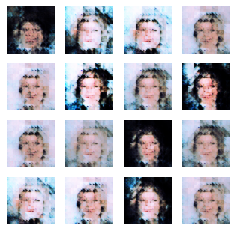

Epoch 4610, Discriminator: Loss: 1.2344259023666382 Accuracy: 0.83203125, Generator Loss: 24.516077041625977, Time: 1612.1514132022858
Epoch 4620, Discriminator: Loss: 0.26006971299648285 Accuracy: 0.94921875, Generator Loss: 5.8165411949157715, Time: 1615.5518281459808
Epoch 4630, Discriminator: Loss: 0.2542126998305321 Accuracy: 0.95703125, Generator Loss: 5.487785339355469, Time: 1618.9350137710571
Epoch 4640, Discriminator: Loss: 0.1834271475672722 Accuracy: 0.98046875, Generator Loss: 4.705143451690674, Time: 1622.323720216751
Epoch 4650, Discriminator: Loss: 0.1624131128191948 Accuracy: 0.984375, Generator Loss: 4.591582298278809, Time: 1625.7192342281342
Epoch 4660, Discriminator: Loss: 0.11291713640093803 Accuracy: 0.978515625, Generator Loss: 4.656693935394287, Time: 1629.105139017105
Epoch 4670, Discriminator: Loss: 0.2716300040483475 Accuracy: 0.955078125, Generator Loss: 4.847229480743408, Time: 1632.4988644123077
Epoch 4680, Discriminator: Loss: 0.08041473850607872 Accurac

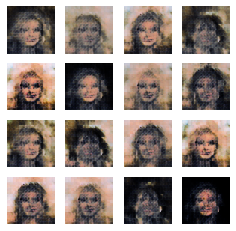

Epoch 4710, Discriminator: Loss: 0.15605392307043076 Accuracy: 0.978515625, Generator Loss: 4.519134521484375, Time: 1647.187210559845
Epoch 4720, Discriminator: Loss: 0.14376569166779518 Accuracy: 0.97265625, Generator Loss: 4.908326625823975, Time: 1650.5985288619995
Epoch 4730, Discriminator: Loss: 0.10225310921669006 Accuracy: 0.982421875, Generator Loss: 5.006465435028076, Time: 1654.036362171173
Epoch 4740, Discriminator: Loss: 0.0769324004650116 Accuracy: 0.982421875, Generator Loss: 5.280426979064941, Time: 1657.4754846096039
Epoch 4750, Discriminator: Loss: 0.027784335892647505 Accuracy: 0.998046875, Generator Loss: 6.025938987731934, Time: 1660.8740375041962
Epoch 4760, Discriminator: Loss: 0.06696893647313118 Accuracy: 0.9921875, Generator Loss: 6.091575622558594, Time: 1664.276365995407
Epoch 4770, Discriminator: Loss: 1.6066470816731453 Accuracy: 0.802734375, Generator Loss: 4.290013313293457, Time: 1667.6882016658783
Epoch 4780, Discriminator: Loss: 0.24743442982435226 Ac

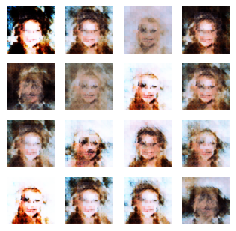

Epoch 4810, Discriminator: Loss: 0.177034430205822 Accuracy: 0.96875, Generator Loss: 4.505157947540283, Time: 1682.0352127552032
Epoch 4820, Discriminator: Loss: 0.07326210662722588 Accuracy: 0.9921875, Generator Loss: 5.411729335784912, Time: 1685.4450228214264
Epoch 4830, Discriminator: Loss: 0.07633968442678452 Accuracy: 0.990234375, Generator Loss: 5.717903137207031, Time: 1688.85817861557
Epoch 4840, Discriminator: Loss: 0.2951255887746811 Accuracy: 0.9375, Generator Loss: 7.843992233276367, Time: 1692.2612254619598
Epoch 4850, Discriminator: Loss: 0.22463544458150864 Accuracy: 0.95703125, Generator Loss: 4.765868663787842, Time: 1695.6805427074432
Epoch 4860, Discriminator: Loss: 0.1321033462882042 Accuracy: 0.982421875, Generator Loss: 5.200348377227783, Time: 1699.0598380565643
Epoch 4870, Discriminator: Loss: 0.2269577458500862 Accuracy: 0.962890625, Generator Loss: 4.988600730895996, Time: 1702.4582521915436
Epoch 4880, Discriminator: Loss: 0.086934644728899 Accuracy: 0.9902

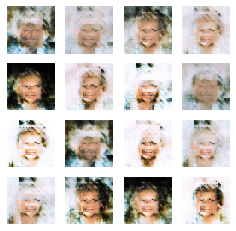

Epoch 4910, Discriminator: Loss: 0.18586086481809616 Accuracy: 0.970703125, Generator Loss: 5.2520599365234375, Time: 1716.769348859787
Epoch 4920, Discriminator: Loss: 0.3597278445959091 Accuracy: 0.935546875, Generator Loss: 6.314661979675293, Time: 1720.1666960716248
Epoch 4930, Discriminator: Loss: 0.1881408914923668 Accuracy: 0.96875, Generator Loss: 5.484064102172852, Time: 1723.5671315193176
Epoch 4940, Discriminator: Loss: 0.28250356018543243 Accuracy: 0.94140625, Generator Loss: 5.873180866241455, Time: 1726.939367055893
Epoch 4950, Discriminator: Loss: 0.345968559384346 Accuracy: 0.9375, Generator Loss: 7.30731201171875, Time: 1730.3243136405945
Epoch 4960, Discriminator: Loss: 0.11835526674985886 Accuracy: 0.98046875, Generator Loss: 5.988548278808594, Time: 1733.7150356769562
Epoch 4970, Discriminator: Loss: 0.22606255114078522 Accuracy: 0.962890625, Generator Loss: 5.475398540496826, Time: 1737.094051361084
Epoch 4980, Discriminator: Loss: 0.15884455293416977 Accuracy: 0.9

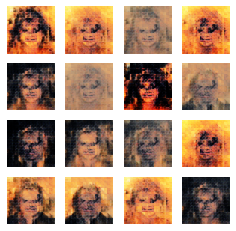

Epoch 5010, Discriminator: Loss: 0.10853349417448044 Accuracy: 0.982421875, Generator Loss: 5.678028106689453, Time: 1751.3374996185303
Epoch 5020, Discriminator: Loss: 0.041048625484108925 Accuracy: 0.994140625, Generator Loss: 5.594117164611816, Time: 1754.727694272995
Epoch 5030, Discriminator: Loss: 0.05325193144381046 Accuracy: 0.9921875, Generator Loss: 5.808317184448242, Time: 1758.1190633773804
Epoch 5040, Discriminator: Loss: 0.07158180885016918 Accuracy: 0.994140625, Generator Loss: 6.046914577484131, Time: 1761.515515089035
Epoch 5050, Discriminator: Loss: 0.22244957089424133 Accuracy: 0.962890625, Generator Loss: 8.511740684509277, Time: 1764.9107983112335
Epoch 5060, Discriminator: Loss: 0.24552395939826965 Accuracy: 0.95703125, Generator Loss: 5.23833703994751, Time: 1768.287807226181
Epoch 5070, Discriminator: Loss: 0.16796139627695084 Accuracy: 0.978515625, Generator Loss: 5.613872528076172, Time: 1771.677592754364
Epoch 5080, Discriminator: Loss: 0.272956445813179 Accu

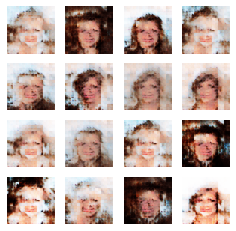

Epoch 5110, Discriminator: Loss: 0.09965294972062111 Accuracy: 0.978515625, Generator Loss: 5.676747798919678, Time: 1786.2529249191284
Epoch 5120, Discriminator: Loss: 0.0786009356379509 Accuracy: 0.9921875, Generator Loss: 5.270678997039795, Time: 1789.6522150039673
Epoch 5130, Discriminator: Loss: 0.1176549457013607 Accuracy: 0.974609375, Generator Loss: 5.602745532989502, Time: 1793.0543167591095
Epoch 5140, Discriminator: Loss: 0.07703638821840286 Accuracy: 0.994140625, Generator Loss: 5.3019914627075195, Time: 1796.461632013321
Epoch 5150, Discriminator: Loss: 0.10899500548839569 Accuracy: 0.982421875, Generator Loss: 5.646716117858887, Time: 1799.8543615341187
Epoch 5160, Discriminator: Loss: 0.061720481142401695 Accuracy: 0.990234375, Generator Loss: 5.935766696929932, Time: 1803.2234966754913
Epoch 5170, Discriminator: Loss: 0.07732816226780415 Accuracy: 0.990234375, Generator Loss: 6.394209861755371, Time: 1806.6170749664307
Epoch 5180, Discriminator: Loss: 0.3403569711372256

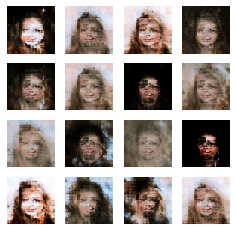

Epoch 5210, Discriminator: Loss: 0.21294686943292618 Accuracy: 0.970703125, Generator Loss: 6.7812886238098145, Time: 1820.9504735469818
Epoch 5220, Discriminator: Loss: 0.21788955479860306 Accuracy: 0.96484375, Generator Loss: 6.426275730133057, Time: 1824.3650109767914
Epoch 5230, Discriminator: Loss: 0.14237042516469955 Accuracy: 0.98046875, Generator Loss: 5.052949905395508, Time: 1827.778484582901
Epoch 5240, Discriminator: Loss: 0.1467369943857193 Accuracy: 0.978515625, Generator Loss: 5.522170543670654, Time: 1831.1666343212128
Epoch 5250, Discriminator: Loss: 0.1120440922677517 Accuracy: 0.982421875, Generator Loss: 5.064655780792236, Time: 1834.5567564964294
Epoch 5260, Discriminator: Loss: 0.1052742451429367 Accuracy: 0.982421875, Generator Loss: 5.467501640319824, Time: 1837.9430248737335
Epoch 5270, Discriminator: Loss: 0.12149975821375847 Accuracy: 0.98046875, Generator Loss: 5.453855037689209, Time: 1841.344476699829
Epoch 5280, Discriminator: Loss: 0.0902106910943985 Acc

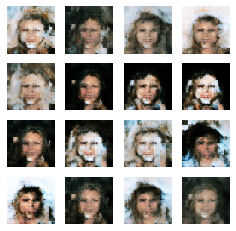

Epoch 5310, Discriminator: Loss: 0.13910310715436935 Accuracy: 0.978515625, Generator Loss: 5.365861892700195, Time: 1855.6191973686218
Epoch 5320, Discriminator: Loss: 0.07667093724012375 Accuracy: 0.9921875, Generator Loss: 5.341719627380371, Time: 1859.004884004593
Epoch 5330, Discriminator: Loss: 0.10033838450908661 Accuracy: 0.982421875, Generator Loss: 5.697697639465332, Time: 1862.3996827602386
Epoch 5340, Discriminator: Loss: 0.4435580335557461 Accuracy: 0.92578125, Generator Loss: 4.2477569580078125, Time: 1865.7897019386292
Epoch 5350, Discriminator: Loss: 0.22358733415603638 Accuracy: 0.96484375, Generator Loss: 6.745977401733398, Time: 1869.1719996929169
Epoch 5360, Discriminator: Loss: 0.09379609674215317 Accuracy: 0.98828125, Generator Loss: 5.688431739807129, Time: 1872.5451972484589
Epoch 5370, Discriminator: Loss: 0.09161956235766411 Accuracy: 0.990234375, Generator Loss: 5.782225131988525, Time: 1875.919810295105
Epoch 5380, Discriminator: Loss: 0.06832689233124256 Ac

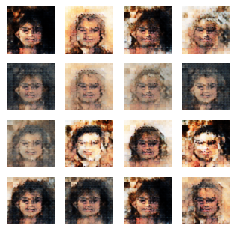

Epoch 5410, Discriminator: Loss: 0.13691959530115128 Accuracy: 0.982421875, Generator Loss: 5.234485149383545, Time: 1890.4542398452759
Epoch 5420, Discriminator: Loss: 0.07967900112271309 Accuracy: 0.98828125, Generator Loss: 5.479014873504639, Time: 1893.8574283123016
Epoch 5430, Discriminator: Loss: 0.12554800510406494 Accuracy: 0.982421875, Generator Loss: 6.116451263427734, Time: 1897.2516176700592
Epoch 5440, Discriminator: Loss: 0.052283186465501785 Accuracy: 0.99609375, Generator Loss: 5.932082176208496, Time: 1900.6444854736328
Epoch 5450, Discriminator: Loss: 0.1326669678092003 Accuracy: 0.978515625, Generator Loss: 5.528944969177246, Time: 1904.0344457626343
Epoch 5460, Discriminator: Loss: 0.05622458830475807 Accuracy: 0.9921875, Generator Loss: 5.7950520515441895, Time: 1907.4133388996124
Epoch 5470, Discriminator: Loss: 0.14340375363826752 Accuracy: 0.984375, Generator Loss: 6.476813316345215, Time: 1910.7905488014221
Epoch 5480, Discriminator: Loss: 0.191079743206501 Acc

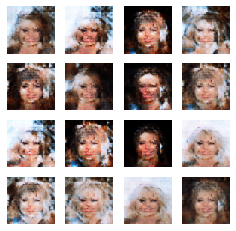

Epoch 5510, Discriminator: Loss: 0.09444986283779144 Accuracy: 0.978515625, Generator Loss: 6.077959060668945, Time: 1925.0564835071564
Epoch 5520, Discriminator: Loss: 0.21891864389181137 Accuracy: 0.9609375, Generator Loss: 6.8239030838012695, Time: 1928.4414336681366
Epoch 5530, Discriminator: Loss: 0.06140429154038429 Accuracy: 0.9921875, Generator Loss: 6.0316853523254395, Time: 1931.8441271781921
Epoch 5540, Discriminator: Loss: 0.14458212163299322 Accuracy: 0.96875, Generator Loss: 5.722074508666992, Time: 1935.2376780509949
Epoch 5550, Discriminator: Loss: 0.07764305546879768 Accuracy: 0.986328125, Generator Loss: 5.891756057739258, Time: 1938.633831501007
Epoch 5560, Discriminator: Loss: 0.4721478670835495 Accuracy: 0.919921875, Generator Loss: 5.327418327331543, Time: 1942.0094556808472
Epoch 5570, Discriminator: Loss: 0.07869622483849525 Accuracy: 0.986328125, Generator Loss: 5.881716251373291, Time: 1945.4092667102814
Epoch 5580, Discriminator: Loss: 0.17698289453983307 Acc

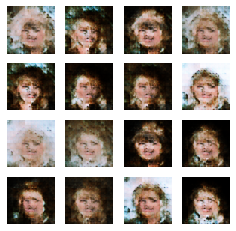

Epoch 5610, Discriminator: Loss: 0.08067382499575615 Accuracy: 0.98828125, Generator Loss: 5.745019912719727, Time: 1959.7124574184418
Epoch 5620, Discriminator: Loss: 0.21077236533164978 Accuracy: 0.955078125, Generator Loss: 5.944455623626709, Time: 1963.1472635269165
Epoch 5630, Discriminator: Loss: 0.12231865152716637 Accuracy: 0.98046875, Generator Loss: 6.126540660858154, Time: 1966.5323312282562
Epoch 5640, Discriminator: Loss: 0.07241341844201088 Accuracy: 0.9921875, Generator Loss: 5.94769287109375, Time: 1969.9159741401672
Epoch 5650, Discriminator: Loss: 0.05408293753862381 Accuracy: 0.994140625, Generator Loss: 5.200313568115234, Time: 1973.2992660999298
Epoch 5660, Discriminator: Loss: 0.06686080619692802 Accuracy: 0.990234375, Generator Loss: 5.714514255523682, Time: 1976.6682686805725
Epoch 5670, Discriminator: Loss: 0.12116596847772598 Accuracy: 0.984375, Generator Loss: 5.839439868927002, Time: 1980.055380821228
Epoch 5680, Discriminator: Loss: 0.06983236037194729 Accu

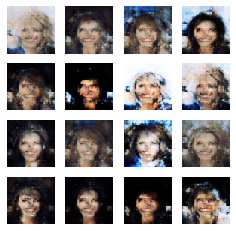

Epoch 5710, Discriminator: Loss: 0.11338715627789497 Accuracy: 0.984375, Generator Loss: 5.728557586669922, Time: 1994.565313577652
Epoch 5720, Discriminator: Loss: 0.08836580812931061 Accuracy: 0.986328125, Generator Loss: 5.858832359313965, Time: 1997.944830417633
Epoch 5730, Discriminator: Loss: 0.11470706900581717 Accuracy: 0.98046875, Generator Loss: 6.171120643615723, Time: 2001.3272092342377
Epoch 5740, Discriminator: Loss: 0.04812483303248882 Accuracy: 0.99609375, Generator Loss: 6.456658363342285, Time: 2004.714664697647
Epoch 5750, Discriminator: Loss: 0.17422933876514435 Accuracy: 0.974609375, Generator Loss: 6.638092994689941, Time: 2008.1034486293793
Epoch 5760, Discriminator: Loss: 0.14760316908359528 Accuracy: 0.982421875, Generator Loss: 6.103126049041748, Time: 2011.4765646457672
Epoch 5770, Discriminator: Loss: 0.11390777304768562 Accuracy: 0.984375, Generator Loss: 6.905176162719727, Time: 2014.8563871383667
Epoch 5780, Discriminator: Loss: 0.0988494660705328 Accurac

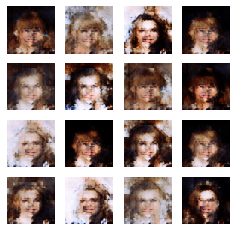

Epoch 5810, Discriminator: Loss: 0.07587998732924461 Accuracy: 0.9921875, Generator Loss: 5.716808319091797, Time: 2029.1267006397247
Epoch 5820, Discriminator: Loss: 0.12853416800498962 Accuracy: 0.98046875, Generator Loss: 5.866095542907715, Time: 2032.5036516189575
Epoch 5830, Discriminator: Loss: 0.049569823779165745 Accuracy: 0.9921875, Generator Loss: 5.662402629852295, Time: 2035.8910338878632
Epoch 5840, Discriminator: Loss: 0.10872822999954224 Accuracy: 0.98046875, Generator Loss: 6.020711898803711, Time: 2039.2644414901733
Epoch 5850, Discriminator: Loss: 0.04325591865926981 Accuracy: 0.990234375, Generator Loss: 6.57526159286499, Time: 2042.6475539207458
Epoch 5860, Discriminator: Loss: 0.11502806609496474 Accuracy: 0.974609375, Generator Loss: 7.206079959869385, Time: 2046.0213191509247
Epoch 5870, Discriminator: Loss: 0.11432998161762953 Accuracy: 0.982421875, Generator Loss: 6.877498626708984, Time: 2049.399915933609
Epoch 5880, Discriminator: Loss: 0.04986890032887459 Ac

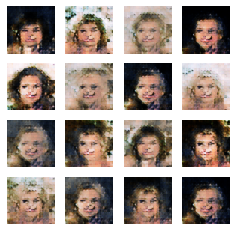

Epoch 5910, Discriminator: Loss: 0.08724220283329487 Accuracy: 0.990234375, Generator Loss: 5.827672958374023, Time: 2063.6323885917664
Epoch 5920, Discriminator: Loss: 0.058081235736608505 Accuracy: 0.990234375, Generator Loss: 6.253291130065918, Time: 2067.0132291316986
Epoch 5930, Discriminator: Loss: 0.059515878558158875 Accuracy: 0.994140625, Generator Loss: 6.005939960479736, Time: 2070.408920764923
Epoch 5940, Discriminator: Loss: 0.05749451741576195 Accuracy: 0.990234375, Generator Loss: 6.220911979675293, Time: 2073.8026552200317
Epoch 5950, Discriminator: Loss: 0.0496161887422204 Accuracy: 0.990234375, Generator Loss: 5.869161605834961, Time: 2077.185447216034
Epoch 5960, Discriminator: Loss: 0.034754300490021706 Accuracy: 0.99609375, Generator Loss: 6.622922420501709, Time: 2080.570368051529
Epoch 5970, Discriminator: Loss: 0.1105831116437912 Accuracy: 0.984375, Generator Loss: 6.113921642303467, Time: 2083.970202922821
Epoch 5980, Discriminator: Loss: 0.10146649926900864 Ac

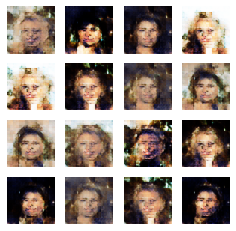

Epoch 6010, Discriminator: Loss: 0.060189224779605865 Accuracy: 0.994140625, Generator Loss: 6.345288276672363, Time: 2098.240689277649
Epoch 6020, Discriminator: Loss: 0.11683887243270874 Accuracy: 0.974609375, Generator Loss: 7.145370006561279, Time: 2101.619764328003
Epoch 6030, Discriminator: Loss: 0.045404303818941116 Accuracy: 0.99609375, Generator Loss: 5.850031852722168, Time: 2104.9917092323303
Epoch 6040, Discriminator: Loss: 0.06975722126662731 Accuracy: 0.994140625, Generator Loss: 6.600378036499023, Time: 2108.3789336681366
Epoch 6050, Discriminator: Loss: 0.04267582483589649 Accuracy: 0.99609375, Generator Loss: 6.554108142852783, Time: 2111.765193939209
Epoch 6060, Discriminator: Loss: 0.06637227348983288 Accuracy: 0.9921875, Generator Loss: 6.139892578125, Time: 2115.134692668915
Epoch 6070, Discriminator: Loss: 0.09043346717953682 Accuracy: 0.98828125, Generator Loss: 8.16300106048584, Time: 2118.5111091136932
Epoch 6080, Discriminator: Loss: 0.007461129454895854 Accur

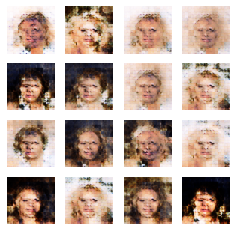

Epoch 6110, Discriminator: Loss: 0.4422725439071655 Accuracy: 0.91796875, Generator Loss: 3.4699459075927734, Time: 2133.081203699112
Epoch 6120, Discriminator: Loss: 0.28026146441698074 Accuracy: 0.962890625, Generator Loss: 3.9316699504852295, Time: 2136.483589887619
Epoch 6130, Discriminator: Loss: 0.13274000585079193 Accuracy: 0.98828125, Generator Loss: 4.228684425354004, Time: 2139.8794281482697
Epoch 6140, Discriminator: Loss: 0.1416216492652893 Accuracy: 0.98828125, Generator Loss: 4.47972297668457, Time: 2143.260898590088
Epoch 6150, Discriminator: Loss: 0.15479529276490211 Accuracy: 0.986328125, Generator Loss: 4.9781999588012695, Time: 2146.6421015262604
Epoch 6160, Discriminator: Loss: 0.11293965764343739 Accuracy: 0.982421875, Generator Loss: 5.136811256408691, Time: 2150.0228242874146
Epoch 6170, Discriminator: Loss: 0.11316951736807823 Accuracy: 0.986328125, Generator Loss: 4.774307727813721, Time: 2153.410923242569
Epoch 6180, Discriminator: Loss: 0.1839904710650444 Acc

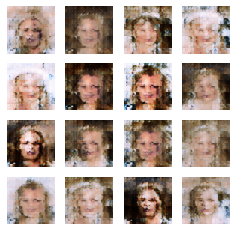

Epoch 6210, Discriminator: Loss: 0.09345955774188042 Accuracy: 0.9921875, Generator Loss: 5.046361446380615, Time: 2167.6710901260376
Epoch 6220, Discriminator: Loss: 0.21774684637784958 Accuracy: 0.9765625, Generator Loss: 6.25053596496582, Time: 2171.0415863990784
Epoch 6230, Discriminator: Loss: 0.19610562175512314 Accuracy: 0.974609375, Generator Loss: 5.570068836212158, Time: 2174.436698436737
Epoch 6240, Discriminator: Loss: 0.22339046001434326 Accuracy: 0.966796875, Generator Loss: 5.0219502449035645, Time: 2177.7954547405243
Epoch 6250, Discriminator: Loss: 0.16447661072015762 Accuracy: 0.98046875, Generator Loss: 5.816740036010742, Time: 2181.17449259758
Epoch 6260, Discriminator: Loss: 0.2063748463988304 Accuracy: 0.96484375, Generator Loss: 5.510262489318848, Time: 2184.5375394821167
Epoch 6270, Discriminator: Loss: 0.3096523955464363 Accuracy: 0.9375, Generator Loss: 4.052011013031006, Time: 2187.9180779457092
Epoch 6280, Discriminator: Loss: 0.17094187811017036 Accuracy: 0

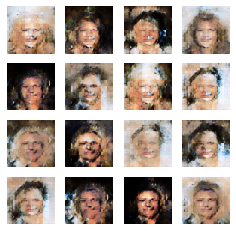

Epoch 6310, Discriminator: Loss: 0.12487092986702919 Accuracy: 0.982421875, Generator Loss: 4.873384952545166, Time: 2202.1116077899933
Epoch 6320, Discriminator: Loss: 0.0731663629412651 Accuracy: 0.990234375, Generator Loss: 5.117239952087402, Time: 2205.480085134506
Epoch 6330, Discriminator: Loss: 0.41903479397296906 Accuracy: 0.923828125, Generator Loss: 7.304668426513672, Time: 2208.8550510406494
Epoch 6340, Discriminator: Loss: 0.10279503092169762 Accuracy: 0.984375, Generator Loss: 5.022872447967529, Time: 2212.2299015522003
Epoch 6350, Discriminator: Loss: 0.1019860990345478 Accuracy: 0.982421875, Generator Loss: 5.114960670471191, Time: 2215.6227543354034
Epoch 6360, Discriminator: Loss: 0.11018844321370125 Accuracy: 0.994140625, Generator Loss: 5.038836479187012, Time: 2219.000652074814
Epoch 6370, Discriminator: Loss: 0.10587358102202415 Accuracy: 0.982421875, Generator Loss: 5.076769828796387, Time: 2222.358353614807
Epoch 6380, Discriminator: Loss: 0.089188352227211 Accur

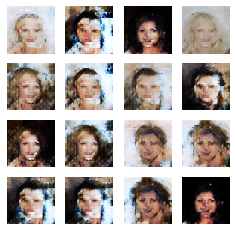

Epoch 6410, Discriminator: Loss: 0.13691262155771255 Accuracy: 0.98046875, Generator Loss: 4.620372295379639, Time: 2236.7834544181824
Epoch 6420, Discriminator: Loss: 0.19259140640497208 Accuracy: 0.96484375, Generator Loss: 5.255141258239746, Time: 2240.167016506195
Epoch 6430, Discriminator: Loss: 0.08783480152487755 Accuracy: 0.986328125, Generator Loss: 5.465373992919922, Time: 2243.5413060188293
Epoch 6440, Discriminator: Loss: 0.13512573391199112 Accuracy: 0.984375, Generator Loss: 6.067149639129639, Time: 2246.920113325119
Epoch 6450, Discriminator: Loss: 0.16911181062459946 Accuracy: 0.974609375, Generator Loss: 5.518398761749268, Time: 2250.296012878418
Epoch 6460, Discriminator: Loss: 0.07102815806865692 Accuracy: 0.98828125, Generator Loss: 5.690319061279297, Time: 2253.6567759513855
Epoch 6470, Discriminator: Loss: 0.03769368305802345 Accuracy: 0.99609375, Generator Loss: 5.21533727645874, Time: 2257.0287580490112
Epoch 6480, Discriminator: Loss: 0.14317770302295685 Accura

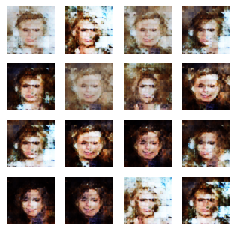

Epoch 6510, Discriminator: Loss: 0.1525806002318859 Accuracy: 0.97265625, Generator Loss: 5.255847454071045, Time: 2271.3290202617645
Epoch 6520, Discriminator: Loss: 0.12283413857221603 Accuracy: 0.984375, Generator Loss: 5.398158073425293, Time: 2274.7119998931885
Epoch 6530, Discriminator: Loss: 0.09251425415277481 Accuracy: 0.990234375, Generator Loss: 6.017050266265869, Time: 2278.0836219787598
Epoch 6540, Discriminator: Loss: 0.11817579716444016 Accuracy: 0.984375, Generator Loss: 4.493898391723633, Time: 2281.461727142334
Epoch 6550, Discriminator: Loss: 0.10517574101686478 Accuracy: 0.982421875, Generator Loss: 5.097538948059082, Time: 2284.840295314789
Epoch 6560, Discriminator: Loss: 0.06762216798961163 Accuracy: 0.9921875, Generator Loss: 5.3692307472229, Time: 2288.202159881592
Epoch 6570, Discriminator: Loss: 0.13294131308794022 Accuracy: 0.978515625, Generator Loss: 5.507169246673584, Time: 2291.5817725658417
Epoch 6580, Discriminator: Loss: 0.1805889904499054 Accuracy: 0

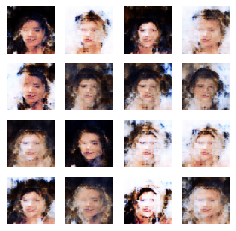

Epoch 6610, Discriminator: Loss: 0.2485993355512619 Accuracy: 0.958984375, Generator Loss: 6.312562465667725, Time: 2305.825053215027
Epoch 6620, Discriminator: Loss: 0.12318727746605873 Accuracy: 0.978515625, Generator Loss: 5.055688858032227, Time: 2309.2102615833282
Epoch 6630, Discriminator: Loss: 0.09586013108491898 Accuracy: 0.984375, Generator Loss: 5.285759925842285, Time: 2312.601697206497
Epoch 6640, Discriminator: Loss: 0.14740744978189468 Accuracy: 0.970703125, Generator Loss: 6.017398834228516, Time: 2315.9764075279236
Epoch 6650, Discriminator: Loss: 0.07885938137769699 Accuracy: 0.986328125, Generator Loss: 5.165682315826416, Time: 2319.3477742671967
Epoch 6660, Discriminator: Loss: 0.26350734382867813 Accuracy: 0.958984375, Generator Loss: 6.731799125671387, Time: 2322.712382555008
Epoch 6670, Discriminator: Loss: 0.20560557395219803 Accuracy: 0.951171875, Generator Loss: 5.273098945617676, Time: 2326.0935044288635
Epoch 6680, Discriminator: Loss: 0.07388905063271523 Ac

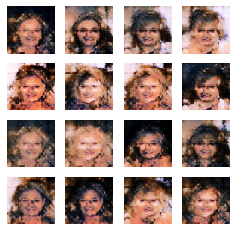

Epoch 6710, Discriminator: Loss: 0.19544532150030136 Accuracy: 0.970703125, Generator Loss: 5.061418533325195, Time: 2340.5647394657135
Epoch 6720, Discriminator: Loss: 0.1306366492062807 Accuracy: 0.978515625, Generator Loss: 5.48001766204834, Time: 2343.9354407787323
Epoch 6730, Discriminator: Loss: 0.08612107113003731 Accuracy: 0.984375, Generator Loss: 5.795224666595459, Time: 2347.3118574619293
Epoch 6740, Discriminator: Loss: 0.1056642234325409 Accuracy: 0.984375, Generator Loss: 6.035072326660156, Time: 2350.698614835739
Epoch 6750, Discriminator: Loss: 0.12924546003341675 Accuracy: 0.97265625, Generator Loss: 6.003362655639648, Time: 2354.0952026844025
Epoch 6760, Discriminator: Loss: 0.09819613769650459 Accuracy: 0.986328125, Generator Loss: 5.927034854888916, Time: 2357.479663848877
Epoch 6770, Discriminator: Loss: 0.04289336549118161 Accuracy: 0.99609375, Generator Loss: 6.616086959838867, Time: 2360.8795568943024
Epoch 6780, Discriminator: Loss: 0.1424509147182107 Accuracy:

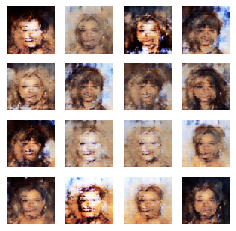

Epoch 6810, Discriminator: Loss: 0.078473050147295 Accuracy: 0.990234375, Generator Loss: 5.521151542663574, Time: 2375.350677013397
Epoch 6820, Discriminator: Loss: 0.14761878922581673 Accuracy: 0.974609375, Generator Loss: 5.44345235824585, Time: 2378.7301506996155
Epoch 6830, Discriminator: Loss: 0.10460628196597099 Accuracy: 0.98828125, Generator Loss: 5.80266809463501, Time: 2382.1146478652954
Epoch 6840, Discriminator: Loss: 0.07887540757656097 Accuracy: 0.986328125, Generator Loss: 6.603405952453613, Time: 2385.476529121399
Epoch 6850, Discriminator: Loss: 0.1210082396864891 Accuracy: 0.986328125, Generator Loss: 6.013517379760742, Time: 2388.8548595905304
Epoch 6860, Discriminator: Loss: 0.26695367228239775 Accuracy: 0.951171875, Generator Loss: 4.766772270202637, Time: 2392.2146615982056
Epoch 6870, Discriminator: Loss: 0.06743736937642097 Accuracy: 0.9921875, Generator Loss: 5.389965057373047, Time: 2395.618620634079
Epoch 6880, Discriminator: Loss: 0.13981740921735764 Accura

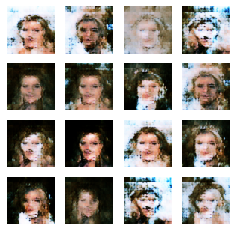

Epoch 6910, Discriminator: Loss: 0.12725231423974037 Accuracy: 0.98046875, Generator Loss: 5.211451530456543, Time: 2409.9094502925873
Epoch 6920, Discriminator: Loss: 0.1100909560918808 Accuracy: 0.9765625, Generator Loss: 5.284521579742432, Time: 2413.3060739040375
Epoch 6930, Discriminator: Loss: 0.13225040584802628 Accuracy: 0.982421875, Generator Loss: 6.0535712242126465, Time: 2416.695554256439
Epoch 6940, Discriminator: Loss: 0.12587375566363335 Accuracy: 0.986328125, Generator Loss: 5.886477470397949, Time: 2420.0907123088837
Epoch 6950, Discriminator: Loss: 0.0654772873967886 Accuracy: 0.990234375, Generator Loss: 5.711394786834717, Time: 2423.495581150055
Epoch 6960, Discriminator: Loss: 0.0916799046099186 Accuracy: 0.990234375, Generator Loss: 5.838672637939453, Time: 2426.890779018402
Epoch 6970, Discriminator: Loss: 0.09963185153901577 Accuracy: 0.982421875, Generator Loss: 6.303760528564453, Time: 2430.2908720970154
Epoch 6980, Discriminator: Loss: 0.1767842248082161 Accu

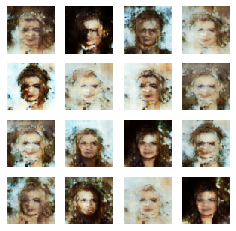

Epoch 7010, Discriminator: Loss: 0.1057153008878231 Accuracy: 0.98046875, Generator Loss: 5.2181267738342285, Time: 2444.6439940929413
Epoch 7020, Discriminator: Loss: 0.14432574808597565 Accuracy: 0.978515625, Generator Loss: 6.232635021209717, Time: 2448.026206254959
Epoch 7030, Discriminator: Loss: 0.14597627520561218 Accuracy: 0.97265625, Generator Loss: 6.62372350692749, Time: 2451.398442029953
Epoch 7040, Discriminator: Loss: 0.04438303783535957 Accuracy: 0.99609375, Generator Loss: 6.135280609130859, Time: 2454.7906732559204
Epoch 7050, Discriminator: Loss: 0.06847146339714527 Accuracy: 0.98828125, Generator Loss: 6.700536727905273, Time: 2458.1704041957855
Epoch 7060, Discriminator: Loss: 0.07403289526700974 Accuracy: 0.9921875, Generator Loss: 5.1843671798706055, Time: 2461.5571784973145
Epoch 7070, Discriminator: Loss: 0.07897910103201866 Accuracy: 0.986328125, Generator Loss: 6.784479141235352, Time: 2464.9050312042236
Epoch 7080, Discriminator: Loss: 0.11226395890116692 Acc

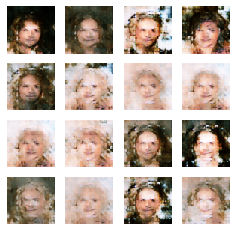

Epoch 7110, Discriminator: Loss: 0.3424602337181568 Accuracy: 0.927734375, Generator Loss: 4.37498664855957, Time: 2479.3968443870544
Epoch 7120, Discriminator: Loss: 0.09752630442380905 Accuracy: 0.990234375, Generator Loss: 5.831079959869385, Time: 2482.7690908908844
Epoch 7130, Discriminator: Loss: 0.10366781055927277 Accuracy: 0.984375, Generator Loss: 5.764801979064941, Time: 2486.1398665905
Epoch 7140, Discriminator: Loss: 0.09095696918666363 Accuracy: 0.990234375, Generator Loss: 6.322011947631836, Time: 2489.5218966007233
Epoch 7150, Discriminator: Loss: 0.04786195978522301 Accuracy: 0.994140625, Generator Loss: 5.870052337646484, Time: 2492.8933444023132
Epoch 7160, Discriminator: Loss: 0.06411508284509182 Accuracy: 0.994140625, Generator Loss: 5.194759368896484, Time: 2496.2452671527863
Epoch 7170, Discriminator: Loss: 0.30126433074474335 Accuracy: 0.931640625, Generator Loss: 9.875590324401855, Time: 2499.6159760951996
Epoch 7180, Discriminator: Loss: 0.09607954323291779 Acc

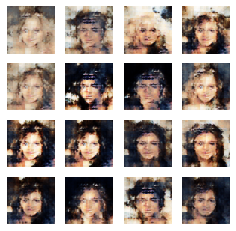

Epoch 7210, Discriminator: Loss: 0.12154743075370789 Accuracy: 0.982421875, Generator Loss: 5.677666664123535, Time: 2513.862561941147
Epoch 7220, Discriminator: Loss: 0.13980173831805587 Accuracy: 0.982421875, Generator Loss: 7.096803665161133, Time: 2517.2352001667023
Epoch 7230, Discriminator: Loss: 0.0925238560885191 Accuracy: 0.984375, Generator Loss: 5.731616497039795, Time: 2520.6052091121674
Epoch 7240, Discriminator: Loss: 0.1575155216269195 Accuracy: 0.974609375, Generator Loss: 6.70196533203125, Time: 2523.9827122688293
Epoch 7250, Discriminator: Loss: 0.1057671457529068 Accuracy: 0.982421875, Generator Loss: 6.148515224456787, Time: 2527.361458301544
Epoch 7260, Discriminator: Loss: 0.087338175624609 Accuracy: 0.978515625, Generator Loss: 6.061992645263672, Time: 2530.7247018814087
Epoch 7270, Discriminator: Loss: 0.11886097490787506 Accuracy: 0.978515625, Generator Loss: 5.2939453125, Time: 2534.0983707904816
Epoch 7280, Discriminator: Loss: 0.039807019755244255 Accuracy: 

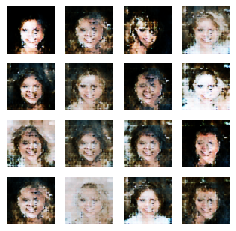

Epoch 7310, Discriminator: Loss: 0.054770831018686295 Accuracy: 0.99609375, Generator Loss: 6.334079265594482, Time: 2548.2730057239532
Epoch 7320, Discriminator: Loss: 0.053784023970365524 Accuracy: 0.9921875, Generator Loss: 5.772466659545898, Time: 2551.64879488945
Epoch 7330, Discriminator: Loss: 0.08533946424722672 Accuracy: 0.98828125, Generator Loss: 5.831847190856934, Time: 2555.019833087921
Epoch 7340, Discriminator: Loss: 0.09090770035982132 Accuracy: 0.986328125, Generator Loss: 6.26511287689209, Time: 2558.385617494583
Epoch 7350, Discriminator: Loss: 0.11400006711483002 Accuracy: 0.986328125, Generator Loss: 5.710372447967529, Time: 2561.751903295517
Epoch 7360, Discriminator: Loss: 0.07239940762519836 Accuracy: 0.9921875, Generator Loss: 5.859306335449219, Time: 2565.105180501938
Epoch 7370, Discriminator: Loss: 0.09570711478590965 Accuracy: 0.986328125, Generator Loss: 6.57959508895874, Time: 2568.471757888794
Epoch 7380, Discriminator: Loss: 0.05711621791124344 Accuracy

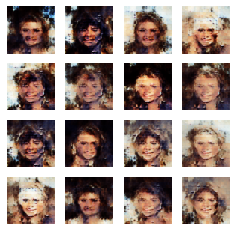

Epoch 7410, Discriminator: Loss: 0.05569119565188885 Accuracy: 0.9921875, Generator Loss: 5.846704483032227, Time: 2582.9386496543884
Epoch 7420, Discriminator: Loss: 0.22724733501672745 Accuracy: 0.962890625, Generator Loss: 7.969669818878174, Time: 2586.3250811100006
Epoch 7430, Discriminator: Loss: 0.05983658879995346 Accuracy: 0.9921875, Generator Loss: 5.9052348136901855, Time: 2589.684007167816
Epoch 7440, Discriminator: Loss: 0.11198567599058151 Accuracy: 0.982421875, Generator Loss: 7.099375247955322, Time: 2593.042671442032
Epoch 7450, Discriminator: Loss: 0.6188750267028809 Accuracy: 0.865234375, Generator Loss: 12.300021171569824, Time: 2596.3990471363068
Epoch 7460, Discriminator: Loss: 0.09689144790172577 Accuracy: 0.986328125, Generator Loss: 5.374935150146484, Time: 2599.7441172599792
Epoch 7470, Discriminator: Loss: 0.44960029795765877 Accuracy: 0.91796875, Generator Loss: 4.5870771408081055, Time: 2603.112924337387
Epoch 7480, Discriminator: Loss: 0.10180020704865456 A

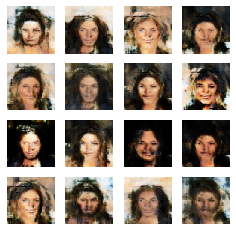

Epoch 7510, Discriminator: Loss: 0.1834656372666359 Accuracy: 0.96875, Generator Loss: 4.953282833099365, Time: 2617.3074235916138
Epoch 7520, Discriminator: Loss: 0.13024693727493286 Accuracy: 0.978515625, Generator Loss: 5.616117000579834, Time: 2620.6661505699158
Epoch 7530, Discriminator: Loss: 0.12986908853054047 Accuracy: 0.98046875, Generator Loss: 6.019608497619629, Time: 2624.044449329376
Epoch 7540, Discriminator: Loss: 0.11146144941449165 Accuracy: 0.984375, Generator Loss: 5.847137451171875, Time: 2627.4184970855713
Epoch 7550, Discriminator: Loss: 0.08035498484969139 Accuracy: 0.9921875, Generator Loss: 5.648513317108154, Time: 2630.794209718704
Epoch 7560, Discriminator: Loss: 0.14255061000585556 Accuracy: 0.984375, Generator Loss: 5.692389011383057, Time: 2634.155977010727
Epoch 7570, Discriminator: Loss: 0.10164998471736908 Accuracy: 0.984375, Generator Loss: 5.672813415527344, Time: 2637.5376210212708
Epoch 7580, Discriminator: Loss: 0.127452552318573 Accuracy: 0.98828

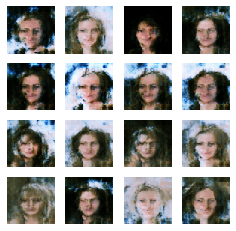

Epoch 7610, Discriminator: Loss: 0.09673115983605385 Accuracy: 0.98046875, Generator Loss: 6.143733024597168, Time: 2651.7491822242737
Epoch 7620, Discriminator: Loss: 0.07041520439088345 Accuracy: 0.98828125, Generator Loss: 5.7189435958862305, Time: 2655.109646320343
Epoch 7630, Discriminator: Loss: 0.23731882497668266 Accuracy: 0.951171875, Generator Loss: 5.04768705368042, Time: 2658.481685400009
Epoch 7640, Discriminator: Loss: 0.1583687998354435 Accuracy: 0.970703125, Generator Loss: 6.130467891693115, Time: 2661.844213485718
Epoch 7650, Discriminator: Loss: 0.15620162710547447 Accuracy: 0.96875, Generator Loss: 5.704129695892334, Time: 2665.2070422172546
Epoch 7660, Discriminator: Loss: 0.06922634318470955 Accuracy: 0.9921875, Generator Loss: 6.383720874786377, Time: 2668.5780153274536
Epoch 7670, Discriminator: Loss: 0.08141586743295193 Accuracy: 0.984375, Generator Loss: 6.726202011108398, Time: 2671.9597532749176
Epoch 7680, Discriminator: Loss: 0.08461506105959415 Accuracy: 

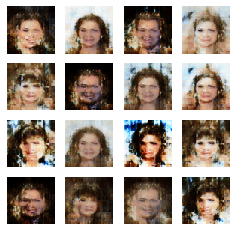

Epoch 7710, Discriminator: Loss: 0.19027990847826004 Accuracy: 0.970703125, Generator Loss: 6.072389125823975, Time: 2686.484647989273
Epoch 7720, Discriminator: Loss: 0.05375833250582218 Accuracy: 0.998046875, Generator Loss: 6.213068962097168, Time: 2689.8850049972534
Epoch 7730, Discriminator: Loss: 0.138225719332695 Accuracy: 0.970703125, Generator Loss: 6.846365928649902, Time: 2693.261905670166
Epoch 7740, Discriminator: Loss: 0.09053439274430275 Accuracy: 0.978515625, Generator Loss: 6.488659381866455, Time: 2696.6486263275146
Epoch 7750, Discriminator: Loss: 0.11567087844014168 Accuracy: 0.9765625, Generator Loss: 6.404955863952637, Time: 2700.0366983413696
Epoch 7760, Discriminator: Loss: 0.08920959755778313 Accuracy: 0.986328125, Generator Loss: 8.9985990524292, Time: 2703.4114146232605
Epoch 7770, Discriminator: Loss: 0.06168782152235508 Accuracy: 0.9921875, Generator Loss: 6.0205278396606445, Time: 2706.7867243289948
Epoch 7780, Discriminator: Loss: 0.19823449105024338 Accu

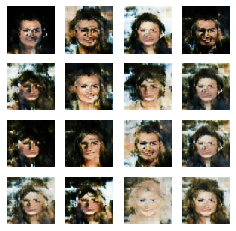

Epoch 7810, Discriminator: Loss: 0.1926947981119156 Accuracy: 0.974609375, Generator Loss: 6.163856029510498, Time: 2721.0364928245544
Epoch 7820, Discriminator: Loss: 0.1579521894454956 Accuracy: 0.966796875, Generator Loss: 6.909328937530518, Time: 2724.4242310523987
Epoch 7830, Discriminator: Loss: 0.027435632422566414 Accuracy: 0.99609375, Generator Loss: 6.534618854522705, Time: 2727.800298690796
Epoch 7840, Discriminator: Loss: 0.14243876934051514 Accuracy: 0.98046875, Generator Loss: 7.957977771759033, Time: 2731.174885034561
Epoch 7850, Discriminator: Loss: 0.062216298654675484 Accuracy: 0.994140625, Generator Loss: 5.668526649475098, Time: 2734.5637741088867
Epoch 7860, Discriminator: Loss: 0.23027023673057556 Accuracy: 0.96875, Generator Loss: 7.032259941101074, Time: 2737.937028646469
Epoch 7870, Discriminator: Loss: 0.11593272164463997 Accuracy: 0.978515625, Generator Loss: 5.383818626403809, Time: 2741.3278489112854
Epoch 7880, Discriminator: Loss: 0.23792480677366257 Accu

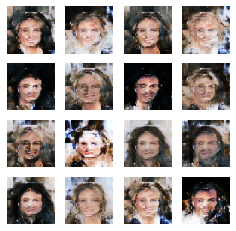

Epoch 7910, Discriminator: Loss: 0.1255573183298111 Accuracy: 0.974609375, Generator Loss: 6.814327239990234, Time: 2755.6679084300995
Epoch 7920, Discriminator: Loss: 0.03815131261944771 Accuracy: 0.9921875, Generator Loss: 5.700779914855957, Time: 2759.0476126670837
Epoch 7930, Discriminator: Loss: 0.20326875383034348 Accuracy: 0.95703125, Generator Loss: 7.149158954620361, Time: 2762.4254043102264
Epoch 7940, Discriminator: Loss: 0.07921322621405125 Accuracy: 0.986328125, Generator Loss: 6.173929214477539, Time: 2765.792529821396
Epoch 7950, Discriminator: Loss: 1.4778660982847214 Accuracy: 0.8203125, Generator Loss: 4.2395219802856445, Time: 2769.1691575050354
Epoch 7960, Discriminator: Loss: 0.04825493507087231 Accuracy: 0.994140625, Generator Loss: 5.889006614685059, Time: 2772.5527715682983
Epoch 7970, Discriminator: Loss: 0.12063306197524071 Accuracy: 0.98046875, Generator Loss: 5.202131748199463, Time: 2775.9345619678497
Epoch 7980, Discriminator: Loss: 0.14492610841989517 Acc

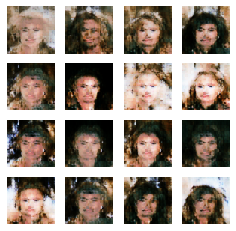

Epoch 8010, Discriminator: Loss: 0.046059396117925644 Accuracy: 0.998046875, Generator Loss: 5.8174591064453125, Time: 2790.145022392273
Epoch 8020, Discriminator: Loss: 0.04209917411208153 Accuracy: 0.994140625, Generator Loss: 6.05184268951416, Time: 2793.521184682846
Epoch 8030, Discriminator: Loss: 0.049994345754384995 Accuracy: 0.9921875, Generator Loss: 6.725937843322754, Time: 2796.8965916633606
Epoch 8040, Discriminator: Loss: 1.973934450186789 Accuracy: 0.73828125, Generator Loss: 5.0869669914245605, Time: 2800.2620174884796
Epoch 8050, Discriminator: Loss: 0.2859729826450348 Accuracy: 0.96484375, Generator Loss: 4.25200891494751, Time: 2803.638550043106
Epoch 8060, Discriminator: Loss: 0.49105826020240784 Accuracy: 0.892578125, Generator Loss: 4.779942989349365, Time: 2807.003219604492
Epoch 8070, Discriminator: Loss: 0.2546706199645996 Accuracy: 0.955078125, Generator Loss: 4.18898344039917, Time: 2810.3748614788055
Epoch 8080, Discriminator: Loss: 0.18840184062719345 Accura

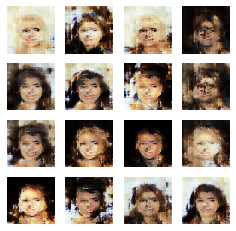

Epoch 8110, Discriminator: Loss: 0.17123205959796906 Accuracy: 0.974609375, Generator Loss: 5.206550598144531, Time: 2824.8402421474457
Epoch 8120, Discriminator: Loss: 0.147394597530365 Accuracy: 0.974609375, Generator Loss: 4.8303704261779785, Time: 2828.2158148288727
Epoch 8130, Discriminator: Loss: 0.1575166881084442 Accuracy: 0.974609375, Generator Loss: 5.194909572601318, Time: 2831.593485593796
Epoch 8140, Discriminator: Loss: 0.10431614518165588 Accuracy: 0.982421875, Generator Loss: 5.369297981262207, Time: 2834.976853132248
Epoch 8150, Discriminator: Loss: 0.2188383936882019 Accuracy: 0.958984375, Generator Loss: 5.560723304748535, Time: 2838.3547670841217
Epoch 8160, Discriminator: Loss: 0.18812453746795654 Accuracy: 0.974609375, Generator Loss: 5.076724529266357, Time: 2841.7187616825104
Epoch 8170, Discriminator: Loss: 0.1169208288192749 Accuracy: 0.9765625, Generator Loss: 5.543426990509033, Time: 2845.103085756302
Epoch 8180, Discriminator: Loss: 0.051692087203264236 Acc

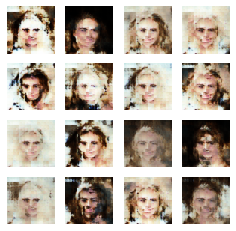

Epoch 8210, Discriminator: Loss: 0.11940514668822289 Accuracy: 0.982421875, Generator Loss: 6.1025309562683105, Time: 2859.3322343826294
Epoch 8220, Discriminator: Loss: 0.11138485092669725 Accuracy: 0.98046875, Generator Loss: 5.790761947631836, Time: 2862.707328557968
Epoch 8230, Discriminator: Loss: 0.19953789561986923 Accuracy: 0.9609375, Generator Loss: 5.8473944664001465, Time: 2866.104487657547
Epoch 8240, Discriminator: Loss: 0.14871914684772491 Accuracy: 0.982421875, Generator Loss: 6.2048020362854, Time: 2869.473988056183
Epoch 8250, Discriminator: Loss: 0.11214705929160118 Accuracy: 0.986328125, Generator Loss: 5.355767726898193, Time: 2872.852176427841
Epoch 8260, Discriminator: Loss: 0.08074867352843285 Accuracy: 0.982421875, Generator Loss: 5.883875846862793, Time: 2876.251373529434
Epoch 8270, Discriminator: Loss: 0.15229471772909164 Accuracy: 0.97265625, Generator Loss: 5.50908088684082, Time: 2879.6673815250397
Epoch 8280, Discriminator: Loss: 0.17048310488462448 Accur

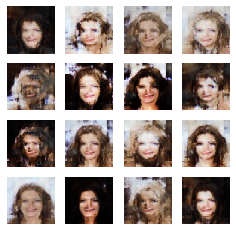

Epoch 8310, Discriminator: Loss: 0.10978149622678757 Accuracy: 0.984375, Generator Loss: 5.594022274017334, Time: 2893.9065551757812
Epoch 8320, Discriminator: Loss: 0.06266050785779953 Accuracy: 0.986328125, Generator Loss: 6.9953155517578125, Time: 2897.307875394821
Epoch 8330, Discriminator: Loss: 0.2552258223295212 Accuracy: 0.955078125, Generator Loss: 7.249180316925049, Time: 2900.6975603103638
Epoch 8340, Discriminator: Loss: 0.056039560586214066 Accuracy: 0.99609375, Generator Loss: 6.265984535217285, Time: 2904.0686893463135
Epoch 8350, Discriminator: Loss: 0.426254503428936 Accuracy: 0.904296875, Generator Loss: 11.402665138244629, Time: 2907.442746400833
Epoch 8360, Discriminator: Loss: 0.09420281648635864 Accuracy: 0.986328125, Generator Loss: 4.681601524353027, Time: 2910.8032891750336
Epoch 8370, Discriminator: Loss: 0.09223433583974838 Accuracy: 0.986328125, Generator Loss: 5.416939735412598, Time: 2914.1744389533997
Epoch 8380, Discriminator: Loss: 0.2380499467253685 Ac

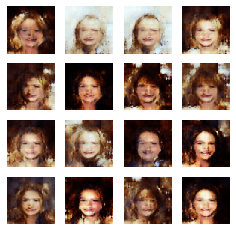

Epoch 8410, Discriminator: Loss: 0.1416974514722824 Accuracy: 0.974609375, Generator Loss: 5.649868965148926, Time: 2928.625590324402
Epoch 8420, Discriminator: Loss: 0.10719970241189003 Accuracy: 0.984375, Generator Loss: 6.2099385261535645, Time: 2932.021372318268
Epoch 8430, Discriminator: Loss: 0.14483455568552017 Accuracy: 0.9765625, Generator Loss: 6.072479724884033, Time: 2935.3901002407074
Epoch 8440, Discriminator: Loss: 0.07798827439546585 Accuracy: 0.98828125, Generator Loss: 5.800230026245117, Time: 2938.7698328495026
Epoch 8450, Discriminator: Loss: 0.11964640393853188 Accuracy: 0.978515625, Generator Loss: 5.984111309051514, Time: 2942.149202823639
Epoch 8460, Discriminator: Loss: 0.1945130005478859 Accuracy: 0.96875, Generator Loss: 5.892193794250488, Time: 2945.508297920227
Epoch 8470, Discriminator: Loss: 0.22104022651910782 Accuracy: 0.96484375, Generator Loss: 6.217378616333008, Time: 2948.8812346458435
Epoch 8480, Discriminator: Loss: 0.1425378993153572 Accuracy: 0.

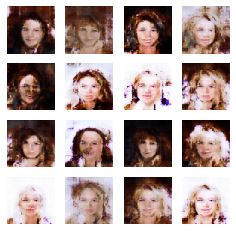

Epoch 8510, Discriminator: Loss: 0.1564282774925232 Accuracy: 0.96484375, Generator Loss: 5.87336540222168, Time: 2963.085150718689
Epoch 8520, Discriminator: Loss: 0.18027222156524658 Accuracy: 0.96875, Generator Loss: 8.063014030456543, Time: 2966.4521107673645
Epoch 8530, Discriminator: Loss: 0.0803503654897213 Accuracy: 0.986328125, Generator Loss: 5.815196514129639, Time: 2969.8255236148834
Epoch 8540, Discriminator: Loss: 0.05285998061299324 Accuracy: 0.994140625, Generator Loss: 6.330849647521973, Time: 2973.190975189209
Epoch 8550, Discriminator: Loss: 0.063805241137743 Accuracy: 0.98828125, Generator Loss: 5.923691749572754, Time: 2976.56556725502
Epoch 8560, Discriminator: Loss: 0.09601519629359245 Accuracy: 0.990234375, Generator Loss: 5.728352069854736, Time: 2979.920024394989
Epoch 8570, Discriminator: Loss: 0.05758427828550339 Accuracy: 0.994140625, Generator Loss: 5.654938220977783, Time: 2983.3097960948944
Epoch 8580, Discriminator: Loss: 0.19021043367683887 Accuracy: 0

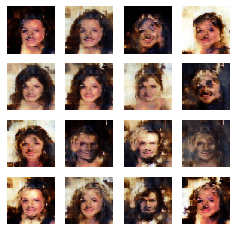

Epoch 8610, Discriminator: Loss: 0.4560197740793228 Accuracy: 0.912109375, Generator Loss: 6.266704082489014, Time: 2997.5669560432434
Epoch 8620, Discriminator: Loss: 0.058797175996005535 Accuracy: 0.98828125, Generator Loss: 6.291921615600586, Time: 3000.941343307495
Epoch 8630, Discriminator: Loss: 0.21743575483560562 Accuracy: 0.958984375, Generator Loss: 8.770133018493652, Time: 3004.3108656406403
Epoch 8640, Discriminator: Loss: 0.060017697513103485 Accuracy: 0.994140625, Generator Loss: 6.116151332855225, Time: 3007.6850225925446
Epoch 8650, Discriminator: Loss: 0.08338485285639763 Accuracy: 0.990234375, Generator Loss: 6.09769344329834, Time: 3011.073506116867
Epoch 8660, Discriminator: Loss: 0.04582708142697811 Accuracy: 0.99609375, Generator Loss: 6.191857814788818, Time: 3014.429451227188
Epoch 8670, Discriminator: Loss: 0.09546852111816406 Accuracy: 0.986328125, Generator Loss: 6.6445722579956055, Time: 3017.780680179596
Epoch 8680, Discriminator: Loss: 0.13042922038584948 

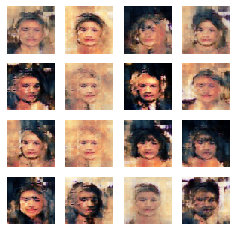

Epoch 8710, Discriminator: Loss: 0.14035103470087051 Accuracy: 0.982421875, Generator Loss: 6.983182430267334, Time: 3032.239445209503
Epoch 8720, Discriminator: Loss: 0.12702961638569832 Accuracy: 0.978515625, Generator Loss: 6.669255256652832, Time: 3035.6086184978485
Epoch 8730, Discriminator: Loss: 0.28346113860607147 Accuracy: 0.95703125, Generator Loss: 6.174039363861084, Time: 3038.986179113388
Epoch 8740, Discriminator: Loss: 0.16849742829799652 Accuracy: 0.98046875, Generator Loss: 5.520907402038574, Time: 3042.3561561107635
Epoch 8750, Discriminator: Loss: 0.16450537741184235 Accuracy: 0.97265625, Generator Loss: 5.974545001983643, Time: 3045.726907968521
Epoch 8760, Discriminator: Loss: 0.06867000088095665 Accuracy: 0.9921875, Generator Loss: 6.270329475402832, Time: 3049.0852608680725
Epoch 8770, Discriminator: Loss: 0.17732945457100868 Accuracy: 0.974609375, Generator Loss: 7.563321113586426, Time: 3052.457223176956
Epoch 8780, Discriminator: Loss: 0.11031946912407875 Accu

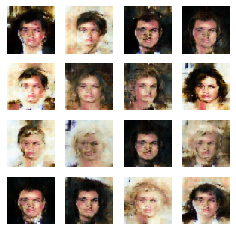

Epoch 8810, Discriminator: Loss: 0.09008662775158882 Accuracy: 0.994140625, Generator Loss: 5.499325752258301, Time: 3066.7498412132263
Epoch 8820, Discriminator: Loss: 0.14633119851350784 Accuracy: 0.9765625, Generator Loss: 6.875699043273926, Time: 3070.1167027950287
Epoch 8830, Discriminator: Loss: 0.05451632849872112 Accuracy: 0.99609375, Generator Loss: 5.983917236328125, Time: 3073.4891238212585
Epoch 8840, Discriminator: Loss: 0.09211058355867863 Accuracy: 0.978515625, Generator Loss: 5.834615707397461, Time: 3076.8650987148285
Epoch 8850, Discriminator: Loss: 0.047986848279833794 Accuracy: 0.994140625, Generator Loss: 6.115793704986572, Time: 3080.2289593219757
Epoch 8860, Discriminator: Loss: 0.09189808741211891 Accuracy: 0.982421875, Generator Loss: 7.154465198516846, Time: 3083.591744661331
Epoch 8870, Discriminator: Loss: 0.12915445864200592 Accuracy: 0.984375, Generator Loss: 5.813066482543945, Time: 3086.9752476215363
Epoch 8880, Discriminator: Loss: 0.3027624636888504 Ac

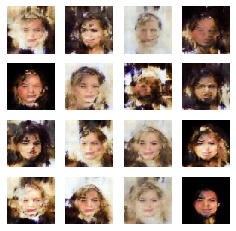

Epoch 8910, Discriminator: Loss: 0.07027331367135048 Accuracy: 0.994140625, Generator Loss: 5.899015426635742, Time: 3101.2104666233063
Epoch 8920, Discriminator: Loss: 0.09975216165184975 Accuracy: 0.978515625, Generator Loss: 7.348773956298828, Time: 3104.5800547599792
Epoch 8930, Discriminator: Loss: 0.17334122210741043 Accuracy: 0.96484375, Generator Loss: 7.662564277648926, Time: 3107.9592990875244
Epoch 8940, Discriminator: Loss: 0.09392656199634075 Accuracy: 0.982421875, Generator Loss: 5.8988823890686035, Time: 3111.323893070221
Epoch 8950, Discriminator: Loss: 0.10947742313146591 Accuracy: 0.982421875, Generator Loss: 6.298704624176025, Time: 3114.716344833374
Epoch 8960, Discriminator: Loss: 0.12159513309597969 Accuracy: 0.978515625, Generator Loss: 6.2753071784973145, Time: 3118.080552339554
Epoch 8970, Discriminator: Loss: 0.08507918007671833 Accuracy: 0.990234375, Generator Loss: 6.401113033294678, Time: 3121.453225374222
Epoch 8980, Discriminator: Loss: 0.1478411061689257

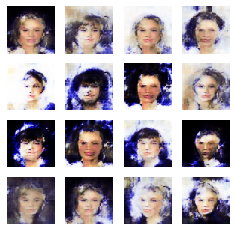

Epoch 9010, Discriminator: Loss: 1.795271348208189 Accuracy: 0.69140625, Generator Loss: 2.9794349670410156, Time: 3135.6568484306335
Epoch 9020, Discriminator: Loss: 0.38457727432250977 Accuracy: 0.9375, Generator Loss: 4.523003578186035, Time: 3139.032749414444
Epoch 9030, Discriminator: Loss: 0.49837788939476013 Accuracy: 0.908203125, Generator Loss: 4.479186534881592, Time: 3142.405556678772
Epoch 9040, Discriminator: Loss: 0.21731840819120407 Accuracy: 0.970703125, Generator Loss: 4.290003299713135, Time: 3145.775795698166
Epoch 9050, Discriminator: Loss: 0.2619663029909134 Accuracy: 0.95703125, Generator Loss: 4.205480098724365, Time: 3149.1437664031982
Epoch 9060, Discriminator: Loss: 0.1973942592740059 Accuracy: 0.97265625, Generator Loss: 4.33339786529541, Time: 3152.5143780708313
Epoch 9070, Discriminator: Loss: 0.14286300167441368 Accuracy: 0.98046875, Generator Loss: 4.411518573760986, Time: 3155.8976809978485
Epoch 9080, Discriminator: Loss: 0.22864027321338654 Accuracy: 0

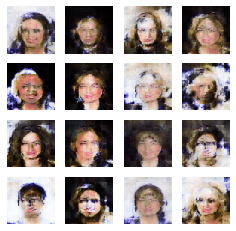

Epoch 9110, Discriminator: Loss: 0.1182478778064251 Accuracy: 0.9765625, Generator Loss: 5.240562915802002, Time: 3170.433254957199
Epoch 9120, Discriminator: Loss: 0.14600476622581482 Accuracy: 0.98046875, Generator Loss: 5.308954238891602, Time: 3173.8106009960175
Epoch 9130, Discriminator: Loss: 0.14008759707212448 Accuracy: 0.984375, Generator Loss: 5.131874084472656, Time: 3177.1859991550446
Epoch 9140, Discriminator: Loss: 0.06552862375974655 Accuracy: 0.994140625, Generator Loss: 5.5348801612854, Time: 3180.5573790073395
Epoch 9150, Discriminator: Loss: 0.10921536013484001 Accuracy: 0.978515625, Generator Loss: 5.159831523895264, Time: 3183.9730308055878
Epoch 9160, Discriminator: Loss: 0.20626267790794373 Accuracy: 0.962890625, Generator Loss: 5.688614845275879, Time: 3187.3826756477356
Epoch 9170, Discriminator: Loss: 0.17973972856998444 Accuracy: 0.966796875, Generator Loss: 5.17818021774292, Time: 3190.7604138851166
Epoch 9180, Discriminator: Loss: 0.16032786667346954 Accura

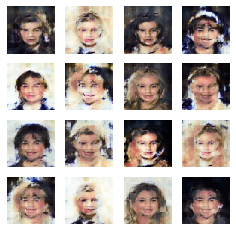

Epoch 9210, Discriminator: Loss: 0.17401347309350967 Accuracy: 0.974609375, Generator Loss: 5.838484287261963, Time: 3204.992187023163
Epoch 9220, Discriminator: Loss: 0.1278604418039322 Accuracy: 0.984375, Generator Loss: 5.041556358337402, Time: 3208.368349790573
Epoch 9230, Discriminator: Loss: 0.1434287503361702 Accuracy: 0.970703125, Generator Loss: 5.502644062042236, Time: 3211.7416083812714
Epoch 9240, Discriminator: Loss: 0.22414854913949966 Accuracy: 0.958984375, Generator Loss: 5.5162882804870605, Time: 3215.1196343898773
Epoch 9250, Discriminator: Loss: 0.1455315351486206 Accuracy: 0.98046875, Generator Loss: 5.324456214904785, Time: 3218.509079694748
Epoch 9260, Discriminator: Loss: 0.1164608746767044 Accuracy: 0.982421875, Generator Loss: 5.045739650726318, Time: 3221.8771851062775
Epoch 9270, Discriminator: Loss: 0.12287076935172081 Accuracy: 0.982421875, Generator Loss: 5.276009559631348, Time: 3225.2464728355408
Epoch 9280, Discriminator: Loss: 0.18996120989322662 Accur

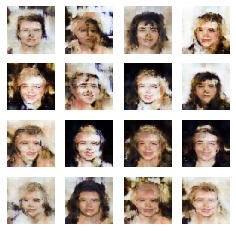

Epoch 9310, Discriminator: Loss: 0.11137288436293602 Accuracy: 0.984375, Generator Loss: 5.3641862869262695, Time: 3239.457234144211
Epoch 9320, Discriminator: Loss: 0.12093224748969078 Accuracy: 0.982421875, Generator Loss: 6.042000770568848, Time: 3242.8396756649017
Epoch 9330, Discriminator: Loss: 0.09357556328177452 Accuracy: 0.986328125, Generator Loss: 5.240793228149414, Time: 3246.205744743347
Epoch 9340, Discriminator: Loss: 0.08955777063965797 Accuracy: 0.98828125, Generator Loss: 5.20327615737915, Time: 3249.5900988578796
Epoch 9350, Discriminator: Loss: 0.12823225185275078 Accuracy: 0.978515625, Generator Loss: 5.385378837585449, Time: 3252.99357008934
Epoch 9360, Discriminator: Loss: 0.1043737567961216 Accuracy: 0.978515625, Generator Loss: 5.408544063568115, Time: 3256.3736686706543
Epoch 9370, Discriminator: Loss: 0.10295975767076015 Accuracy: 0.984375, Generator Loss: 6.560473918914795, Time: 3259.7669594287872
Epoch 9380, Discriminator: Loss: 0.15154218673706055 Accurac

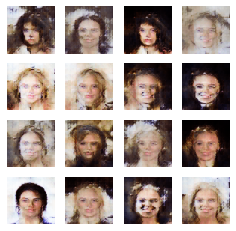

Epoch 9410, Discriminator: Loss: 0.10079093649983406 Accuracy: 0.986328125, Generator Loss: 5.834196090698242, Time: 3274.239467859268
Epoch 9420, Discriminator: Loss: 0.10016864165663719 Accuracy: 0.978515625, Generator Loss: 5.358499526977539, Time: 3277.640218257904
Epoch 9430, Discriminator: Loss: 0.19766805320978165 Accuracy: 0.96484375, Generator Loss: 5.495975494384766, Time: 3281.021853208542
Epoch 9440, Discriminator: Loss: 0.1517195887863636 Accuracy: 0.974609375, Generator Loss: 5.6902618408203125, Time: 3284.3998036384583
Epoch 9450, Discriminator: Loss: 0.17711354047060013 Accuracy: 0.970703125, Generator Loss: 5.436495780944824, Time: 3287.773396253586
Epoch 9460, Discriminator: Loss: 0.12205719947814941 Accuracy: 0.98046875, Generator Loss: 6.111710071563721, Time: 3291.141445875168
Epoch 9470, Discriminator: Loss: 0.06362350098788738 Accuracy: 0.994140625, Generator Loss: 6.527573108673096, Time: 3294.5208163261414
Epoch 9480, Discriminator: Loss: 0.1480994038283825 Acc

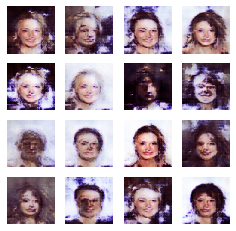

Epoch 9510, Discriminator: Loss: 0.1847270643338561 Accuracy: 0.9609375, Generator Loss: 5.809416770935059, Time: 3308.8100402355194
Epoch 9520, Discriminator: Loss: 0.1235966645181179 Accuracy: 0.982421875, Generator Loss: 5.5430426597595215, Time: 3312.1885821819305
Epoch 9530, Discriminator: Loss: 0.0848427526652813 Accuracy: 0.984375, Generator Loss: 5.524180889129639, Time: 3315.5719487667084
Epoch 9540, Discriminator: Loss: 0.15337467938661575 Accuracy: 0.9765625, Generator Loss: 6.238537311553955, Time: 3318.9620208740234
Epoch 9550, Discriminator: Loss: 0.1464547999203205 Accuracy: 0.978515625, Generator Loss: 6.289993762969971, Time: 3322.347431898117
Epoch 9560, Discriminator: Loss: 0.2152869999408722 Accuracy: 0.955078125, Generator Loss: 6.186857223510742, Time: 3325.7182488441467
Epoch 9570, Discriminator: Loss: 0.1224534660577774 Accuracy: 0.986328125, Generator Loss: 5.708924293518066, Time: 3329.100140810013
Epoch 9580, Discriminator: Loss: 0.12177800759673119 Accuracy:

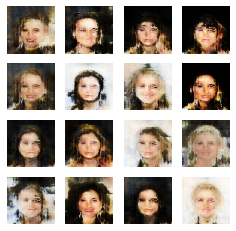

Epoch 9610, Discriminator: Loss: 0.17946340888738632 Accuracy: 0.966796875, Generator Loss: 5.3805832862854, Time: 3343.336006164551
Epoch 9620, Discriminator: Loss: 0.15444190800189972 Accuracy: 0.98046875, Generator Loss: 5.411060810089111, Time: 3346.715495109558
Epoch 9630, Discriminator: Loss: 0.1417420133948326 Accuracy: 0.98046875, Generator Loss: 5.973546028137207, Time: 3350.0953018665314
Epoch 9640, Discriminator: Loss: 0.17884033918380737 Accuracy: 0.974609375, Generator Loss: 6.26302433013916, Time: 3353.467738866806
Epoch 9650, Discriminator: Loss: 0.33698604442179203 Accuracy: 0.94140625, Generator Loss: 5.428868770599365, Time: 3356.864066839218
Epoch 9660, Discriminator: Loss: 0.12931110337376595 Accuracy: 0.9765625, Generator Loss: 5.354024410247803, Time: 3360.2206666469574
Epoch 9670, Discriminator: Loss: 0.14823036268353462 Accuracy: 0.978515625, Generator Loss: 5.496332168579102, Time: 3363.5881769657135
Epoch 9680, Discriminator: Loss: 0.1050749197602272 Accuracy:

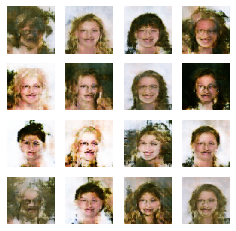

Epoch 9710, Discriminator: Loss: 0.17207005620002747 Accuracy: 0.96875, Generator Loss: 5.65294075012207, Time: 3378.1969010829926
Epoch 9720, Discriminator: Loss: 0.1361493282020092 Accuracy: 0.98046875, Generator Loss: 6.143864154815674, Time: 3381.590709209442
Epoch 9730, Discriminator: Loss: 0.08174454979598522 Accuracy: 0.982421875, Generator Loss: 6.957301616668701, Time: 3384.9790408611298
Epoch 9740, Discriminator: Loss: 0.08841738104820251 Accuracy: 0.982421875, Generator Loss: 6.6292901039123535, Time: 3388.3477215766907
Epoch 9750, Discriminator: Loss: 0.09580949321389198 Accuracy: 0.986328125, Generator Loss: 5.799728870391846, Time: 3391.7267532348633
Epoch 9760, Discriminator: Loss: 0.17521020025014877 Accuracy: 0.974609375, Generator Loss: 5.35667610168457, Time: 3395.092892885208
Epoch 9770, Discriminator: Loss: 0.17632976919412613 Accuracy: 0.96484375, Generator Loss: 6.151205539703369, Time: 3398.4663829803467
Epoch 9780, Discriminator: Loss: 0.1442176289856434 Accura

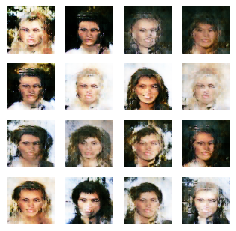

Epoch 9810, Discriminator: Loss: 0.20454014837741852 Accuracy: 0.966796875, Generator Loss: 6.567524433135986, Time: 3412.714922428131
Epoch 9820, Discriminator: Loss: 0.13184276968240738 Accuracy: 0.9765625, Generator Loss: 6.182705879211426, Time: 3416.1124024391174
Epoch 9830, Discriminator: Loss: 0.1639980971813202 Accuracy: 0.97265625, Generator Loss: 7.055209159851074, Time: 3419.485966205597
Epoch 9840, Discriminator: Loss: 0.09127578139305115 Accuracy: 0.98828125, Generator Loss: 6.0843048095703125, Time: 3422.857144832611
Epoch 9850, Discriminator: Loss: 0.1251242235302925 Accuracy: 0.97265625, Generator Loss: 5.753973007202148, Time: 3426.237403154373
Epoch 9860, Discriminator: Loss: 0.1850917935371399 Accuracy: 0.96484375, Generator Loss: 6.925930500030518, Time: 3429.6048736572266
Epoch 9870, Discriminator: Loss: 0.10575705021619797 Accuracy: 0.984375, Generator Loss: 5.377141952514648, Time: 3432.9924037456512
Epoch 9880, Discriminator: Loss: 0.11059999093413353 Accuracy: 

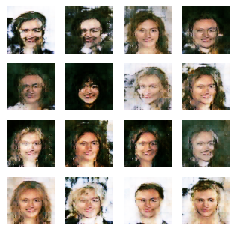

Epoch 9910, Discriminator: Loss: 0.05568603053689003 Accuracy: 0.9921875, Generator Loss: 6.600793361663818, Time: 3447.24467754364
Epoch 9920, Discriminator: Loss: 0.06362804397940636 Accuracy: 0.9921875, Generator Loss: 6.626555442810059, Time: 3450.6290011405945
Epoch 9930, Discriminator: Loss: 0.08833838999271393 Accuracy: 0.990234375, Generator Loss: 6.707483768463135, Time: 3453.97615647316
Epoch 9940, Discriminator: Loss: 0.20818551629781723 Accuracy: 0.962890625, Generator Loss: 7.0475358963012695, Time: 3457.344750881195
Epoch 9950, Discriminator: Loss: 0.11113342642784119 Accuracy: 0.982421875, Generator Loss: 5.818856239318848, Time: 3460.71378159523
Epoch 9960, Discriminator: Loss: 0.13475129008293152 Accuracy: 0.974609375, Generator Loss: 6.05972146987915, Time: 3464.089827775955
Epoch 9970, Discriminator: Loss: 0.1676844097673893 Accuracy: 0.966796875, Generator Loss: 5.580386638641357, Time: 3467.476500272751
Epoch 9980, Discriminator: Loss: 0.15508755296468735 Accuracy:

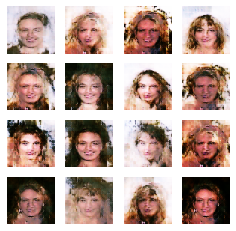

Epoch 10010, Discriminator: Loss: 0.130109965801239 Accuracy: 0.982421875, Generator Loss: 6.03710412979126, Time: 3481.6881079673767
Epoch 10020, Discriminator: Loss: 0.20076575130224228 Accuracy: 0.966796875, Generator Loss: 7.838507652282715, Time: 3485.079188108444
Epoch 10030, Discriminator: Loss: 0.18158965185284615 Accuracy: 0.970703125, Generator Loss: 7.177187919616699, Time: 3488.4876017570496
Epoch 10040, Discriminator: Loss: 0.12693597376346588 Accuracy: 0.984375, Generator Loss: 6.190099716186523, Time: 3491.9037857055664
Epoch 10050, Discriminator: Loss: 0.1260625645518303 Accuracy: 0.984375, Generator Loss: 5.5414276123046875, Time: 3495.302358150482
Epoch 10060, Discriminator: Loss: 0.13738963752985 Accuracy: 0.974609375, Generator Loss: 6.366696357727051, Time: 3498.6831748485565
Epoch 10070, Discriminator: Loss: 0.08783979527652264 Accuracy: 0.984375, Generator Loss: 6.416952133178711, Time: 3502.069655895233
Epoch 10080, Discriminator: Loss: 0.16837861575186253 Accur

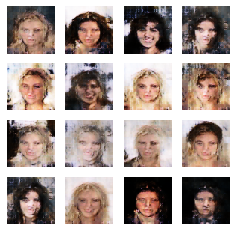

Epoch 10110, Discriminator: Loss: 0.14504988864064217 Accuracy: 0.97265625, Generator Loss: 5.97166109085083, Time: 3516.6054122447968
Epoch 10120, Discriminator: Loss: 0.16534284502267838 Accuracy: 0.974609375, Generator Loss: 6.5303754806518555, Time: 3519.9926953315735
Epoch 10130, Discriminator: Loss: 0.1250757873058319 Accuracy: 0.978515625, Generator Loss: 5.935130596160889, Time: 3523.362524032593
Epoch 10140, Discriminator: Loss: 0.0898205116391182 Accuracy: 0.986328125, Generator Loss: 6.1951093673706055, Time: 3526.7486979961395
Epoch 10150, Discriminator: Loss: 0.22156493365764618 Accuracy: 0.955078125, Generator Loss: 9.202546119689941, Time: 3530.138601541519
Epoch 10160, Discriminator: Loss: 0.11703004315495491 Accuracy: 0.978515625, Generator Loss: 6.4862751960754395, Time: 3533.497241258621
Epoch 10170, Discriminator: Loss: 0.20199241489171982 Accuracy: 0.96484375, Generator Loss: 7.612692832946777, Time: 3536.872834444046
Epoch 10180, Discriminator: Loss: 0.22906178236

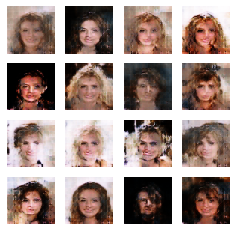

Epoch 10210, Discriminator: Loss: 0.16917859017848969 Accuracy: 0.97265625, Generator Loss: 6.185783386230469, Time: 3551.048198223114
Epoch 10220, Discriminator: Loss: 0.11431410163640976 Accuracy: 0.984375, Generator Loss: 5.953192234039307, Time: 3554.414623260498
Epoch 10230, Discriminator: Loss: 0.31172608584165573 Accuracy: 0.92578125, Generator Loss: 8.365456581115723, Time: 3557.801411151886
Epoch 10240, Discriminator: Loss: 0.08806855604052544 Accuracy: 0.9921875, Generator Loss: 6.390345573425293, Time: 3561.1796400547028
Epoch 10250, Discriminator: Loss: 0.20407068729400635 Accuracy: 0.96484375, Generator Loss: 7.202922821044922, Time: 3564.57067322731
Epoch 10260, Discriminator: Loss: 0.09251193702220917 Accuracy: 0.9921875, Generator Loss: 6.575118541717529, Time: 3567.928025484085
Epoch 10270, Discriminator: Loss: 0.06916988641023636 Accuracy: 0.98828125, Generator Loss: 6.391568660736084, Time: 3571.299248933792
Epoch 10280, Discriminator: Loss: 0.06685295701026917 Accur

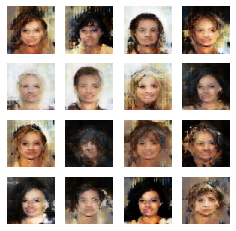

Epoch 10310, Discriminator: Loss: 0.05062118824571371 Accuracy: 0.990234375, Generator Loss: 6.835710525512695, Time: 3585.5547223091125
Epoch 10320, Discriminator: Loss: 0.08730721101164818 Accuracy: 0.986328125, Generator Loss: 6.350291728973389, Time: 3588.9265332221985
Epoch 10330, Discriminator: Loss: 0.12736457213759422 Accuracy: 0.978515625, Generator Loss: 5.87824821472168, Time: 3592.288652896881
Epoch 10340, Discriminator: Loss: 0.09218679741024971 Accuracy: 0.98828125, Generator Loss: 6.13803768157959, Time: 3595.6759214401245
Epoch 10350, Discriminator: Loss: 0.09068350866436958 Accuracy: 0.986328125, Generator Loss: 6.356715202331543, Time: 3599.0411422252655
Epoch 10360, Discriminator: Loss: 0.14419570565223694 Accuracy: 0.96875, Generator Loss: 6.327711582183838, Time: 3602.392676591873
Epoch 10370, Discriminator: Loss: 0.150000162422657 Accuracy: 0.96875, Generator Loss: 5.942837715148926, Time: 3605.75866150856
Epoch 10380, Discriminator: Loss: 0.19755865260958672 Accu

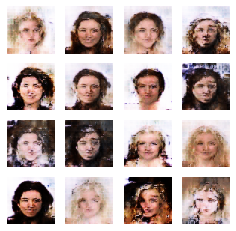

Epoch 10410, Discriminator: Loss: 0.12492946162819862 Accuracy: 0.990234375, Generator Loss: 7.183724403381348, Time: 3620.2060313224792
Epoch 10420, Discriminator: Loss: 0.3072349354624748 Accuracy: 0.951171875, Generator Loss: 5.652724742889404, Time: 3623.570233106613
Epoch 10430, Discriminator: Loss: 0.12188689410686493 Accuracy: 0.978515625, Generator Loss: 5.838601112365723, Time: 3626.9480962753296
Epoch 10440, Discriminator: Loss: 0.15907394140958786 Accuracy: 0.96875, Generator Loss: 5.988431930541992, Time: 3630.3281288146973
Epoch 10450, Discriminator: Loss: 0.09842028468847275 Accuracy: 0.982421875, Generator Loss: 5.639641761779785, Time: 3633.703373670578
Epoch 10460, Discriminator: Loss: 0.13094190135598183 Accuracy: 0.98046875, Generator Loss: 6.891846656799316, Time: 3637.068690061569
Epoch 10470, Discriminator: Loss: 0.03326818719506264 Accuracy: 0.9921875, Generator Loss: 8.0398588180542, Time: 3640.448375225067
Epoch 10480, Discriminator: Loss: 0.1000622846186161 Ac

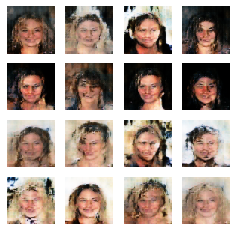

Epoch 10510, Discriminator: Loss: 0.06240078620612621 Accuracy: 0.990234375, Generator Loss: 5.543398857116699, Time: 3654.67307472229
Epoch 10520, Discriminator: Loss: 0.07117397617548704 Accuracy: 0.984375, Generator Loss: 6.287955284118652, Time: 3658.037264108658
Epoch 10530, Discriminator: Loss: 0.07314655557274818 Accuracy: 0.9921875, Generator Loss: 6.293707370758057, Time: 3661.4007091522217
Epoch 10540, Discriminator: Loss: 0.13257689774036407 Accuracy: 0.974609375, Generator Loss: 5.857629776000977, Time: 3664.7748534679413
Epoch 10550, Discriminator: Loss: 0.10670612007379532 Accuracy: 0.982421875, Generator Loss: 7.546573638916016, Time: 3668.144202709198
Epoch 10560, Discriminator: Loss: 0.10277335532009602 Accuracy: 0.982421875, Generator Loss: 9.087226867675781, Time: 3671.499021053314
Epoch 10570, Discriminator: Loss: 0.05164187774062157 Accuracy: 0.9921875, Generator Loss: 6.101814270019531, Time: 3674.8782966136932
Epoch 10580, Discriminator: Loss: 0.1108785830438137 

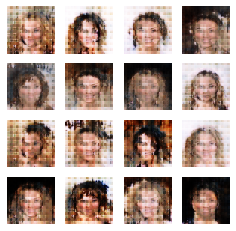

Epoch 10610, Discriminator: Loss: 0.43640563637018204 Accuracy: 0.9140625, Generator Loss: 3.7971696853637695, Time: 3689.168525457382
Epoch 10620, Discriminator: Loss: 0.2805459722876549 Accuracy: 0.953125, Generator Loss: 3.981478691101074, Time: 3692.543940782547
Epoch 10630, Discriminator: Loss: 0.47602321207523346 Accuracy: 0.8984375, Generator Loss: 4.998409271240234, Time: 3695.9260201454163
Epoch 10640, Discriminator: Loss: 0.40410807728767395 Accuracy: 0.927734375, Generator Loss: 4.9540181159973145, Time: 3699.310024023056
Epoch 10650, Discriminator: Loss: 0.2755262777209282 Accuracy: 0.947265625, Generator Loss: 4.630840301513672, Time: 3702.6879365444183
Epoch 10660, Discriminator: Loss: 0.2396048903465271 Accuracy: 0.962890625, Generator Loss: 4.65012264251709, Time: 3706.052610397339
Epoch 10670, Discriminator: Loss: 0.21222849190235138 Accuracy: 0.96484375, Generator Loss: 4.6361165046691895, Time: 3709.4157762527466
Epoch 10680, Discriminator: Loss: 0.23954850435256958 

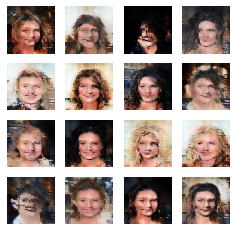

Epoch 10710, Discriminator: Loss: 0.3619206175208092 Accuracy: 0.92578125, Generator Loss: 6.998748779296875, Time: 3723.9120309352875
Epoch 10720, Discriminator: Loss: 0.19126763939857483 Accuracy: 0.962890625, Generator Loss: 5.012582302093506, Time: 3727.2942123413086
Epoch 10730, Discriminator: Loss: 0.16281745210289955 Accuracy: 0.96484375, Generator Loss: 5.383420944213867, Time: 3730.6658289432526
Epoch 10740, Discriminator: Loss: 0.2329925261437893 Accuracy: 0.94921875, Generator Loss: 4.991936683654785, Time: 3734.0446445941925
Epoch 10750, Discriminator: Loss: 0.11873387172818184 Accuracy: 0.978515625, Generator Loss: 5.272126197814941, Time: 3737.4300479888916
Epoch 10760, Discriminator: Loss: 0.19794920086860657 Accuracy: 0.962890625, Generator Loss: 5.645545482635498, Time: 3740.821246623993
Epoch 10770, Discriminator: Loss: 0.16071636974811554 Accuracy: 0.9765625, Generator Loss: 5.15708589553833, Time: 3744.198140859604
Epoch 10780, Discriminator: Loss: 0.159211670979857

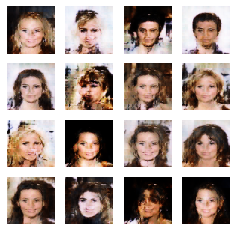

Epoch 10810, Discriminator: Loss: 0.12159496545791626 Accuracy: 0.98046875, Generator Loss: 4.925639629364014, Time: 3758.4858610630035
Epoch 10820, Discriminator: Loss: 0.11608510464429855 Accuracy: 0.982421875, Generator Loss: 4.948613166809082, Time: 3761.87025642395
Epoch 10830, Discriminator: Loss: 0.1483391486108303 Accuracy: 0.974609375, Generator Loss: 5.149691581726074, Time: 3765.252025127411
Epoch 10840, Discriminator: Loss: 0.1027916930615902 Accuracy: 0.982421875, Generator Loss: 6.15328311920166, Time: 3768.6410501003265
Epoch 10850, Discriminator: Loss: 0.26398463547229767 Accuracy: 0.947265625, Generator Loss: 7.199883937835693, Time: 3772.0214014053345
Epoch 10860, Discriminator: Loss: 0.09500919654965401 Accuracy: 0.986328125, Generator Loss: 6.140054702758789, Time: 3775.4036042690277
Epoch 10870, Discriminator: Loss: 0.1302202008664608 Accuracy: 0.978515625, Generator Loss: 5.288312911987305, Time: 3778.7890582084656
Epoch 10880, Discriminator: Loss: 0.1401576548814

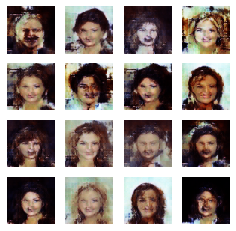

Epoch 10910, Discriminator: Loss: 0.15976107120513916 Accuracy: 0.96875, Generator Loss: 6.136209011077881, Time: 3793.059472322464
Epoch 10920, Discriminator: Loss: 0.07732611149549484 Accuracy: 0.9921875, Generator Loss: 5.618250370025635, Time: 3796.4576437473297
Epoch 10930, Discriminator: Loss: 0.12558438628911972 Accuracy: 0.978515625, Generator Loss: 6.634487152099609, Time: 3799.846161842346
Epoch 10940, Discriminator: Loss: 0.22684483975172043 Accuracy: 0.966796875, Generator Loss: 5.529510021209717, Time: 3803.2078144550323
Epoch 10950, Discriminator: Loss: 0.29044342786073685 Accuracy: 0.947265625, Generator Loss: 5.712961196899414, Time: 3806.5720703601837
Epoch 10960, Discriminator: Loss: 0.0936763547360897 Accuracy: 0.986328125, Generator Loss: 6.467665672302246, Time: 3809.951430082321
Epoch 10970, Discriminator: Loss: 0.10576462745666504 Accuracy: 0.986328125, Generator Loss: 5.9812140464782715, Time: 3813.33865070343
Epoch 10980, Discriminator: Loss: 0.2003844343125820

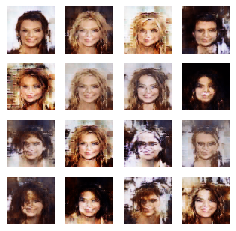

Epoch 11010, Discriminator: Loss: 0.10883025825023651 Accuracy: 0.984375, Generator Loss: 5.674957752227783, Time: 3827.6134247779846
Epoch 11020, Discriminator: Loss: 0.10911625623703003 Accuracy: 0.982421875, Generator Loss: 5.483242511749268, Time: 3830.998778104782
Epoch 11030, Discriminator: Loss: 0.07627168856561184 Accuracy: 0.990234375, Generator Loss: 5.481982707977295, Time: 3834.3696501255035
Epoch 11040, Discriminator: Loss: 0.26654789596796036 Accuracy: 0.947265625, Generator Loss: 5.8261895179748535, Time: 3837.7434861660004
Epoch 11050, Discriminator: Loss: 0.0889996811747551 Accuracy: 0.990234375, Generator Loss: 5.013874530792236, Time: 3841.1282110214233
Epoch 11060, Discriminator: Loss: 0.07702761515974998 Accuracy: 0.990234375, Generator Loss: 5.551140785217285, Time: 3844.5215356349945
Epoch 11070, Discriminator: Loss: 0.0817505456507206 Accuracy: 0.98828125, Generator Loss: 5.936606407165527, Time: 3847.8980300426483
Epoch 11080, Discriminator: Loss: 0.14827650785

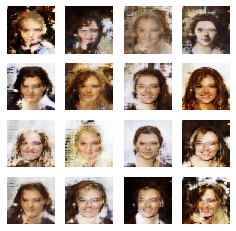

Epoch 11110, Discriminator: Loss: 0.1066339761018753 Accuracy: 0.982421875, Generator Loss: 5.684360027313232, Time: 3862.4551796913147
Epoch 11120, Discriminator: Loss: 0.14253053069114685 Accuracy: 0.98046875, Generator Loss: 5.7967915534973145, Time: 3865.837083339691
Epoch 11130, Discriminator: Loss: 0.14435083232820034 Accuracy: 0.97265625, Generator Loss: 5.779895305633545, Time: 3869.2174248695374
Epoch 11140, Discriminator: Loss: 0.07471797056496143 Accuracy: 0.990234375, Generator Loss: 5.500105857849121, Time: 3872.5819008350372
Epoch 11150, Discriminator: Loss: 0.08234312012791634 Accuracy: 0.982421875, Generator Loss: 6.07180118560791, Time: 3875.983533859253
Epoch 11160, Discriminator: Loss: 0.21338292956352234 Accuracy: 0.953125, Generator Loss: 6.198707580566406, Time: 3879.3580191135406
Epoch 11170, Discriminator: Loss: 0.18518994003534317 Accuracy: 0.96484375, Generator Loss: 6.002251625061035, Time: 3882.7519986629486
Epoch 11180, Discriminator: Loss: 0.07737666927278

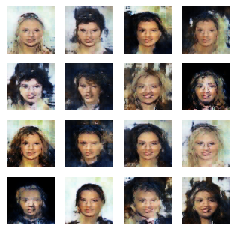

Epoch 11210, Discriminator: Loss: 0.19326306879520416 Accuracy: 0.955078125, Generator Loss: 6.384932518005371, Time: 3897.018892765045
Epoch 11220, Discriminator: Loss: 0.12441838532686234 Accuracy: 0.984375, Generator Loss: 6.0047454833984375, Time: 3900.3922476768494
Epoch 11230, Discriminator: Loss: 0.11478681862354279 Accuracy: 0.98046875, Generator Loss: 5.924590587615967, Time: 3903.7661213874817
Epoch 11240, Discriminator: Loss: 0.11575481109321117 Accuracy: 0.982421875, Generator Loss: 5.64696741104126, Time: 3907.148736476898
Epoch 11250, Discriminator: Loss: 0.22206539660692215 Accuracy: 0.958984375, Generator Loss: 6.4992828369140625, Time: 3910.5445640087128
Epoch 11260, Discriminator: Loss: 0.1716623492538929 Accuracy: 0.970703125, Generator Loss: 7.634092330932617, Time: 3913.930867433548
Epoch 11270, Discriminator: Loss: 0.08263485878705978 Accuracy: 0.986328125, Generator Loss: 6.43256950378418, Time: 3917.305584669113
Epoch 11280, Discriminator: Loss: 0.11602370068430

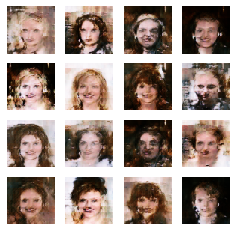

Epoch 11310, Discriminator: Loss: 0.11314675584435463 Accuracy: 0.98046875, Generator Loss: 5.91275691986084, Time: 3931.538668870926
Epoch 11320, Discriminator: Loss: 0.10720656253397465 Accuracy: 0.98046875, Generator Loss: 6.070202350616455, Time: 3934.9337310791016
Epoch 11330, Discriminator: Loss: 0.12674426659941673 Accuracy: 0.9765625, Generator Loss: 4.960250377655029, Time: 3938.318606376648
Epoch 11340, Discriminator: Loss: 0.13990505412220955 Accuracy: 0.98046875, Generator Loss: 5.2937445640563965, Time: 3941.6901264190674
Epoch 11350, Discriminator: Loss: 0.07432669401168823 Accuracy: 0.990234375, Generator Loss: 5.31464147567749, Time: 3945.0676963329315
Epoch 11360, Discriminator: Loss: 0.12511633709073067 Accuracy: 0.98046875, Generator Loss: 6.174261093139648, Time: 3948.449605703354
Epoch 11370, Discriminator: Loss: 0.08017310500144958 Accuracy: 0.990234375, Generator Loss: 5.982727527618408, Time: 3951.8264932632446
Epoch 11380, Discriminator: Loss: 0.117359656840562

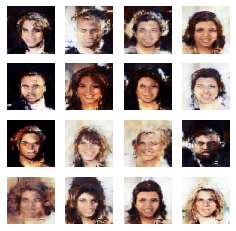

Epoch 11410, Discriminator: Loss: 0.1129395104944706 Accuracy: 0.974609375, Generator Loss: 6.581338405609131, Time: 3966.3797171115875
Epoch 11420, Discriminator: Loss: 0.05828527547419071 Accuracy: 0.990234375, Generator Loss: 5.829572677612305, Time: 3969.7664148807526
Epoch 11430, Discriminator: Loss: 0.12812958657741547 Accuracy: 0.974609375, Generator Loss: 6.373154163360596, Time: 3973.140590429306
Epoch 11440, Discriminator: Loss: 0.1300193890929222 Accuracy: 0.9765625, Generator Loss: 6.965453624725342, Time: 3976.5080692768097
Epoch 11450, Discriminator: Loss: 0.178573377430439 Accuracy: 0.970703125, Generator Loss: 6.761266231536865, Time: 3979.885055541992
Epoch 11460, Discriminator: Loss: 0.11985427141189575 Accuracy: 0.9765625, Generator Loss: 6.189126968383789, Time: 3983.273187637329
Epoch 11470, Discriminator: Loss: 0.09341623075306416 Accuracy: 0.984375, Generator Loss: 6.525082588195801, Time: 3986.660491704941
Epoch 11480, Discriminator: Loss: 0.13154801167547703 Ac

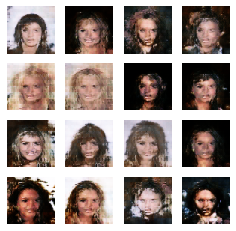

Epoch 11510, Discriminator: Loss: 0.08410324715077877 Accuracy: 0.984375, Generator Loss: 6.037351608276367, Time: 4000.9917752742767
Epoch 11520, Discriminator: Loss: 0.14201704412698746 Accuracy: 0.978515625, Generator Loss: 5.239019393920898, Time: 4004.3915696144104
Epoch 11530, Discriminator: Loss: 0.11972132325172424 Accuracy: 0.986328125, Generator Loss: 5.631350994110107, Time: 4007.769540786743
Epoch 11540, Discriminator: Loss: 0.3159390389919281 Accuracy: 0.9375, Generator Loss: 5.2393975257873535, Time: 4011.1403303146362
Epoch 11550, Discriminator: Loss: 0.17478854209184647 Accuracy: 0.966796875, Generator Loss: 5.5568389892578125, Time: 4014.547238588333
Epoch 11560, Discriminator: Loss: 0.08896678313612938 Accuracy: 0.986328125, Generator Loss: 5.645932197570801, Time: 4017.9275271892548
Epoch 11570, Discriminator: Loss: 0.06393997743725777 Accuracy: 0.994140625, Generator Loss: 5.97727108001709, Time: 4021.3182649612427
Epoch 11580, Discriminator: Loss: 0.131583072245121

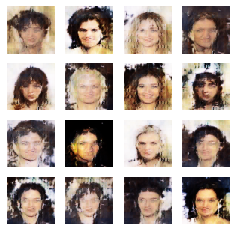

Epoch 11610, Discriminator: Loss: 0.2587331533432007 Accuracy: 0.943359375, Generator Loss: 7.222922325134277, Time: 4035.590857744217
Epoch 11620, Discriminator: Loss: 0.12319336086511612 Accuracy: 0.984375, Generator Loss: 5.998171806335449, Time: 4038.9658284187317
Epoch 11630, Discriminator: Loss: 0.22403842862695456 Accuracy: 0.955078125, Generator Loss: 7.265298843383789, Time: 4042.3573665618896
Epoch 11640, Discriminator: Loss: 0.16892872005701065 Accuracy: 0.970703125, Generator Loss: 5.530847549438477, Time: 4045.7478914260864
Epoch 11650, Discriminator: Loss: 0.11729446053504944 Accuracy: 0.9765625, Generator Loss: 6.127785682678223, Time: 4049.1140172481537
Epoch 11660, Discriminator: Loss: 0.1406404860317707 Accuracy: 0.984375, Generator Loss: 6.313799858093262, Time: 4052.497727870941
Epoch 11670, Discriminator: Loss: 0.08000658266246319 Accuracy: 0.986328125, Generator Loss: 6.216220378875732, Time: 4055.883924484253
Epoch 11680, Discriminator: Loss: 0.11647414416074753 

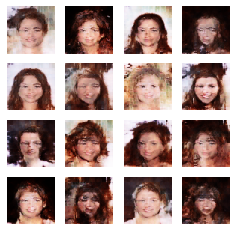

Epoch 11710, Discriminator: Loss: 0.043524475768208504 Accuracy: 0.998046875, Generator Loss: 6.251945495605469, Time: 4070.1667313575745
Epoch 11720, Discriminator: Loss: 0.11994972079992294 Accuracy: 0.97265625, Generator Loss: 7.610808372497559, Time: 4073.549296617508
Epoch 11730, Discriminator: Loss: 0.06766141392290592 Accuracy: 0.990234375, Generator Loss: 5.9037275314331055, Time: 4076.9423706531525
Epoch 11740, Discriminator: Loss: 0.18466580100357533 Accuracy: 0.96875, Generator Loss: 5.809549331665039, Time: 4080.330712080002
Epoch 11750, Discriminator: Loss: 0.0763091929256916 Accuracy: 0.98828125, Generator Loss: 6.627198696136475, Time: 4083.707835674286
Epoch 11760, Discriminator: Loss: 0.24930550158023834 Accuracy: 0.953125, Generator Loss: 10.24816608428955, Time: 4087.09752702713
Epoch 11770, Discriminator: Loss: 0.17549999058246613 Accuracy: 0.96875, Generator Loss: 6.958599090576172, Time: 4090.475797176361
Epoch 11780, Discriminator: Loss: 0.21672718226909637 Accur

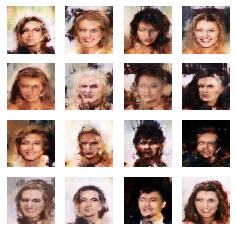

Epoch 11810, Discriminator: Loss: 0.3515782356262207 Accuracy: 0.927734375, Generator Loss: 6.137348175048828, Time: 4105.049685001373
Epoch 11820, Discriminator: Loss: 0.10166585445404053 Accuracy: 0.982421875, Generator Loss: 6.127800464630127, Time: 4108.414443731308
Epoch 11830, Discriminator: Loss: 0.10789471492171288 Accuracy: 0.984375, Generator Loss: 6.22043514251709, Time: 4111.802178621292
Epoch 11840, Discriminator: Loss: 0.07794744335114956 Accuracy: 0.994140625, Generator Loss: 6.026071548461914, Time: 4115.188462972641
Epoch 11850, Discriminator: Loss: 0.12508026137948036 Accuracy: 0.978515625, Generator Loss: 6.170841693878174, Time: 4118.568255662918
Epoch 11860, Discriminator: Loss: 0.12080219388008118 Accuracy: 0.96875, Generator Loss: 5.789856910705566, Time: 4121.9564254283905
Epoch 11870, Discriminator: Loss: 0.22908060252666473 Accuracy: 0.955078125, Generator Loss: 7.160879611968994, Time: 4125.348350048065
Epoch 11880, Discriminator: Loss: 0.14354098588228226 Ac

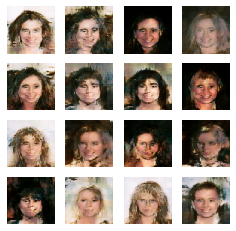

Epoch 11910, Discriminator: Loss: 0.21047686785459518 Accuracy: 0.966796875, Generator Loss: 6.100394248962402, Time: 4139.62460398674
Epoch 11920, Discriminator: Loss: 0.05478990823030472 Accuracy: 0.99609375, Generator Loss: 6.234764099121094, Time: 4142.997939348221
Epoch 11930, Discriminator: Loss: 0.1315072551369667 Accuracy: 0.982421875, Generator Loss: 5.864734649658203, Time: 4146.387691259384
Epoch 11940, Discriminator: Loss: 0.11062232777476311 Accuracy: 0.9765625, Generator Loss: 6.561152458190918, Time: 4149.7714874744415
Epoch 11950, Discriminator: Loss: 0.06755532510578632 Accuracy: 0.98828125, Generator Loss: 6.729991436004639, Time: 4153.146971464157
Epoch 11960, Discriminator: Loss: 0.15713004767894745 Accuracy: 0.966796875, Generator Loss: 5.488943099975586, Time: 4156.524300575256
Epoch 11970, Discriminator: Loss: 0.10817934945225716 Accuracy: 0.978515625, Generator Loss: 6.49708366394043, Time: 4159.911894798279
Epoch 11980, Discriminator: Loss: 0.23307188227772713 

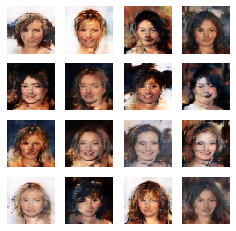

Epoch 12010, Discriminator: Loss: 0.0660795122385025 Accuracy: 0.994140625, Generator Loss: 6.6742448806762695, Time: 4174.174497842789
Epoch 12020, Discriminator: Loss: 0.19669516384601593 Accuracy: 0.962890625, Generator Loss: 7.619439125061035, Time: 4177.564883470535
Epoch 12030, Discriminator: Loss: 0.12161839008331299 Accuracy: 0.98046875, Generator Loss: 6.1035308837890625, Time: 4180.946890592575
Epoch 12040, Discriminator: Loss: 0.10611896961927414 Accuracy: 0.98046875, Generator Loss: 6.2923264503479, Time: 4184.333002328873
Epoch 12050, Discriminator: Loss: 0.17995180934667587 Accuracy: 0.970703125, Generator Loss: 8.479654312133789, Time: 4187.72996878624
Epoch 12060, Discriminator: Loss: 0.21226118132472038 Accuracy: 0.953125, Generator Loss: 5.816503047943115, Time: 4191.116820573807
Epoch 12070, Discriminator: Loss: 0.14680862054228783 Accuracy: 0.97265625, Generator Loss: 6.1790900230407715, Time: 4194.49430680275
Epoch 12080, Discriminator: Loss: 0.2174219861626625 Acc

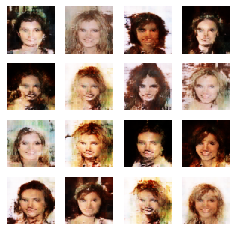

Epoch 12110, Discriminator: Loss: 0.10975725017488003 Accuracy: 0.978515625, Generator Loss: 5.850499153137207, Time: 4208.99258852005
Epoch 12120, Discriminator: Loss: 0.11480382829904556 Accuracy: 0.98046875, Generator Loss: 6.507816791534424, Time: 4212.37971830368
Epoch 12130, Discriminator: Loss: 0.061623018234968185 Accuracy: 0.99609375, Generator Loss: 6.651908874511719, Time: 4215.785887002945
Epoch 12140, Discriminator: Loss: 0.1232222132384777 Accuracy: 0.982421875, Generator Loss: 5.888765335083008, Time: 4219.176476478577
Epoch 12150, Discriminator: Loss: 0.04912925511598587 Accuracy: 0.98828125, Generator Loss: 6.806907653808594, Time: 4222.560013771057
Epoch 12160, Discriminator: Loss: 0.11031497269868851 Accuracy: 0.98046875, Generator Loss: 5.762966156005859, Time: 4225.944978952408
Epoch 12170, Discriminator: Loss: 0.10873539745807648 Accuracy: 0.9765625, Generator Loss: 7.149930000305176, Time: 4229.348249673843
Epoch 12180, Discriminator: Loss: 0.09038625471293926 Ac

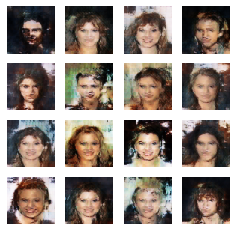

Epoch 12210, Discriminator: Loss: 0.07864683121442795 Accuracy: 0.982421875, Generator Loss: 5.96157169342041, Time: 4243.590305566788
Epoch 12220, Discriminator: Loss: 0.1738448701798916 Accuracy: 0.96875, Generator Loss: 6.695244789123535, Time: 4246.9947164058685
Epoch 12230, Discriminator: Loss: 0.10706708393990993 Accuracy: 0.978515625, Generator Loss: 6.246610641479492, Time: 4250.38160443306
Epoch 12240, Discriminator: Loss: 0.1963816061615944 Accuracy: 0.95703125, Generator Loss: 6.9307708740234375, Time: 4253.772613525391
Epoch 12250, Discriminator: Loss: 0.09177030250430107 Accuracy: 0.98046875, Generator Loss: 6.479905128479004, Time: 4257.1503965854645
Epoch 12260, Discriminator: Loss: 0.18126804381608963 Accuracy: 0.96875, Generator Loss: 8.025221824645996, Time: 4260.535350799561
Epoch 12270, Discriminator: Loss: 0.13465707004070282 Accuracy: 0.97265625, Generator Loss: 6.522396087646484, Time: 4263.909690618515
Epoch 12280, Discriminator: Loss: 0.13245889544487 Accuracy:

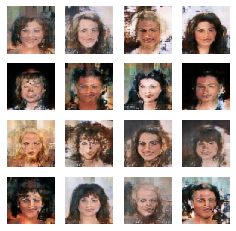

Epoch 12310, Discriminator: Loss: 0.10353423655033112 Accuracy: 0.984375, Generator Loss: 5.6452813148498535, Time: 4278.171429157257
Epoch 12320, Discriminator: Loss: 0.18062476068735123 Accuracy: 0.9765625, Generator Loss: 6.446002960205078, Time: 4281.552494764328
Epoch 12330, Discriminator: Loss: 0.07481329143047333 Accuracy: 0.986328125, Generator Loss: 6.933102607727051, Time: 4284.946570158005
Epoch 12340, Discriminator: Loss: 0.24487850815057755 Accuracy: 0.953125, Generator Loss: 7.334147930145264, Time: 4288.334374666214
Epoch 12350, Discriminator: Loss: 0.1425452083349228 Accuracy: 0.97265625, Generator Loss: 6.61797571182251, Time: 4291.709269285202
Epoch 12360, Discriminator: Loss: 0.15207989141345024 Accuracy: 0.974609375, Generator Loss: 5.736433029174805, Time: 4295.0802693367
Epoch 12370, Discriminator: Loss: 0.1432000994682312 Accuracy: 0.970703125, Generator Loss: 6.399653434753418, Time: 4298.46081328392
Epoch 12380, Discriminator: Loss: 0.14004360139369965 Accuracy

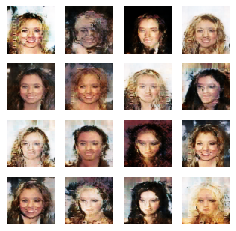

Epoch 12410, Discriminator: Loss: 0.17735178023576736 Accuracy: 0.966796875, Generator Loss: 6.413909912109375, Time: 4312.75651216507
Epoch 12420, Discriminator: Loss: 0.17957501113414764 Accuracy: 0.962890625, Generator Loss: 6.286164283752441, Time: 4316.140239953995
Epoch 12430, Discriminator: Loss: 0.09337638691067696 Accuracy: 0.9921875, Generator Loss: 6.2744855880737305, Time: 4319.516411781311
Epoch 12440, Discriminator: Loss: 0.10247093252837658 Accuracy: 0.986328125, Generator Loss: 6.851351737976074, Time: 4322.894862174988
Epoch 12450, Discriminator: Loss: 0.11893828958272934 Accuracy: 0.98046875, Generator Loss: 7.662591457366943, Time: 4326.284568309784
Epoch 12460, Discriminator: Loss: 0.11519675888121128 Accuracy: 0.97265625, Generator Loss: 6.364132881164551, Time: 4329.660686016083
Epoch 12470, Discriminator: Loss: 0.09481400810182095 Accuracy: 0.978515625, Generator Loss: 5.882888317108154, Time: 4333.062782287598
Epoch 12480, Discriminator: Loss: 0.0760746896266937

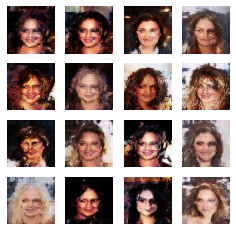

Epoch 12510, Discriminator: Loss: 0.051311712712049484 Accuracy: 0.994140625, Generator Loss: 6.639878273010254, Time: 4347.659320116043
Epoch 12520, Discriminator: Loss: 0.13182432949543 Accuracy: 0.98046875, Generator Loss: 6.430741310119629, Time: 4351.052471876144
Epoch 12530, Discriminator: Loss: 0.08991115540266037 Accuracy: 0.98828125, Generator Loss: 6.931337833404541, Time: 4354.430339097977
Epoch 12540, Discriminator: Loss: 0.12434488721191883 Accuracy: 0.978515625, Generator Loss: 5.946718215942383, Time: 4357.8287217617035
Epoch 12550, Discriminator: Loss: 0.0621208380907774 Accuracy: 0.99609375, Generator Loss: 6.106002330780029, Time: 4361.208332777023
Epoch 12560, Discriminator: Loss: 0.22147253155708313 Accuracy: 0.95703125, Generator Loss: 6.802237510681152, Time: 4364.593303203583
Epoch 12570, Discriminator: Loss: 0.0734310895204544 Accuracy: 0.98828125, Generator Loss: 5.9723968505859375, Time: 4367.985145568848
Epoch 12580, Discriminator: Loss: 0.06846139207482338 A

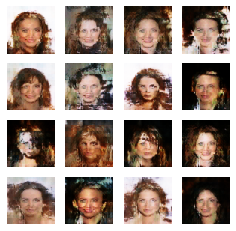

Epoch 12610, Discriminator: Loss: 0.046586327254772186 Accuracy: 0.99609375, Generator Loss: 6.204407691955566, Time: 4382.2431128025055
Epoch 12620, Discriminator: Loss: 0.08099745213985443 Accuracy: 0.990234375, Generator Loss: 6.543320655822754, Time: 4385.616837024689
Epoch 12630, Discriminator: Loss: 0.10901704616844654 Accuracy: 0.984375, Generator Loss: 6.0547685623168945, Time: 4389.003859996796
Epoch 12640, Discriminator: Loss: 0.11542228236794472 Accuracy: 0.982421875, Generator Loss: 5.810495853424072, Time: 4392.379437923431
Epoch 12650, Discriminator: Loss: 0.2628616839647293 Accuracy: 0.953125, Generator Loss: 7.670830726623535, Time: 4395.759853363037
Epoch 12660, Discriminator: Loss: 0.12505144998431206 Accuracy: 0.978515625, Generator Loss: 6.7496724128723145, Time: 4399.14443230629
Epoch 12670, Discriminator: Loss: 0.03799778502434492 Accuracy: 0.998046875, Generator Loss: 6.6338911056518555, Time: 4402.53218626976
Epoch 12680, Discriminator: Loss: 0.05221521202474832

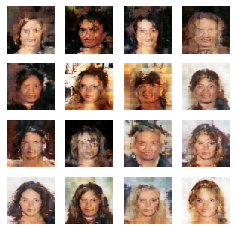

Epoch 12710, Discriminator: Loss: 0.4306469112634659 Accuracy: 0.91015625, Generator Loss: 4.4163970947265625, Time: 4416.848689317703
Epoch 12720, Discriminator: Loss: 0.39175184071063995 Accuracy: 0.916015625, Generator Loss: 4.023938179016113, Time: 4420.22985291481
Epoch 12730, Discriminator: Loss: 0.2845637798309326 Accuracy: 0.939453125, Generator Loss: 4.655791282653809, Time: 4423.609349012375
Epoch 12740, Discriminator: Loss: 0.2653280049562454 Accuracy: 0.947265625, Generator Loss: 5.255710601806641, Time: 4426.996229887009
Epoch 12750, Discriminator: Loss: 0.2584647536277771 Accuracy: 0.953125, Generator Loss: 5.797148704528809, Time: 4430.372784852982
Epoch 12760, Discriminator: Loss: 0.17305999994277954 Accuracy: 0.96875, Generator Loss: 5.524477958679199, Time: 4433.755124568939
Epoch 12770, Discriminator: Loss: 0.20055122673511505 Accuracy: 0.962890625, Generator Loss: 5.2920241355896, Time: 4437.1346271038055
Epoch 12780, Discriminator: Loss: 0.19126703590154648 Accurac

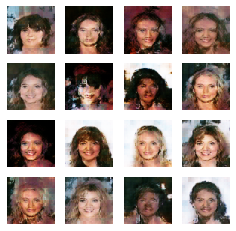

Epoch 12810, Discriminator: Loss: 0.29769259691238403 Accuracy: 0.951171875, Generator Loss: 5.402300834655762, Time: 4451.697506427765
Epoch 12820, Discriminator: Loss: 0.14756743609905243 Accuracy: 0.970703125, Generator Loss: 5.667003154754639, Time: 4455.089029550552
Epoch 12830, Discriminator: Loss: 0.10394107550382614 Accuracy: 0.98046875, Generator Loss: 6.272294998168945, Time: 4458.486351966858
Epoch 12840, Discriminator: Loss: 0.07798254117369652 Accuracy: 0.98828125, Generator Loss: 6.318782329559326, Time: 4461.894248485565
Epoch 12850, Discriminator: Loss: 0.19068143516778946 Accuracy: 0.96875, Generator Loss: 6.427774906158447, Time: 4465.291732549667
Epoch 12860, Discriminator: Loss: 0.1289452575147152 Accuracy: 0.984375, Generator Loss: 5.485444068908691, Time: 4468.681520700455
Epoch 12870, Discriminator: Loss: 0.16014748439192772 Accuracy: 0.96484375, Generator Loss: 5.589104652404785, Time: 4472.058632612228
Epoch 12880, Discriminator: Loss: 0.2962011247873306 Accura

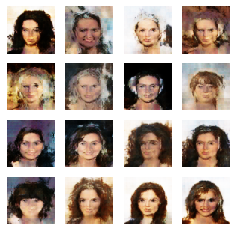

Epoch 12910, Discriminator: Loss: 0.047038884833455086 Accuracy: 0.99609375, Generator Loss: 6.472232818603516, Time: 4486.331338882446
Epoch 12920, Discriminator: Loss: 0.14187908545136452 Accuracy: 0.982421875, Generator Loss: 5.150805950164795, Time: 4489.7137541770935
Epoch 12930, Discriminator: Loss: 0.1336168833076954 Accuracy: 0.9765625, Generator Loss: 5.646871089935303, Time: 4493.104722499847
Epoch 12940, Discriminator: Loss: 0.1816413514316082 Accuracy: 0.970703125, Generator Loss: 5.968000411987305, Time: 4496.496330738068
Epoch 12950, Discriminator: Loss: 0.09615228697657585 Accuracy: 0.986328125, Generator Loss: 5.851683139801025, Time: 4499.876357316971
Epoch 12960, Discriminator: Loss: 0.11454515159130096 Accuracy: 0.974609375, Generator Loss: 5.8537278175354, Time: 4503.2578983306885
Epoch 12970, Discriminator: Loss: 0.136717326939106 Accuracy: 0.978515625, Generator Loss: 6.692347526550293, Time: 4506.631912946701
Epoch 12980, Discriminator: Loss: 0.16260482370853424 

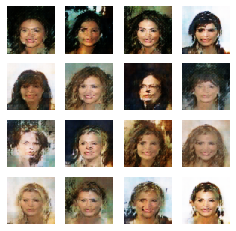

Epoch 13010, Discriminator: Loss: 0.2317255437374115 Accuracy: 0.955078125, Generator Loss: 7.098316192626953, Time: 4520.841635465622
Epoch 13020, Discriminator: Loss: 0.11101978458464146 Accuracy: 0.978515625, Generator Loss: 6.734491348266602, Time: 4524.223862886429
Epoch 13030, Discriminator: Loss: 0.10485738143324852 Accuracy: 0.978515625, Generator Loss: 6.6535162925720215, Time: 4527.587778091431
Epoch 13040, Discriminator: Loss: 0.19642314314842224 Accuracy: 0.96484375, Generator Loss: 5.319112777709961, Time: 4530.96644949913
Epoch 13050, Discriminator: Loss: 0.16039007157087326 Accuracy: 0.96875, Generator Loss: 7.000450611114502, Time: 4534.352933883667
Epoch 13060, Discriminator: Loss: 0.13530056923627853 Accuracy: 0.974609375, Generator Loss: 6.483339786529541, Time: 4537.722476005554
Epoch 13070, Discriminator: Loss: 0.17980578169226646 Accuracy: 0.966796875, Generator Loss: 6.166399955749512, Time: 4541.093776941299
Epoch 13080, Discriminator: Loss: 0.09219702892005444 

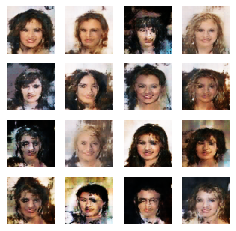

Epoch 13110, Discriminator: Loss: 0.10980623960494995 Accuracy: 0.98046875, Generator Loss: 6.005008697509766, Time: 4555.303959608078
Epoch 13120, Discriminator: Loss: 0.1641155481338501 Accuracy: 0.96875, Generator Loss: 5.798941135406494, Time: 4558.686985015869
Epoch 13130, Discriminator: Loss: 0.11836270987987518 Accuracy: 0.98046875, Generator Loss: 6.348702430725098, Time: 4562.051378250122
Epoch 13140, Discriminator: Loss: 0.15206006169319153 Accuracy: 0.9765625, Generator Loss: 6.773332595825195, Time: 4565.415345430374
Epoch 13150, Discriminator: Loss: 0.15256577730178833 Accuracy: 0.974609375, Generator Loss: 6.015177249908447, Time: 4568.796637058258
Epoch 13160, Discriminator: Loss: 0.12092538177967072 Accuracy: 0.978515625, Generator Loss: 5.588292598724365, Time: 4572.166395187378
Epoch 13170, Discriminator: Loss: 0.20657404139637947 Accuracy: 0.96875, Generator Loss: 5.206757545471191, Time: 4575.546340703964
Epoch 13180, Discriminator: Loss: 0.1621852722018957 Accuracy

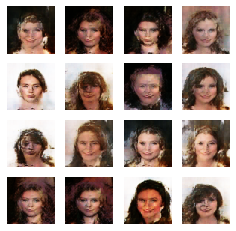

Epoch 13210, Discriminator: Loss: 0.10645094513893127 Accuracy: 0.982421875, Generator Loss: 5.891788482666016, Time: 4590.004677295685
Epoch 13220, Discriminator: Loss: 0.06386883370578289 Accuracy: 0.98828125, Generator Loss: 6.07890510559082, Time: 4593.382116556168
Epoch 13230, Discriminator: Loss: 0.17973045259714127 Accuracy: 0.966796875, Generator Loss: 7.3601884841918945, Time: 4596.751130104065
Epoch 13240, Discriminator: Loss: 0.12681958824396133 Accuracy: 0.98046875, Generator Loss: 6.370995998382568, Time: 4600.134485244751
Epoch 13250, Discriminator: Loss: 0.2394849807024002 Accuracy: 0.958984375, Generator Loss: 6.513093948364258, Time: 4603.496359825134
Epoch 13260, Discriminator: Loss: 0.17347101867198944 Accuracy: 0.966796875, Generator Loss: 6.305490493774414, Time: 4606.866000413895
Epoch 13270, Discriminator: Loss: 0.12198381870985031 Accuracy: 0.98046875, Generator Loss: 5.281391143798828, Time: 4610.24475979805
Epoch 13280, Discriminator: Loss: 0.08697773143649101

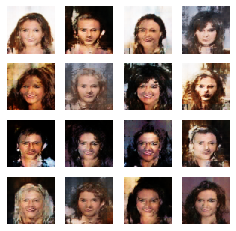

Epoch 13310, Discriminator: Loss: 0.15608777105808258 Accuracy: 0.97265625, Generator Loss: 6.6137261390686035, Time: 4624.5470497608185
Epoch 13320, Discriminator: Loss: 0.12759093195199966 Accuracy: 0.984375, Generator Loss: 5.961659908294678, Time: 4627.91296339035
Epoch 13330, Discriminator: Loss: 0.3532722741365433 Accuracy: 0.927734375, Generator Loss: 7.751457214355469, Time: 4631.256088256836
Epoch 13340, Discriminator: Loss: 0.05318402871489525 Accuracy: 0.994140625, Generator Loss: 5.7383036613464355, Time: 4634.607226133347
Epoch 13350, Discriminator: Loss: 0.22414109855890274 Accuracy: 0.953125, Generator Loss: 6.548546314239502, Time: 4637.961064338684
Epoch 13360, Discriminator: Loss: 0.1013004407286644 Accuracy: 0.984375, Generator Loss: 6.000692367553711, Time: 4641.312625408173
Epoch 13370, Discriminator: Loss: 0.10660659149289131 Accuracy: 0.982421875, Generator Loss: 6.161712169647217, Time: 4644.671625137329
Epoch 13380, Discriminator: Loss: 0.10728009790182114 Accu

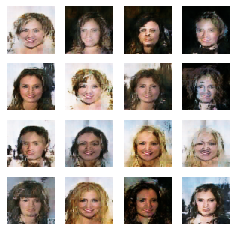

Epoch 13410, Discriminator: Loss: 0.13019684702157974 Accuracy: 0.986328125, Generator Loss: 8.306356430053711, Time: 4658.828188896179
Epoch 13420, Discriminator: Loss: 0.1145804114639759 Accuracy: 0.974609375, Generator Loss: 6.823992729187012, Time: 4662.199269294739
Epoch 13430, Discriminator: Loss: 0.18231265246868134 Accuracy: 0.96484375, Generator Loss: 6.532675743103027, Time: 4665.5768094062805
Epoch 13440, Discriminator: Loss: 0.17135211825370789 Accuracy: 0.96875, Generator Loss: 7.529566287994385, Time: 4668.9351353645325
Epoch 13450, Discriminator: Loss: 0.14642254263162613 Accuracy: 0.974609375, Generator Loss: 7.394334316253662, Time: 4672.302360296249
Epoch 13460, Discriminator: Loss: 0.07972826063632965 Accuracy: 0.986328125, Generator Loss: 6.5103373527526855, Time: 4675.6823353767395
Epoch 13470, Discriminator: Loss: 0.12003142759203911 Accuracy: 0.98046875, Generator Loss: 6.500136375427246, Time: 4679.043842792511
Epoch 13480, Discriminator: Loss: 0.164548076689243

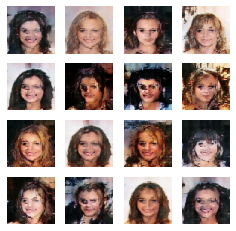

Epoch 13510, Discriminator: Loss: 0.17134065181016922 Accuracy: 0.974609375, Generator Loss: 6.271293640136719, Time: 4693.52321434021
Epoch 13520, Discriminator: Loss: 0.086191326379776 Accuracy: 0.984375, Generator Loss: 5.857431411743164, Time: 4696.897554636002
Epoch 13530, Discriminator: Loss: 0.1395392082631588 Accuracy: 0.97265625, Generator Loss: 6.405176162719727, Time: 4700.270596504211
Epoch 13540, Discriminator: Loss: 0.14575403928756714 Accuracy: 0.974609375, Generator Loss: 6.559058666229248, Time: 4703.643313169479
Epoch 13550, Discriminator: Loss: 0.17667116969823837 Accuracy: 0.970703125, Generator Loss: 6.057042121887207, Time: 4707.022170782089
Epoch 13560, Discriminator: Loss: 0.03764853812754154 Accuracy: 0.99609375, Generator Loss: 6.595309257507324, Time: 4710.39071559906
Epoch 13570, Discriminator: Loss: 0.19195158779621124 Accuracy: 0.96484375, Generator Loss: 7.261517524719238, Time: 4713.781923532486
Epoch 13580, Discriminator: Loss: 0.1265794150531292 Accura

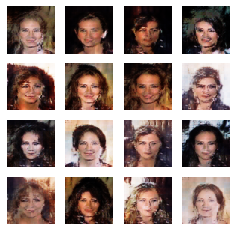

Epoch 13610, Discriminator: Loss: 0.10169619508087635 Accuracy: 0.978515625, Generator Loss: 6.6288371086120605, Time: 4728.005947589874
Epoch 13620, Discriminator: Loss: 0.07129358500242233 Accuracy: 0.986328125, Generator Loss: 5.7135772705078125, Time: 4731.372116804123
Epoch 13630, Discriminator: Loss: 0.08063391223549843 Accuracy: 0.984375, Generator Loss: 7.526109218597412, Time: 4734.763078689575
Epoch 13640, Discriminator: Loss: 0.061113450676202774 Accuracy: 0.9921875, Generator Loss: 5.841008186340332, Time: 4738.1245493888855
Epoch 13650, Discriminator: Loss: 0.13167061284184456 Accuracy: 0.974609375, Generator Loss: 6.448427677154541, Time: 4741.489550113678
Epoch 13660, Discriminator: Loss: 0.27383850142359734 Accuracy: 0.947265625, Generator Loss: 7.5674238204956055, Time: 4744.8343551158905
Epoch 13670, Discriminator: Loss: 0.14504799991846085 Accuracy: 0.974609375, Generator Loss: 6.045572280883789, Time: 4748.195110797882
Epoch 13680, Discriminator: Loss: 0.15366110019

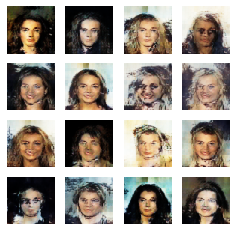

Epoch 13710, Discriminator: Loss: 0.10452144593000412 Accuracy: 0.984375, Generator Loss: 6.113582134246826, Time: 4762.454883575439
Epoch 13720, Discriminator: Loss: 0.1182912290096283 Accuracy: 0.978515625, Generator Loss: 7.199528217315674, Time: 4765.829019546509
Epoch 13730, Discriminator: Loss: 0.21556590497493744 Accuracy: 0.958984375, Generator Loss: 5.307130813598633, Time: 4769.197813987732
Epoch 13740, Discriminator: Loss: 0.11515364237129688 Accuracy: 0.984375, Generator Loss: 5.5448713302612305, Time: 4772.575087308884
Epoch 13750, Discriminator: Loss: 0.12089620903134346 Accuracy: 0.9765625, Generator Loss: 6.5301361083984375, Time: 4775.956606626511
Epoch 13760, Discriminator: Loss: 0.10170506685972214 Accuracy: 0.982421875, Generator Loss: 6.487613677978516, Time: 4779.330565929413
Epoch 13770, Discriminator: Loss: 0.08521055802702904 Accuracy: 0.98828125, Generator Loss: 6.587526321411133, Time: 4782.715715646744
Epoch 13780, Discriminator: Loss: 0.05989465117454529 Ac

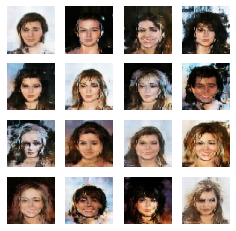

Epoch 13810, Discriminator: Loss: 0.09980641305446625 Accuracy: 0.978515625, Generator Loss: 6.253678798675537, Time: 4796.930561304092
Epoch 13820, Discriminator: Loss: 0.12489189207553864 Accuracy: 0.978515625, Generator Loss: 6.426365852355957, Time: 4800.312744617462
Epoch 13830, Discriminator: Loss: 0.07017281278967857 Accuracy: 0.990234375, Generator Loss: 6.208329200744629, Time: 4803.704963684082
Epoch 13840, Discriminator: Loss: 0.10186178237199783 Accuracy: 0.984375, Generator Loss: 6.056662082672119, Time: 4807.087645769119
Epoch 13850, Discriminator: Loss: 0.1389441005885601 Accuracy: 0.974609375, Generator Loss: 5.940813064575195, Time: 4810.475602149963
Epoch 13860, Discriminator: Loss: 0.11720508337020874 Accuracy: 0.982421875, Generator Loss: 6.3116135597229, Time: 4813.854495048523
Epoch 13870, Discriminator: Loss: 0.13645238429307938 Accuracy: 0.970703125, Generator Loss: 5.379007816314697, Time: 4817.244957208633
Epoch 13880, Discriminator: Loss: 0.1200905591249466 A

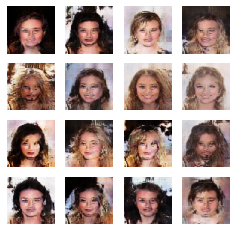

Epoch 13910, Discriminator: Loss: 0.20535273104906082 Accuracy: 0.955078125, Generator Loss: 4.693788528442383, Time: 4831.745876312256
Epoch 13920, Discriminator: Loss: 0.12438848614692688 Accuracy: 0.984375, Generator Loss: 5.784108638763428, Time: 4835.127021789551
Epoch 13930, Discriminator: Loss: 0.16843291372060776 Accuracy: 0.96484375, Generator Loss: 5.627959728240967, Time: 4838.518676042557
Epoch 13940, Discriminator: Loss: 0.08710082992911339 Accuracy: 0.986328125, Generator Loss: 6.067126274108887, Time: 4841.905910730362
Epoch 13950, Discriminator: Loss: 0.07190447673201561 Accuracy: 0.9921875, Generator Loss: 5.646857261657715, Time: 4845.307260990143
Epoch 13960, Discriminator: Loss: 0.1328306943178177 Accuracy: 0.982421875, Generator Loss: 6.955275058746338, Time: 4848.693876028061
Epoch 13970, Discriminator: Loss: 0.15051384270191193 Accuracy: 0.970703125, Generator Loss: 5.815003395080566, Time: 4852.085654735565
Epoch 13980, Discriminator: Loss: 0.1276935413479805 Ac

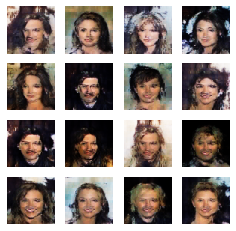

Epoch 14010, Discriminator: Loss: 0.09009241685271263 Accuracy: 0.984375, Generator Loss: 5.745553493499756, Time: 4866.31458902359
Epoch 14020, Discriminator: Loss: 0.09476817026734352 Accuracy: 0.984375, Generator Loss: 5.614417552947998, Time: 4869.693644523621
Epoch 14030, Discriminator: Loss: 0.08109990507364273 Accuracy: 0.98828125, Generator Loss: 6.71776008605957, Time: 4873.073488950729
Epoch 14040, Discriminator: Loss: 0.10695825889706612 Accuracy: 0.984375, Generator Loss: 6.847076892852783, Time: 4876.455498218536
Epoch 14050, Discriminator: Loss: 0.14796318858861923 Accuracy: 0.974609375, Generator Loss: 6.858711242675781, Time: 4879.835163354874
Epoch 14060, Discriminator: Loss: 0.09508733451366425 Accuracy: 0.986328125, Generator Loss: 6.184966087341309, Time: 4883.195588111877
Epoch 14070, Discriminator: Loss: 0.17700088396668434 Accuracy: 0.966796875, Generator Loss: 8.030001640319824, Time: 4886.582152843475
Epoch 14080, Discriminator: Loss: 0.17949198931455612 Accura

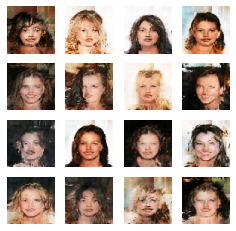

Epoch 14110, Discriminator: Loss: 0.09263015724718571 Accuracy: 0.98828125, Generator Loss: 6.571566581726074, Time: 4900.825974225998
Epoch 14120, Discriminator: Loss: 0.13823433220386505 Accuracy: 0.96875, Generator Loss: 6.52557373046875, Time: 4904.21387553215
Epoch 14130, Discriminator: Loss: 0.0321269566193223 Accuracy: 0.998046875, Generator Loss: 6.985879421234131, Time: 4907.606241703033
Epoch 14140, Discriminator: Loss: 0.060917582362890244 Accuracy: 0.986328125, Generator Loss: 6.90503454208374, Time: 4910.98811006546
Epoch 14150, Discriminator: Loss: 0.12120581045746803 Accuracy: 0.98046875, Generator Loss: 6.372877597808838, Time: 4914.391032218933
Epoch 14160, Discriminator: Loss: 0.10249565541744232 Accuracy: 0.984375, Generator Loss: 7.1137847900390625, Time: 4917.787774562836
Epoch 14170, Discriminator: Loss: 0.15066386107355356 Accuracy: 0.970703125, Generator Loss: 7.32259464263916, Time: 4921.181219816208
Epoch 14180, Discriminator: Loss: 0.15414786338806152 Accurac

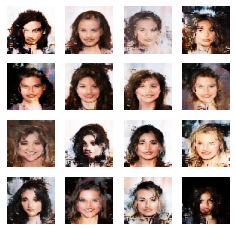

Epoch 14210, Discriminator: Loss: 0.11743033304810524 Accuracy: 0.978515625, Generator Loss: 5.377610206604004, Time: 4935.757481098175
Epoch 14220, Discriminator: Loss: 0.09739423543214798 Accuracy: 0.978515625, Generator Loss: 6.661361217498779, Time: 4939.157405614853
Epoch 14230, Discriminator: Loss: 0.23787422478199005 Accuracy: 0.962890625, Generator Loss: 6.186826705932617, Time: 4942.531725645065
Epoch 14240, Discriminator: Loss: 0.07195866107940674 Accuracy: 0.98828125, Generator Loss: 6.406617164611816, Time: 4945.922062635422
Epoch 14250, Discriminator: Loss: 0.06585795804858208 Accuracy: 0.986328125, Generator Loss: 6.314428806304932, Time: 4949.335653066635
Epoch 14260, Discriminator: Loss: 0.0628562942147255 Accuracy: 0.9921875, Generator Loss: 6.8372039794921875, Time: 4952.710164785385
Epoch 14270, Discriminator: Loss: 0.06486370228230953 Accuracy: 0.990234375, Generator Loss: 6.108822345733643, Time: 4956.0829205513
Epoch 14280, Discriminator: Loss: 0.09577250480651855

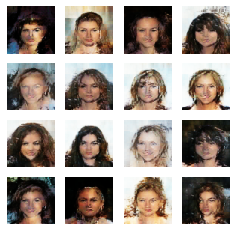

Epoch 14310, Discriminator: Loss: 0.03761471249163151 Accuracy: 0.99609375, Generator Loss: 6.6558918952941895, Time: 4970.293721914291
Epoch 14320, Discriminator: Loss: 0.09542016685009003 Accuracy: 0.98046875, Generator Loss: 6.454977512359619, Time: 4973.681380748749
Epoch 14330, Discriminator: Loss: 0.07475879043340683 Accuracy: 0.990234375, Generator Loss: 6.01173210144043, Time: 4977.066220998764
Epoch 14340, Discriminator: Loss: 0.09481564536690712 Accuracy: 0.9765625, Generator Loss: 7.236409664154053, Time: 4980.447249174118
Epoch 14350, Discriminator: Loss: 0.15226760506629944 Accuracy: 0.978515625, Generator Loss: 6.056640148162842, Time: 4983.832434415817
Epoch 14360, Discriminator: Loss: 0.09310459904372692 Accuracy: 0.986328125, Generator Loss: 6.400956153869629, Time: 4987.214720249176
Epoch 14370, Discriminator: Loss: 0.16235731542110443 Accuracy: 0.96875, Generator Loss: 5.763155460357666, Time: 4990.58441567421
Epoch 14380, Discriminator: Loss: 0.07665903866291046 Acc

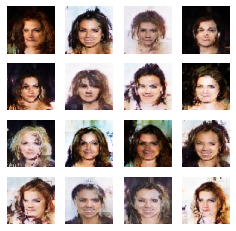

Epoch 14410, Discriminator: Loss: 0.2522801496088505 Accuracy: 0.953125, Generator Loss: 5.810545444488525, Time: 5004.820121526718
Epoch 14420, Discriminator: Loss: 0.1044663917273283 Accuracy: 0.9765625, Generator Loss: 5.807736396789551, Time: 5008.209563970566
Epoch 14430, Discriminator: Loss: 0.12921570613980293 Accuracy: 0.98046875, Generator Loss: 5.85819673538208, Time: 5011.586874723434
Epoch 14440, Discriminator: Loss: 0.05467798560857773 Accuracy: 0.98828125, Generator Loss: 6.231899738311768, Time: 5014.983013868332
Epoch 14450, Discriminator: Loss: 0.10048158094286919 Accuracy: 0.984375, Generator Loss: 6.355754852294922, Time: 5018.398339271545
Epoch 14460, Discriminator: Loss: 0.07166414964012802 Accuracy: 0.98046875, Generator Loss: 7.8780131340026855, Time: 5021.793192863464
Epoch 14470, Discriminator: Loss: 0.15761052072048187 Accuracy: 0.96875, Generator Loss: 5.806357383728027, Time: 5025.173881530762
Epoch 14480, Discriminator: Loss: 0.19727598875761032 Accuracy: 0

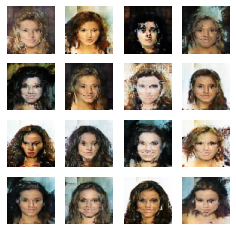

Epoch 14510, Discriminator: Loss: 0.07416971027851105 Accuracy: 0.986328125, Generator Loss: 6.436906814575195, Time: 5039.404233217239
Epoch 14520, Discriminator: Loss: 0.09254718013107777 Accuracy: 0.98828125, Generator Loss: 6.559545040130615, Time: 5042.774340391159
Epoch 14530, Discriminator: Loss: 0.19098732620477676 Accuracy: 0.95703125, Generator Loss: 6.30371618270874, Time: 5046.145373344421
Epoch 14540, Discriminator: Loss: 0.12284180894494057 Accuracy: 0.974609375, Generator Loss: 6.220422744750977, Time: 5049.521644353867
Epoch 14550, Discriminator: Loss: 0.06384187750518322 Accuracy: 0.98828125, Generator Loss: 5.875514030456543, Time: 5052.910231113434
Epoch 14560, Discriminator: Loss: 0.22020813263952732 Accuracy: 0.958984375, Generator Loss: 5.40319299697876, Time: 5056.300645112991
Epoch 14570, Discriminator: Loss: 0.08193239569664001 Accuracy: 0.982421875, Generator Loss: 6.294193744659424, Time: 5059.689102172852
Epoch 14580, Discriminator: Loss: 0.08855070173740387

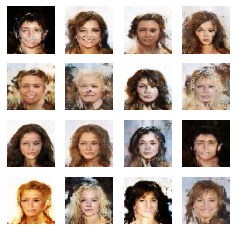

Epoch 14610, Discriminator: Loss: 0.1259433552622795 Accuracy: 0.98046875, Generator Loss: 5.794203758239746, Time: 5074.190595149994
Epoch 14620, Discriminator: Loss: 0.08586876653134823 Accuracy: 0.986328125, Generator Loss: 6.039943695068359, Time: 5077.585968971252
Epoch 14630, Discriminator: Loss: 0.08622946962714195 Accuracy: 0.98046875, Generator Loss: 6.213437557220459, Time: 5080.9740669727325
Epoch 14640, Discriminator: Loss: 0.05447189882397652 Accuracy: 0.9921875, Generator Loss: 6.364167213439941, Time: 5084.365537405014
Epoch 14650, Discriminator: Loss: 1.8183304350823164 Accuracy: 0.703125, Generator Loss: 3.880894660949707, Time: 5087.753231525421
Epoch 14660, Discriminator: Loss: 0.2658914774656296 Accuracy: 0.955078125, Generator Loss: 3.7012810707092285, Time: 5091.130740880966
Epoch 14670, Discriminator: Loss: 0.25677259266376495 Accuracy: 0.955078125, Generator Loss: 4.234925270080566, Time: 5094.524887084961
Epoch 14680, Discriminator: Loss: 0.321615993976593 Accu

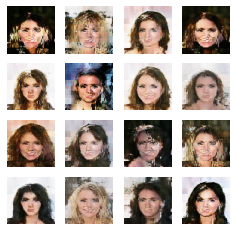

Epoch 14710, Discriminator: Loss: 0.1510951928794384 Accuracy: 0.974609375, Generator Loss: 5.655129432678223, Time: 5108.762826919556
Epoch 14720, Discriminator: Loss: 0.17824510484933853 Accuracy: 0.96484375, Generator Loss: 5.640739917755127, Time: 5112.133788108826
Epoch 14730, Discriminator: Loss: 0.20989182218909264 Accuracy: 0.966796875, Generator Loss: 5.643711090087891, Time: 5115.507533550262
Epoch 14740, Discriminator: Loss: 0.1652228757739067 Accuracy: 0.970703125, Generator Loss: 5.583227157592773, Time: 5118.89085316658
Epoch 14750, Discriminator: Loss: 0.08462297543883324 Accuracy: 0.98828125, Generator Loss: 5.582047462463379, Time: 5122.273510932922
Epoch 14760, Discriminator: Loss: 0.257934108376503 Accuracy: 0.955078125, Generator Loss: 5.929403305053711, Time: 5125.651903867722
Epoch 14770, Discriminator: Loss: 0.21807865798473358 Accuracy: 0.966796875, Generator Loss: 5.801128387451172, Time: 5129.044795036316
Epoch 14780, Discriminator: Loss: 0.06674542650580406 A

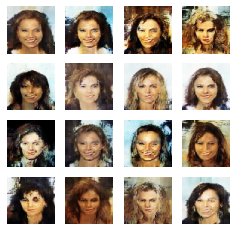

Epoch 14810, Discriminator: Loss: 0.19550873339176178 Accuracy: 0.96484375, Generator Loss: 5.531121730804443, Time: 5143.276599645615
Epoch 14820, Discriminator: Loss: 0.21995645016431808 Accuracy: 0.955078125, Generator Loss: 7.812647819519043, Time: 5146.659430742264
Epoch 14830, Discriminator: Loss: 0.17519677430391312 Accuracy: 0.970703125, Generator Loss: 5.1514177322387695, Time: 5150.059715270996
Epoch 14840, Discriminator: Loss: 0.1340625397861004 Accuracy: 0.97265625, Generator Loss: 5.795844554901123, Time: 5153.462833404541
Epoch 14850, Discriminator: Loss: 0.15691113471984863 Accuracy: 0.97265625, Generator Loss: 6.494144439697266, Time: 5156.862228870392
Epoch 14860, Discriminator: Loss: 0.14340944588184357 Accuracy: 0.974609375, Generator Loss: 5.524791717529297, Time: 5160.260801076889
Epoch 14870, Discriminator: Loss: 0.09956713020801544 Accuracy: 0.984375, Generator Loss: 6.260093688964844, Time: 5163.670213699341
Epoch 14880, Discriminator: Loss: 0.12608268670737743 

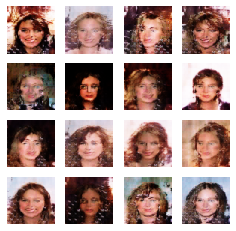

Epoch 14910, Discriminator: Loss: 0.5054750647395849 Accuracy: 0.90625, Generator Loss: 4.804490566253662, Time: 5178.27881360054
Epoch 14920, Discriminator: Loss: 0.1304941028356552 Accuracy: 0.9765625, Generator Loss: 5.7034783363342285, Time: 5181.6784863471985
Epoch 14930, Discriminator: Loss: 0.06840004399418831 Accuracy: 0.990234375, Generator Loss: 6.459481716156006, Time: 5185.069190740585
Epoch 14940, Discriminator: Loss: 0.2917892336845398 Accuracy: 0.94140625, Generator Loss: 7.704832553863525, Time: 5188.458321094513
Epoch 14950, Discriminator: Loss: 0.0855393260717392 Accuracy: 0.9921875, Generator Loss: 5.84061336517334, Time: 5191.858962059021
Epoch 14960, Discriminator: Loss: 0.06758064776659012 Accuracy: 0.990234375, Generator Loss: 6.239919662475586, Time: 5195.244083166122
Epoch 14970, Discriminator: Loss: 0.13133186846971512 Accuracy: 0.970703125, Generator Loss: 5.873725414276123, Time: 5198.633586168289
Epoch 14980, Discriminator: Loss: 0.11558277904987335 Accurac

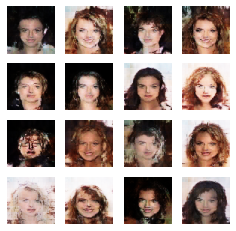

Epoch 15010, Discriminator: Loss: 0.08193889632821083 Accuracy: 0.990234375, Generator Loss: 5.856594562530518, Time: 5212.945487976074
Epoch 15020, Discriminator: Loss: 0.12955060228705406 Accuracy: 0.97265625, Generator Loss: 4.979586601257324, Time: 5216.339821338654
Epoch 15030, Discriminator: Loss: 0.1318810023367405 Accuracy: 0.97265625, Generator Loss: 5.1700286865234375, Time: 5219.754642963409
Epoch 15040, Discriminator: Loss: 0.27830371260643005 Accuracy: 0.958984375, Generator Loss: 6.780147075653076, Time: 5223.161581039429
Epoch 15050, Discriminator: Loss: 0.0748707726597786 Accuracy: 0.990234375, Generator Loss: 5.651886940002441, Time: 5226.561106443405
Epoch 15060, Discriminator: Loss: 0.07649420946836472 Accuracy: 0.984375, Generator Loss: 6.018854141235352, Time: 5229.97594666481
Epoch 15070, Discriminator: Loss: 0.5323242247104645 Accuracy: 0.91796875, Generator Loss: 5.342471122741699, Time: 5233.408520698547
Epoch 15080, Discriminator: Loss: 0.0765460841357708 Accu

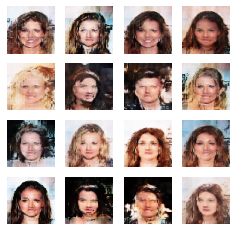

Epoch 15110, Discriminator: Loss: 0.2370055913925171 Accuracy: 0.953125, Generator Loss: 7.263296127319336, Time: 5247.7250463962555
Epoch 15120, Discriminator: Loss: 0.3162411004304886 Accuracy: 0.947265625, Generator Loss: 6.156702041625977, Time: 5251.119075059891
Epoch 15130, Discriminator: Loss: 0.06927048601210117 Accuracy: 0.986328125, Generator Loss: 6.994673728942871, Time: 5254.509763717651
Epoch 15140, Discriminator: Loss: 0.31311263889074326 Accuracy: 0.9296875, Generator Loss: 7.291635036468506, Time: 5257.888881206512
Epoch 15150, Discriminator: Loss: 0.10195085778832436 Accuracy: 0.978515625, Generator Loss: 5.780019760131836, Time: 5261.275027990341
Epoch 15160, Discriminator: Loss: 0.06096085347235203 Accuracy: 0.990234375, Generator Loss: 6.612601280212402, Time: 5264.665941953659
Epoch 15170, Discriminator: Loss: 0.07640430331230164 Accuracy: 0.984375, Generator Loss: 8.221732139587402, Time: 5268.054329395294
Epoch 15180, Discriminator: Loss: 0.15623889490962029 Acc

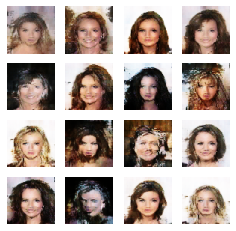

Epoch 15210, Discriminator: Loss: 0.12107615917921066 Accuracy: 0.98046875, Generator Loss: 5.386455535888672, Time: 5282.292416095734
Epoch 15220, Discriminator: Loss: 0.15341118723154068 Accuracy: 0.970703125, Generator Loss: 6.292614936828613, Time: 5285.674882650375
Epoch 15230, Discriminator: Loss: 0.15823370590806007 Accuracy: 0.97265625, Generator Loss: 5.648637771606445, Time: 5289.036677122116
Epoch 15240, Discriminator: Loss: 0.14044513553380966 Accuracy: 0.98046875, Generator Loss: 6.501855850219727, Time: 5292.411516666412
Epoch 15250, Discriminator: Loss: 0.07103426568210125 Accuracy: 0.986328125, Generator Loss: 5.627810001373291, Time: 5295.787022829056
Epoch 15260, Discriminator: Loss: 0.08220420777797699 Accuracy: 0.990234375, Generator Loss: 5.824519157409668, Time: 5299.149884700775
Epoch 15270, Discriminator: Loss: 0.10007806122303009 Accuracy: 0.982421875, Generator Loss: 6.384262561798096, Time: 5302.517897129059
Epoch 15280, Discriminator: Loss: 0.091279681771993

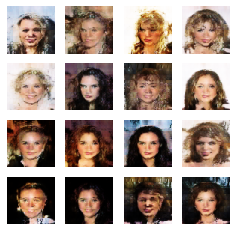

Epoch 15310, Discriminator: Loss: 0.1584077924489975 Accuracy: 0.966796875, Generator Loss: 6.052459716796875, Time: 5317.025690317154
Epoch 15320, Discriminator: Loss: 0.11013367772102356 Accuracy: 0.982421875, Generator Loss: 5.7539963722229, Time: 5320.4037301540375
Epoch 15330, Discriminator: Loss: 0.05730672739446163 Accuracy: 0.9921875, Generator Loss: 6.266449928283691, Time: 5323.812880516052
Epoch 15340, Discriminator: Loss: 0.07816663756966591 Accuracy: 0.986328125, Generator Loss: 6.250618934631348, Time: 5327.2063064575195
Epoch 15350, Discriminator: Loss: 0.22039681673049927 Accuracy: 0.95703125, Generator Loss: 6.110599517822266, Time: 5330.5858035087585
Epoch 15360, Discriminator: Loss: 0.18734575062990189 Accuracy: 0.9765625, Generator Loss: 5.461369514465332, Time: 5333.956812381744
Epoch 15370, Discriminator: Loss: 0.07565058767795563 Accuracy: 0.990234375, Generator Loss: 6.07041072845459, Time: 5337.344356060028
Epoch 15380, Discriminator: Loss: 0.2466520294547081 A

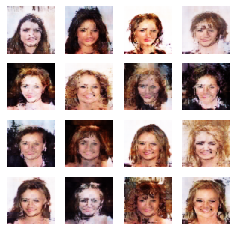

Epoch 15410, Discriminator: Loss: 0.20023896545171738 Accuracy: 0.96484375, Generator Loss: 8.003583908081055, Time: 5351.591616153717
Epoch 15420, Discriminator: Loss: 0.1377026028931141 Accuracy: 0.974609375, Generator Loss: 6.120819091796875, Time: 5354.965734243393
Epoch 15430, Discriminator: Loss: 0.18673154711723328 Accuracy: 0.96484375, Generator Loss: 5.87526798248291, Time: 5358.3443875312805
Epoch 15440, Discriminator: Loss: 0.06621759757399559 Accuracy: 0.9921875, Generator Loss: 6.225017547607422, Time: 5361.744467496872
Epoch 15450, Discriminator: Loss: 0.06873180344700813 Accuracy: 0.990234375, Generator Loss: 6.038095474243164, Time: 5365.122554302216
Epoch 15460, Discriminator: Loss: 0.04255542904138565 Accuracy: 0.99609375, Generator Loss: 6.326271057128906, Time: 5368.484194755554
Epoch 15470, Discriminator: Loss: 0.16055411845445633 Accuracy: 0.97265625, Generator Loss: 6.986328125, Time: 5371.869379997253
Epoch 15480, Discriminator: Loss: 0.1427292414009571 Accuracy

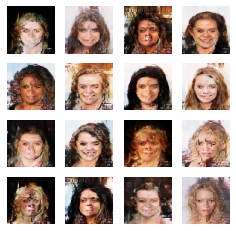

Epoch 15510, Discriminator: Loss: 0.11046378314495087 Accuracy: 0.986328125, Generator Loss: 6.131461143493652, Time: 5386.110701799393
Epoch 15520, Discriminator: Loss: 0.24460968375205994 Accuracy: 0.951171875, Generator Loss: 7.842560291290283, Time: 5389.489981651306
Epoch 15530, Discriminator: Loss: 0.199471240863204 Accuracy: 0.958984375, Generator Loss: 5.579617500305176, Time: 5392.873744487762
Epoch 15540, Discriminator: Loss: 0.05411246791481972 Accuracy: 0.998046875, Generator Loss: 5.997403144836426, Time: 5396.266579866409
Epoch 15550, Discriminator: Loss: 0.10787876322865486 Accuracy: 0.98046875, Generator Loss: 5.971701145172119, Time: 5399.636415719986
Epoch 15560, Discriminator: Loss: 0.11531579494476318 Accuracy: 0.986328125, Generator Loss: 5.4059906005859375, Time: 5403.00847864151
Epoch 15570, Discriminator: Loss: 0.07943440973758698 Accuracy: 0.984375, Generator Loss: 6.4136481285095215, Time: 5406.393370628357
Epoch 15580, Discriminator: Loss: 0.15647678822278976

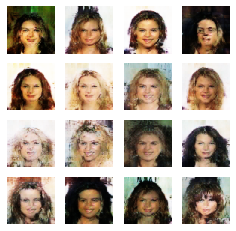

Epoch 15610, Discriminator: Loss: 0.1069309450685978 Accuracy: 0.986328125, Generator Loss: 6.209815979003906, Time: 5420.872565507889
Epoch 15620, Discriminator: Loss: 0.04886187054216862 Accuracy: 0.99609375, Generator Loss: 6.720975399017334, Time: 5424.253381729126
Epoch 15630, Discriminator: Loss: 0.15941433981060982 Accuracy: 0.958984375, Generator Loss: 5.787509918212891, Time: 5427.6429669857025
Epoch 15640, Discriminator: Loss: 0.10944535210728645 Accuracy: 0.986328125, Generator Loss: 5.473423957824707, Time: 5431.01914024353
Epoch 15650, Discriminator: Loss: 0.04829344153404236 Accuracy: 0.994140625, Generator Loss: 6.48775053024292, Time: 5434.400507211685
Epoch 15660, Discriminator: Loss: 0.0911479964852333 Accuracy: 0.978515625, Generator Loss: 7.1595964431762695, Time: 5437.7797565460205
Epoch 15670, Discriminator: Loss: 0.11128435656428337 Accuracy: 0.97265625, Generator Loss: 6.08058500289917, Time: 5441.15004825592
Epoch 15680, Discriminator: Loss: 0.12607651390135288

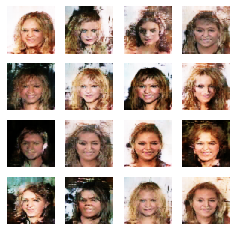

Epoch 15710, Discriminator: Loss: 0.09228718653321266 Accuracy: 0.986328125, Generator Loss: 6.148142337799072, Time: 5455.417809724808
Epoch 15720, Discriminator: Loss: 0.1296251267194748 Accuracy: 0.982421875, Generator Loss: 5.583511829376221, Time: 5458.7917692661285
Epoch 15730, Discriminator: Loss: 0.1615200862288475 Accuracy: 0.97265625, Generator Loss: 7.236788749694824, Time: 5462.168169260025
Epoch 15740, Discriminator: Loss: 0.09548393171280622 Accuracy: 0.9765625, Generator Loss: 6.940267562866211, Time: 5465.546745300293
Epoch 15750, Discriminator: Loss: 0.14619275741279125 Accuracy: 0.9765625, Generator Loss: 5.9087815284729, Time: 5468.914699316025
Epoch 15760, Discriminator: Loss: 0.1473573911935091 Accuracy: 0.97265625, Generator Loss: 5.379960536956787, Time: 5472.284745931625
Epoch 15770, Discriminator: Loss: 0.10957982018589973 Accuracy: 0.984375, Generator Loss: 5.683673858642578, Time: 5475.656873703003
Epoch 15780, Discriminator: Loss: 0.07550965622067451 Accurac

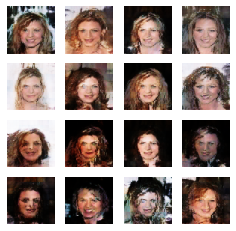

Epoch 15810, Discriminator: Loss: 0.15907757729291916 Accuracy: 0.962890625, Generator Loss: 5.727265357971191, Time: 5489.893483161926
Epoch 15820, Discriminator: Loss: 0.10858811065554619 Accuracy: 0.982421875, Generator Loss: 6.042079925537109, Time: 5493.279306650162
Epoch 15830, Discriminator: Loss: 0.17087825387716293 Accuracy: 0.97265625, Generator Loss: 6.489619255065918, Time: 5496.685494184494
Epoch 15840, Discriminator: Loss: 0.13662638515233994 Accuracy: 0.97265625, Generator Loss: 7.358048439025879, Time: 5500.0797572135925
Epoch 15850, Discriminator: Loss: 0.06156274303793907 Accuracy: 0.990234375, Generator Loss: 5.916370391845703, Time: 5503.461981058121
Epoch 15860, Discriminator: Loss: 0.11719023436307907 Accuracy: 0.98046875, Generator Loss: 6.398882865905762, Time: 5506.825438499451
Epoch 15870, Discriminator: Loss: 0.07639655843377113 Accuracy: 0.98828125, Generator Loss: 6.143426418304443, Time: 5510.205501317978
Epoch 15880, Discriminator: Loss: 0.113203916698694

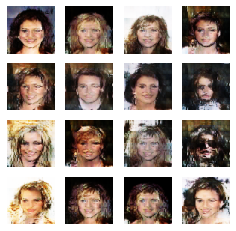

Epoch 15910, Discriminator: Loss: 0.17093192785978317 Accuracy: 0.974609375, Generator Loss: 6.659433364868164, Time: 5524.467619895935
Epoch 15920, Discriminator: Loss: 0.06983196176588535 Accuracy: 0.986328125, Generator Loss: 6.322905540466309, Time: 5527.8520131111145
Epoch 15930, Discriminator: Loss: 0.15071192383766174 Accuracy: 0.97265625, Generator Loss: 6.8547749519348145, Time: 5531.235334157944
Epoch 15940, Discriminator: Loss: 0.09343913942575455 Accuracy: 0.986328125, Generator Loss: 6.859533309936523, Time: 5534.608669757843
Epoch 15950, Discriminator: Loss: 0.0786639042198658 Accuracy: 0.98046875, Generator Loss: 6.255418300628662, Time: 5537.993799686432
Epoch 15960, Discriminator: Loss: 0.12477531749755144 Accuracy: 0.978515625, Generator Loss: 6.210657119750977, Time: 5541.365079641342
Epoch 15970, Discriminator: Loss: 0.13309229165315628 Accuracy: 0.982421875, Generator Loss: 6.325043678283691, Time: 5544.768399715424
Epoch 15980, Discriminator: Loss: 0.1169714964926

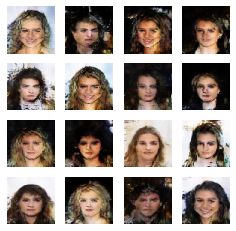

Epoch 16010, Discriminator: Loss: 0.08933086693286896 Accuracy: 0.98828125, Generator Loss: 6.208738803863525, Time: 5559.383985042572
Epoch 16020, Discriminator: Loss: 0.05045710504055023 Accuracy: 0.994140625, Generator Loss: 5.777862548828125, Time: 5562.778012752533
Epoch 16030, Discriminator: Loss: 0.10380354896187782 Accuracy: 0.98046875, Generator Loss: 5.412837505340576, Time: 5566.1503846645355
Epoch 16040, Discriminator: Loss: 0.15386439487338066 Accuracy: 0.96875, Generator Loss: 5.476960182189941, Time: 5569.522760152817
Epoch 16050, Discriminator: Loss: 0.1314927451312542 Accuracy: 0.9765625, Generator Loss: 6.9270148277282715, Time: 5572.8981590271
Epoch 16060, Discriminator: Loss: 0.06471883319318295 Accuracy: 0.98828125, Generator Loss: 5.55482292175293, Time: 5576.278556346893
Epoch 16070, Discriminator: Loss: 0.11894054710865021 Accuracy: 0.98046875, Generator Loss: 6.692781925201416, Time: 5579.668173074722
Epoch 16080, Discriminator: Loss: 0.17269140481948853 Accura

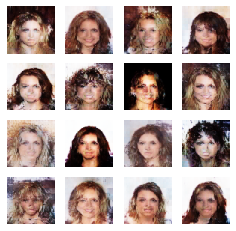

Epoch 16110, Discriminator: Loss: 0.23249277472496033 Accuracy: 0.94921875, Generator Loss: 6.66944694519043, Time: 5593.961386442184
Epoch 16120, Discriminator: Loss: 0.08962656557559967 Accuracy: 0.986328125, Generator Loss: 5.926010608673096, Time: 5597.362674951553
Epoch 16130, Discriminator: Loss: 0.11069304496049881 Accuracy: 0.984375, Generator Loss: 6.702132701873779, Time: 5600.757808923721
Epoch 16140, Discriminator: Loss: 0.08085697889328003 Accuracy: 0.990234375, Generator Loss: 6.199256896972656, Time: 5604.122087478638
Epoch 16150, Discriminator: Loss: 0.0988970622420311 Accuracy: 0.982421875, Generator Loss: 6.627614974975586, Time: 5607.495101928711
Epoch 16160, Discriminator: Loss: 0.06170216389000416 Accuracy: 0.98828125, Generator Loss: 7.275611400604248, Time: 5610.855356693268
Epoch 16170, Discriminator: Loss: 0.27847393974661827 Accuracy: 0.95703125, Generator Loss: 5.175450325012207, Time: 5614.207968950272
Epoch 16180, Discriminator: Loss: 0.045629244297742844 A

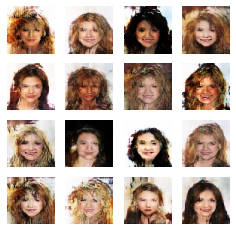

Epoch 16210, Discriminator: Loss: 0.06384077668190002 Accuracy: 0.984375, Generator Loss: 6.141831398010254, Time: 5628.333516359329
Epoch 16220, Discriminator: Loss: 0.06813066266477108 Accuracy: 0.990234375, Generator Loss: 5.688068389892578, Time: 5631.712562084198
Epoch 16230, Discriminator: Loss: 0.08100571855902672 Accuracy: 0.98828125, Generator Loss: 7.110906600952148, Time: 5635.075902223587
Epoch 16240, Discriminator: Loss: 0.15137530118227005 Accuracy: 0.962890625, Generator Loss: 7.8868865966796875, Time: 5638.42774438858
Epoch 16250, Discriminator: Loss: 0.21689964551478624 Accuracy: 0.96875, Generator Loss: 6.046182632446289, Time: 5641.773366928101
Epoch 16260, Discriminator: Loss: 0.04312990978360176 Accuracy: 0.994140625, Generator Loss: 6.334666728973389, Time: 5645.123641252518
Epoch 16270, Discriminator: Loss: 0.224497951567173 Accuracy: 0.953125, Generator Loss: 7.806046962738037, Time: 5648.4858939647675
Epoch 16280, Discriminator: Loss: 0.08562187105417252 Accura

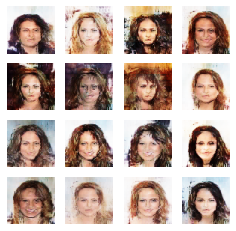

Epoch 16310, Discriminator: Loss: 0.062391793355345726 Accuracy: 0.986328125, Generator Loss: 6.661975860595703, Time: 5662.823631763458
Epoch 16320, Discriminator: Loss: 0.12757238373160362 Accuracy: 0.978515625, Generator Loss: 8.028386116027832, Time: 5666.169073104858
Epoch 16330, Discriminator: Loss: 0.08871950209140778 Accuracy: 0.986328125, Generator Loss: 6.205662727355957, Time: 5669.517503023148
Epoch 16340, Discriminator: Loss: 0.09818776696920395 Accuracy: 0.978515625, Generator Loss: 6.880942344665527, Time: 5672.864782810211
Epoch 16350, Discriminator: Loss: 0.08686835877597332 Accuracy: 0.984375, Generator Loss: 6.916197776794434, Time: 5676.231423139572
Epoch 16360, Discriminator: Loss: 0.09615994244813919 Accuracy: 0.982421875, Generator Loss: 6.505126953125, Time: 5679.587215662003
Epoch 16370, Discriminator: Loss: 0.20138563960790634 Accuracy: 0.96484375, Generator Loss: 7.615212440490723, Time: 5682.942291736603
Epoch 16380, Discriminator: Loss: 0.14338836446404457 

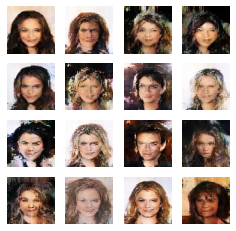

Epoch 16410, Discriminator: Loss: 0.07812712341547012 Accuracy: 0.986328125, Generator Loss: 5.644250869750977, Time: 5697.096768140793
Epoch 16420, Discriminator: Loss: 0.10457934997975826 Accuracy: 0.98046875, Generator Loss: 6.032229423522949, Time: 5700.433376550674
Epoch 16430, Discriminator: Loss: 0.9904122538864613 Accuracy: 0.853515625, Generator Loss: 3.864823341369629, Time: 5703.782253503799
Epoch 16440, Discriminator: Loss: 0.17404381930828094 Accuracy: 0.96875, Generator Loss: 4.848394393920898, Time: 5707.13978266716
Epoch 16450, Discriminator: Loss: 0.12351113185286522 Accuracy: 0.986328125, Generator Loss: 5.804720401763916, Time: 5710.498116731644
Epoch 16460, Discriminator: Loss: 0.13743766956031322 Accuracy: 0.970703125, Generator Loss: 5.6428985595703125, Time: 5713.834681987762
Epoch 16470, Discriminator: Loss: 0.12976563349366188 Accuracy: 0.974609375, Generator Loss: 5.942030429840088, Time: 5717.181251525879
Epoch 16480, Discriminator: Loss: 0.20589767396450043 

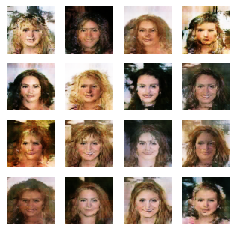

Epoch 16510, Discriminator: Loss: 0.15537714213132858 Accuracy: 0.97265625, Generator Loss: 7.51470947265625, Time: 5731.314205169678
Epoch 16520, Discriminator: Loss: 0.08097998797893524 Accuracy: 0.986328125, Generator Loss: 6.418511867523193, Time: 5734.682670354843
Epoch 16530, Discriminator: Loss: 0.039186254143714905 Accuracy: 0.994140625, Generator Loss: 7.01718807220459, Time: 5738.048830747604
Epoch 16540, Discriminator: Loss: 0.0946640744805336 Accuracy: 0.986328125, Generator Loss: 7.078797817230225, Time: 5741.395244598389
Epoch 16550, Discriminator: Loss: 0.08687702566385269 Accuracy: 0.982421875, Generator Loss: 6.489981651306152, Time: 5744.749249458313
Epoch 16560, Discriminator: Loss: 0.08242297638207674 Accuracy: 0.986328125, Generator Loss: 6.494266986846924, Time: 5748.0863337516785
Epoch 16570, Discriminator: Loss: 0.054404785856604576 Accuracy: 0.994140625, Generator Loss: 6.093050479888916, Time: 5751.432881832123
Epoch 16580, Discriminator: Loss: 0.1283552758395

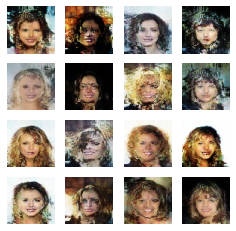

Epoch 16610, Discriminator: Loss: 0.09631866589188576 Accuracy: 0.984375, Generator Loss: 6.199390888214111, Time: 5765.517502307892
Epoch 16620, Discriminator: Loss: 0.04163505509495735 Accuracy: 0.994140625, Generator Loss: 7.002823829650879, Time: 5768.873478651047
Epoch 16630, Discriminator: Loss: 0.07787776738405228 Accuracy: 0.98828125, Generator Loss: 5.790290832519531, Time: 5772.218843221664
Epoch 16640, Discriminator: Loss: 0.15778913162648678 Accuracy: 0.9765625, Generator Loss: 6.027958869934082, Time: 5775.548550367355
Epoch 16650, Discriminator: Loss: 0.08302399516105652 Accuracy: 0.982421875, Generator Loss: 6.222122669219971, Time: 5778.890052080154
Epoch 16660, Discriminator: Loss: 0.08704181760549545 Accuracy: 0.986328125, Generator Loss: 6.974885940551758, Time: 5782.223146915436
Epoch 16670, Discriminator: Loss: 0.04965973924845457 Accuracy: 0.9921875, Generator Loss: 6.480790138244629, Time: 5785.568129777908
Epoch 16680, Discriminator: Loss: 0.1940007582306862 Acc

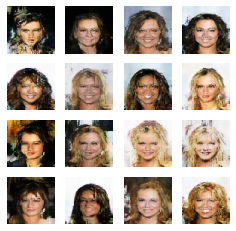

Epoch 16710, Discriminator: Loss: 0.09050299972295761 Accuracy: 0.98046875, Generator Loss: 5.951488971710205, Time: 5799.935293197632
Epoch 16720, Discriminator: Loss: 0.12295546755194664 Accuracy: 0.978515625, Generator Loss: 6.154991149902344, Time: 5803.285349369049
Epoch 16730, Discriminator: Loss: 0.06377158872783184 Accuracy: 0.990234375, Generator Loss: 6.945610046386719, Time: 5806.637980699539
Epoch 16740, Discriminator: Loss: 0.08855431154370308 Accuracy: 0.982421875, Generator Loss: 7.440568447113037, Time: 5809.99363899231
Epoch 16750, Discriminator: Loss: 0.11765531450510025 Accuracy: 0.98046875, Generator Loss: 5.5440778732299805, Time: 5813.350944519043
Epoch 16760, Discriminator: Loss: 0.14301659166812897 Accuracy: 0.9765625, Generator Loss: 7.035477161407471, Time: 5816.694547653198
Epoch 16770, Discriminator: Loss: 0.10027121007442474 Accuracy: 0.984375, Generator Loss: 5.942829608917236, Time: 5820.05051112175
Epoch 16780, Discriminator: Loss: 0.084232147783041 Accu

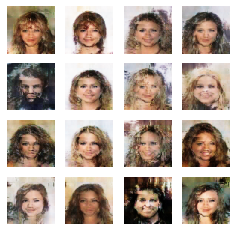

Epoch 16810, Discriminator: Loss: 0.12577957287430763 Accuracy: 0.978515625, Generator Loss: 6.308356285095215, Time: 5834.1650314331055
Epoch 16820, Discriminator: Loss: 0.1028476394712925 Accuracy: 0.986328125, Generator Loss: 6.964792728424072, Time: 5837.509171247482
Epoch 16830, Discriminator: Loss: 0.17260700464248657 Accuracy: 0.96875, Generator Loss: 7.205801963806152, Time: 5840.857171297073
Epoch 16840, Discriminator: Loss: 0.051018839702010155 Accuracy: 0.9921875, Generator Loss: 6.175857067108154, Time: 5844.214329481125
Epoch 16850, Discriminator: Loss: 0.06643720157444477 Accuracy: 0.986328125, Generator Loss: 6.782148838043213, Time: 5847.554953098297
Epoch 16860, Discriminator: Loss: 0.11285806819796562 Accuracy: 0.970703125, Generator Loss: 5.69443416595459, Time: 5850.900716781616
Epoch 16870, Discriminator: Loss: 0.14969316124916077 Accuracy: 0.970703125, Generator Loss: 7.308993339538574, Time: 5854.27210521698
Epoch 16880, Discriminator: Loss: 0.05465288273990154 A

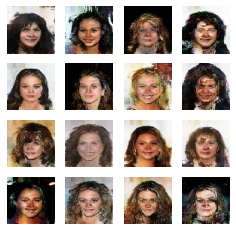

Epoch 16910, Discriminator: Loss: 0.19200985878705978 Accuracy: 0.962890625, Generator Loss: 6.672482013702393, Time: 5868.473163366318
Epoch 16920, Discriminator: Loss: 0.0323108765296638 Accuracy: 0.998046875, Generator Loss: 6.1375250816345215, Time: 5871.802693605423
Epoch 16930, Discriminator: Loss: 0.09257288463413715 Accuracy: 0.984375, Generator Loss: 6.223799705505371, Time: 5875.161092281342
Epoch 16940, Discriminator: Loss: 0.12244385480880737 Accuracy: 0.982421875, Generator Loss: 7.453648567199707, Time: 5878.507291555405
Epoch 16950, Discriminator: Loss: 0.10867099463939667 Accuracy: 0.982421875, Generator Loss: 6.402175426483154, Time: 5881.852770090103
Epoch 16960, Discriminator: Loss: 0.13825245946645737 Accuracy: 0.974609375, Generator Loss: 7.021183490753174, Time: 5885.190125465393
Epoch 16970, Discriminator: Loss: 0.07199938222765923 Accuracy: 0.99609375, Generator Loss: 6.191376209259033, Time: 5888.537086486816
Epoch 16980, Discriminator: Loss: 0.0616817343980073

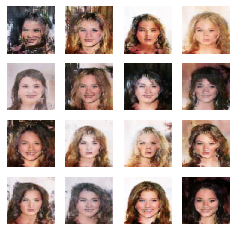

Epoch 17010, Discriminator: Loss: 0.05938529223203659 Accuracy: 0.984375, Generator Loss: 6.743234157562256, Time: 5902.971220970154
Epoch 17020, Discriminator: Loss: 0.0640878789126873 Accuracy: 0.990234375, Generator Loss: 6.858156204223633, Time: 5906.321036100388
Epoch 17030, Discriminator: Loss: 0.13791873678565025 Accuracy: 0.9765625, Generator Loss: 7.139698505401611, Time: 5909.667371749878
Epoch 17040, Discriminator: Loss: 0.05585411936044693 Accuracy: 0.990234375, Generator Loss: 6.2137451171875, Time: 5913.013342857361
Epoch 17050, Discriminator: Loss: 0.1275506243109703 Accuracy: 0.978515625, Generator Loss: 5.751676082611084, Time: 5916.371470928192
Epoch 17060, Discriminator: Loss: 0.14407268166542053 Accuracy: 0.9765625, Generator Loss: 5.7499918937683105, Time: 5919.70937538147
Epoch 17070, Discriminator: Loss: 0.07317951694130898 Accuracy: 0.984375, Generator Loss: 6.527260780334473, Time: 5923.065606832504
Epoch 17080, Discriminator: Loss: 0.07507074624300003 Accuracy

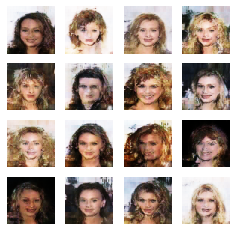

Epoch 17110, Discriminator: Loss: 0.08601681143045425 Accuracy: 0.986328125, Generator Loss: 6.15364408493042, Time: 5937.290111780167
Epoch 17120, Discriminator: Loss: 0.09278023056685925 Accuracy: 0.982421875, Generator Loss: 6.1870527267456055, Time: 5940.6452078819275
Epoch 17130, Discriminator: Loss: 0.047922659665346146 Accuracy: 0.994140625, Generator Loss: 6.993704319000244, Time: 5943.985366344452
Epoch 17140, Discriminator: Loss: 0.08031148090958595 Accuracy: 0.9921875, Generator Loss: 5.69873046875, Time: 5947.328056812286
Epoch 17150, Discriminator: Loss: 0.08767178934067488 Accuracy: 0.984375, Generator Loss: 6.401371002197266, Time: 5950.667078495026
Epoch 17160, Discriminator: Loss: 0.07772033847868443 Accuracy: 0.984375, Generator Loss: 6.201371669769287, Time: 5954.0100202560425
Epoch 17170, Discriminator: Loss: 0.07934966869652271 Accuracy: 0.990234375, Generator Loss: 6.826713562011719, Time: 5957.361132621765
Epoch 17180, Discriminator: Loss: 0.06391361635178328 Acc

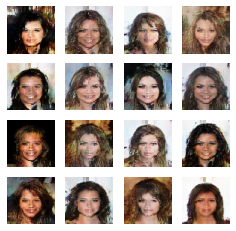

Epoch 17210, Discriminator: Loss: 0.08510701730847359 Accuracy: 0.982421875, Generator Loss: 7.022271156311035, Time: 5971.497180938721
Epoch 17220, Discriminator: Loss: 0.06501984037458897 Accuracy: 0.986328125, Generator Loss: 6.368545055389404, Time: 5974.858422994614
Epoch 17230, Discriminator: Loss: 0.04308378975838423 Accuracy: 0.994140625, Generator Loss: 6.179008483886719, Time: 5978.202554941177
Epoch 17240, Discriminator: Loss: 0.05224260501563549 Accuracy: 0.98828125, Generator Loss: 6.240553855895996, Time: 5981.559159517288
Epoch 17250, Discriminator: Loss: 0.08908384665846825 Accuracy: 0.986328125, Generator Loss: 6.35107421875, Time: 5984.916695594788
Epoch 17260, Discriminator: Loss: 0.10136096179485321 Accuracy: 0.982421875, Generator Loss: 6.383650779724121, Time: 5988.247712612152
Epoch 17270, Discriminator: Loss: 0.08145961165428162 Accuracy: 0.986328125, Generator Loss: 6.510837078094482, Time: 5991.590293884277
Epoch 17280, Discriminator: Loss: 0.13383806869387627

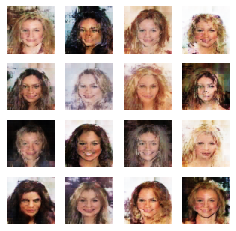

Epoch 17310, Discriminator: Loss: 0.07226527482271194 Accuracy: 0.990234375, Generator Loss: 5.441352844238281, Time: 6005.7347757816315
Epoch 17320, Discriminator: Loss: 0.1340857297182083 Accuracy: 0.97265625, Generator Loss: 6.394155502319336, Time: 6009.090779304504
Epoch 17330, Discriminator: Loss: 0.1366036757826805 Accuracy: 0.982421875, Generator Loss: 5.2351555824279785, Time: 6012.434303998947
Epoch 17340, Discriminator: Loss: 0.06192255578935146 Accuracy: 0.98828125, Generator Loss: 6.158161163330078, Time: 6015.774664402008
Epoch 17350, Discriminator: Loss: 0.09049835801124573 Accuracy: 0.98828125, Generator Loss: 5.881227970123291, Time: 6019.113523244858
Epoch 17360, Discriminator: Loss: 0.17280884366482496 Accuracy: 0.970703125, Generator Loss: 6.424810886383057, Time: 6022.446164608002
Epoch 17370, Discriminator: Loss: 0.08890490606427193 Accuracy: 0.984375, Generator Loss: 6.569214820861816, Time: 6025.802401065826
Epoch 17380, Discriminator: Loss: 0.06127048842608929 

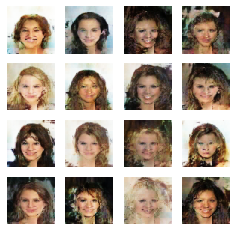

Epoch 17410, Discriminator: Loss: 0.09990580379962921 Accuracy: 0.98046875, Generator Loss: 5.93802547454834, Time: 6040.240980625153
Epoch 17420, Discriminator: Loss: 0.05938190780580044 Accuracy: 0.990234375, Generator Loss: 5.951769828796387, Time: 6043.592886924744
Epoch 17430, Discriminator: Loss: 0.06301804631948471 Accuracy: 0.9921875, Generator Loss: 7.768124580383301, Time: 6046.941867351532
Epoch 17440, Discriminator: Loss: 0.05938137322664261 Accuracy: 0.990234375, Generator Loss: 6.594051837921143, Time: 6050.307337284088
Epoch 17450, Discriminator: Loss: 0.05972230061888695 Accuracy: 0.98828125, Generator Loss: 6.554503440856934, Time: 6053.679072856903
Epoch 17460, Discriminator: Loss: 0.07356821186840534 Accuracy: 0.990234375, Generator Loss: 6.508296966552734, Time: 6057.006827831268
Epoch 17470, Discriminator: Loss: 0.022077803499996662 Accuracy: 1.0, Generator Loss: 7.609569549560547, Time: 6060.332698345184
Epoch 17480, Discriminator: Loss: 0.0809844359755516 Accurac

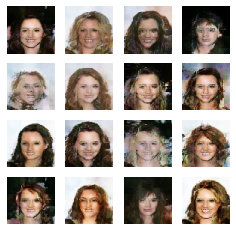

Epoch 17510, Discriminator: Loss: 0.07758062705397606 Accuracy: 0.982421875, Generator Loss: 6.709821701049805, Time: 6074.395147800446
Epoch 17520, Discriminator: Loss: 0.17373107373714447 Accuracy: 0.97265625, Generator Loss: 6.938832759857178, Time: 6077.733717441559
Epoch 17530, Discriminator: Loss: 0.055079289712011814 Accuracy: 0.990234375, Generator Loss: 7.518033981323242, Time: 6081.079298734665
Epoch 17540, Discriminator: Loss: 0.05827457830309868 Accuracy: 0.98828125, Generator Loss: 6.3646392822265625, Time: 6084.4148645401
Epoch 17550, Discriminator: Loss: 0.08267506957054138 Accuracy: 0.98828125, Generator Loss: 5.872817039489746, Time: 6087.744054079056
Epoch 17560, Discriminator: Loss: 0.08845218643546104 Accuracy: 0.986328125, Generator Loss: 6.008579730987549, Time: 6091.078936815262
Epoch 17570, Discriminator: Loss: 0.08374790102243423 Accuracy: 0.98046875, Generator Loss: 6.648932933807373, Time: 6094.410501003265
Epoch 17580, Discriminator: Loss: 0.0962850563228130

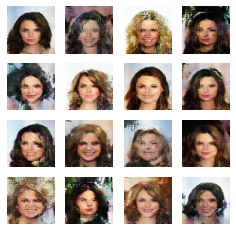

Epoch 17610, Discriminator: Loss: 0.04791618883609772 Accuracy: 0.9921875, Generator Loss: 6.666762828826904, Time: 6108.443436861038
Epoch 17620, Discriminator: Loss: 0.057605912908911705 Accuracy: 0.98828125, Generator Loss: 6.452020168304443, Time: 6111.769389629364
Epoch 17630, Discriminator: Loss: 0.08252442814409733 Accuracy: 0.98828125, Generator Loss: 6.270975112915039, Time: 6115.110089540482
Epoch 17640, Discriminator: Loss: 0.17366936430335045 Accuracy: 0.97265625, Generator Loss: 6.52223014831543, Time: 6118.439798593521
Epoch 17650, Discriminator: Loss: 0.09676225949078798 Accuracy: 0.978515625, Generator Loss: 6.836628437042236, Time: 6121.778426170349
Epoch 17660, Discriminator: Loss: 0.10859158635139465 Accuracy: 0.978515625, Generator Loss: 5.781210899353027, Time: 6125.104073047638
Epoch 17670, Discriminator: Loss: 0.23405364155769348 Accuracy: 0.947265625, Generator Loss: 8.278388023376465, Time: 6128.461833953857
Epoch 17680, Discriminator: Loss: 0.07660729438066483

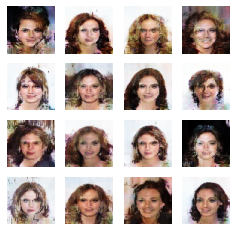

Epoch 17710, Discriminator: Loss: 0.1840459704399109 Accuracy: 0.970703125, Generator Loss: 6.972871780395508, Time: 6142.822124242783
Epoch 17720, Discriminator: Loss: 0.18082577735185623 Accuracy: 0.96875, Generator Loss: 7.394369125366211, Time: 6146.171626329422
Epoch 17730, Discriminator: Loss: 0.0969376303255558 Accuracy: 0.98046875, Generator Loss: 6.53217887878418, Time: 6149.5146861076355
Epoch 17740, Discriminator: Loss: 0.1380479782819748 Accuracy: 0.970703125, Generator Loss: 5.809357166290283, Time: 6152.865217924118
Epoch 17750, Discriminator: Loss: 0.06580349802970886 Accuracy: 0.98828125, Generator Loss: 6.612220764160156, Time: 6156.198440790176
Epoch 17760, Discriminator: Loss: 0.12188809178769588 Accuracy: 0.98046875, Generator Loss: 6.314899444580078, Time: 6159.544114112854
Epoch 17770, Discriminator: Loss: 0.06590400263667107 Accuracy: 0.990234375, Generator Loss: 5.928933143615723, Time: 6162.900074481964
Epoch 17780, Discriminator: Loss: 0.11841531097888947 Accu

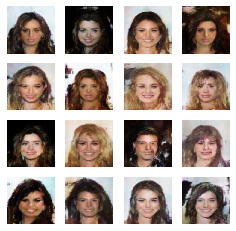

Epoch 17810, Discriminator: Loss: 0.09652965143322945 Accuracy: 0.984375, Generator Loss: 5.236813545227051, Time: 6177.082939624786
Epoch 17820, Discriminator: Loss: 0.07891793176531792 Accuracy: 0.982421875, Generator Loss: 6.214372634887695, Time: 6180.42401766777
Epoch 17830, Discriminator: Loss: 0.14528701081871986 Accuracy: 0.974609375, Generator Loss: 6.702212333679199, Time: 6183.767829656601
Epoch 17840, Discriminator: Loss: 0.16773167997598648 Accuracy: 0.970703125, Generator Loss: 5.120957851409912, Time: 6187.127002716064
Epoch 17850, Discriminator: Loss: 0.09018705412745476 Accuracy: 0.984375, Generator Loss: 6.557386875152588, Time: 6190.496577978134
Epoch 17860, Discriminator: Loss: 0.08373796939849854 Accuracy: 0.986328125, Generator Loss: 6.177818775177002, Time: 6193.863854169846
Epoch 17870, Discriminator: Loss: 0.12492956966161728 Accuracy: 0.9765625, Generator Loss: 7.647502422332764, Time: 6197.242045879364
Epoch 17880, Discriminator: Loss: 0.12464259564876556 Acc

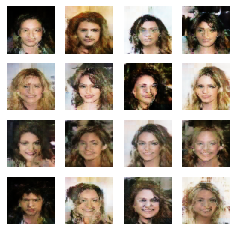

Epoch 17910, Discriminator: Loss: 0.06759214028716087 Accuracy: 0.9921875, Generator Loss: 6.098180294036865, Time: 6211.481228351593
Epoch 17920, Discriminator: Loss: 0.10331572964787483 Accuracy: 0.982421875, Generator Loss: 6.30960750579834, Time: 6214.845525979996
Epoch 17930, Discriminator: Loss: 0.07711470685899258 Accuracy: 0.984375, Generator Loss: 6.242023944854736, Time: 6218.209135770798
Epoch 17940, Discriminator: Loss: 0.23402238637208939 Accuracy: 0.958984375, Generator Loss: 5.720156192779541, Time: 6221.566563129425
Epoch 17950, Discriminator: Loss: 0.11255737394094467 Accuracy: 0.984375, Generator Loss: 5.489844799041748, Time: 6224.922941446304
Epoch 17960, Discriminator: Loss: 0.06386875919997692 Accuracy: 0.98828125, Generator Loss: 7.120250225067139, Time: 6228.27717256546
Epoch 17970, Discriminator: Loss: 0.04400677792727947 Accuracy: 0.9921875, Generator Loss: 6.804094314575195, Time: 6231.650595664978
Epoch 17980, Discriminator: Loss: 0.0645721098408103 Accuracy

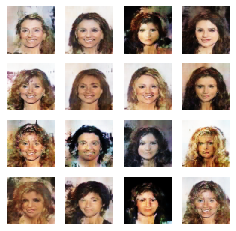

Epoch 18010, Discriminator: Loss: 0.07488912343978882 Accuracy: 0.98046875, Generator Loss: 6.702731132507324, Time: 6245.85941529274
Epoch 18020, Discriminator: Loss: 0.1625549248419702 Accuracy: 0.966796875, Generator Loss: 6.231666564941406, Time: 6249.226043224335
Epoch 18030, Discriminator: Loss: 0.11296257562935352 Accuracy: 0.98046875, Generator Loss: 6.177971839904785, Time: 6252.597744941711
Epoch 18040, Discriminator: Loss: 0.05103081092238426 Accuracy: 0.99609375, Generator Loss: 6.100285530090332, Time: 6255.949050664902
Epoch 18050, Discriminator: Loss: 0.06826039776206017 Accuracy: 0.990234375, Generator Loss: 6.620367527008057, Time: 6259.3010160923
Epoch 18060, Discriminator: Loss: 0.09170808643102646 Accuracy: 0.984375, Generator Loss: 5.103181838989258, Time: 6262.655249595642
Epoch 18070, Discriminator: Loss: 0.08834507688879967 Accuracy: 0.984375, Generator Loss: 6.526832103729248, Time: 6266.025399446487
Epoch 18080, Discriminator: Loss: 0.10869651287794113 Accurac

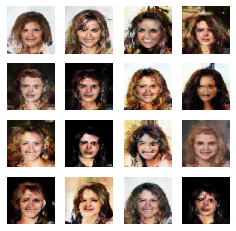

Epoch 18110, Discriminator: Loss: 0.07312439754605293 Accuracy: 0.98828125, Generator Loss: 6.936028957366943, Time: 6280.4982216358185
Epoch 18120, Discriminator: Loss: 0.19782252609729767 Accuracy: 0.974609375, Generator Loss: 6.474386692047119, Time: 6283.856629371643
Epoch 18130, Discriminator: Loss: 0.2163417711853981 Accuracy: 0.96484375, Generator Loss: 6.898963928222656, Time: 6287.2113173007965
Epoch 18140, Discriminator: Loss: 0.07875336147844791 Accuracy: 0.98828125, Generator Loss: 6.797516822814941, Time: 6290.5626447200775
Epoch 18150, Discriminator: Loss: 0.23688730224967003 Accuracy: 0.958984375, Generator Loss: 5.22398042678833, Time: 6293.939689874649
Epoch 18160, Discriminator: Loss: 0.06834203004837036 Accuracy: 0.98828125, Generator Loss: 5.944496154785156, Time: 6297.289363145828
Epoch 18170, Discriminator: Loss: 0.08382166549563408 Accuracy: 0.98046875, Generator Loss: 6.641905784606934, Time: 6300.669799089432
Epoch 18180, Discriminator: Loss: 0.0847349707037210

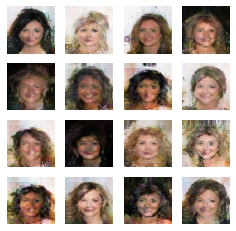

Epoch 18210, Discriminator: Loss: 0.05360711179673672 Accuracy: 0.98828125, Generator Loss: 6.828219413757324, Time: 6314.841241359711
Epoch 18220, Discriminator: Loss: 0.16203387081623077 Accuracy: 0.96875, Generator Loss: 6.933486461639404, Time: 6318.195697546005
Epoch 18230, Discriminator: Loss: 0.10350766219198704 Accuracy: 0.984375, Generator Loss: 6.957737445831299, Time: 6321.55676150322
Epoch 18240, Discriminator: Loss: 0.0654056966304779 Accuracy: 0.990234375, Generator Loss: 6.344505786895752, Time: 6324.923028707504
Epoch 18250, Discriminator: Loss: 0.1006598137319088 Accuracy: 0.978515625, Generator Loss: 6.834052085876465, Time: 6328.279385328293
Epoch 18260, Discriminator: Loss: 0.06944783963263035 Accuracy: 0.986328125, Generator Loss: 6.886693954467773, Time: 6331.6298570632935
Epoch 18270, Discriminator: Loss: 0.07463212218135595 Accuracy: 0.982421875, Generator Loss: 6.234813690185547, Time: 6334.9907579422
Epoch 18280, Discriminator: Loss: 0.05985969305038452 Accura

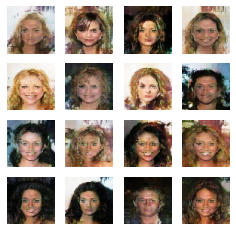

Epoch 18310, Discriminator: Loss: 0.04966161772608757 Accuracy: 0.9921875, Generator Loss: 6.569978713989258, Time: 6349.1256737709045
Epoch 18320, Discriminator: Loss: 0.09074420388787985 Accuracy: 0.9765625, Generator Loss: 6.924290657043457, Time: 6352.486258983612
Epoch 18330, Discriminator: Loss: 0.07636523246765137 Accuracy: 0.986328125, Generator Loss: 6.4795331954956055, Time: 6355.870618343353
Epoch 18340, Discriminator: Loss: 0.09773114323616028 Accuracy: 0.984375, Generator Loss: 6.5708465576171875, Time: 6359.2163853645325
Epoch 18350, Discriminator: Loss: 0.061194224283099174 Accuracy: 0.98828125, Generator Loss: 6.2388763427734375, Time: 6362.569522380829
Epoch 18360, Discriminator: Loss: 0.0731394775211811 Accuracy: 0.98828125, Generator Loss: 6.4869866371154785, Time: 6365.914945602417
Epoch 18370, Discriminator: Loss: 0.22935454174876213 Accuracy: 0.9609375, Generator Loss: 5.634838581085205, Time: 6369.258034467697
Epoch 18380, Discriminator: Loss: 0.06773833930492401

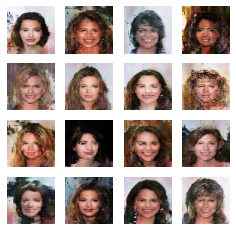

Epoch 18410, Discriminator: Loss: 0.15377406030893326 Accuracy: 0.9765625, Generator Loss: 7.070805549621582, Time: 6383.633230686188
Epoch 18420, Discriminator: Loss: 0.09227975457906723 Accuracy: 0.984375, Generator Loss: 5.736907482147217, Time: 6386.987506866455
Epoch 18430, Discriminator: Loss: 0.06682065315544605 Accuracy: 0.984375, Generator Loss: 6.013857364654541, Time: 6390.340570449829
Epoch 18440, Discriminator: Loss: 0.19920050352811813 Accuracy: 0.958984375, Generator Loss: 7.855384826660156, Time: 6393.690101861954
Epoch 18450, Discriminator: Loss: 0.1011376865208149 Accuracy: 0.98828125, Generator Loss: 6.575852394104004, Time: 6397.049636363983
Epoch 18460, Discriminator: Loss: 0.08089754730463028 Accuracy: 0.986328125, Generator Loss: 6.648979663848877, Time: 6400.395369052887
Epoch 18470, Discriminator: Loss: 0.08781800791621208 Accuracy: 0.982421875, Generator Loss: 6.94025182723999, Time: 6403.744780778885
Epoch 18480, Discriminator: Loss: 0.0523625873029232 Accura

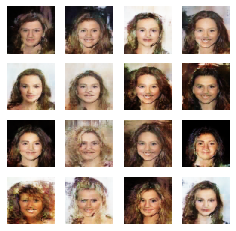

Epoch 18510, Discriminator: Loss: 0.06390699557960033 Accuracy: 0.990234375, Generator Loss: 7.094271183013916, Time: 6417.910847187042
Epoch 18520, Discriminator: Loss: 0.06826245598495007 Accuracy: 0.98828125, Generator Loss: 6.406223773956299, Time: 6421.260940551758
Epoch 18530, Discriminator: Loss: 0.0528667401522398 Accuracy: 0.98828125, Generator Loss: 6.8840131759643555, Time: 6424.62676525116
Epoch 18540, Discriminator: Loss: 0.0321654137223959 Accuracy: 0.998046875, Generator Loss: 7.1311774253845215, Time: 6428.000865936279
Epoch 18550, Discriminator: Loss: 0.046560467686504126 Accuracy: 0.9921875, Generator Loss: 6.931539535522461, Time: 6431.351498365402
Epoch 18560, Discriminator: Loss: 0.04579691402614117 Accuracy: 0.994140625, Generator Loss: 5.769689083099365, Time: 6434.692414045334
Epoch 18570, Discriminator: Loss: 0.07882955484092236 Accuracy: 0.986328125, Generator Loss: 6.570014953613281, Time: 6438.046074151993
Epoch 18580, Discriminator: Loss: 0.0487770959734916

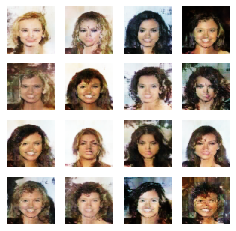

Epoch 18610, Discriminator: Loss: 0.13996651396155357 Accuracy: 0.9765625, Generator Loss: 7.434196949005127, Time: 6452.193832397461
Epoch 18620, Discriminator: Loss: 0.04721053410321474 Accuracy: 0.998046875, Generator Loss: 7.007715702056885, Time: 6455.550951719284
Epoch 18630, Discriminator: Loss: 0.09242758899927139 Accuracy: 0.986328125, Generator Loss: 7.092513561248779, Time: 6458.9034106731415
Epoch 18640, Discriminator: Loss: 0.15521877072751522 Accuracy: 0.9765625, Generator Loss: 6.888792514801025, Time: 6462.272374153137
Epoch 18650, Discriminator: Loss: 0.1691480316221714 Accuracy: 0.96484375, Generator Loss: 6.064087867736816, Time: 6465.630032300949
Epoch 18660, Discriminator: Loss: 0.08550575189292431 Accuracy: 0.982421875, Generator Loss: 6.441981315612793, Time: 6468.982517242432
Epoch 18670, Discriminator: Loss: 0.07426463067531586 Accuracy: 0.986328125, Generator Loss: 6.270168781280518, Time: 6472.3377249240875
Epoch 18680, Discriminator: Loss: 0.0602079071104526

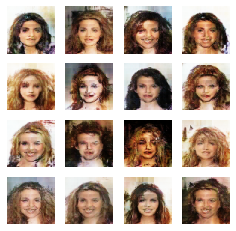

Epoch 18710, Discriminator: Loss: 0.058044685050845146 Accuracy: 0.986328125, Generator Loss: 6.612849712371826, Time: 6486.626846551895
Epoch 18720, Discriminator: Loss: 0.08663440868258476 Accuracy: 0.98828125, Generator Loss: 6.8472442626953125, Time: 6489.980333328247
Epoch 18730, Discriminator: Loss: 0.12952103093266487 Accuracy: 0.9765625, Generator Loss: 7.138428211212158, Time: 6493.328122854233
Epoch 18740, Discriminator: Loss: 0.09984370321035385 Accuracy: 0.984375, Generator Loss: 6.778339385986328, Time: 6496.686138868332
Epoch 18750, Discriminator: Loss: 0.07020813971757889 Accuracy: 0.984375, Generator Loss: 7.525437831878662, Time: 6500.046220541
Epoch 18760, Discriminator: Loss: 0.04707605019211769 Accuracy: 0.98828125, Generator Loss: 6.385472297668457, Time: 6503.397191762924
Epoch 18770, Discriminator: Loss: 0.08341964520514011 Accuracy: 0.986328125, Generator Loss: 7.497901439666748, Time: 6506.761342048645
Epoch 18780, Discriminator: Loss: 0.06961368024349213 Accur

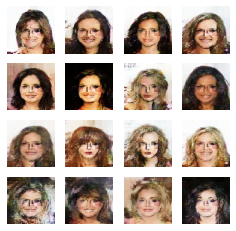

Epoch 18810, Discriminator: Loss: 0.06497288681566715 Accuracy: 0.9921875, Generator Loss: 7.254858493804932, Time: 6521.181038141251
Epoch 18820, Discriminator: Loss: 0.07005576975643635 Accuracy: 0.98828125, Generator Loss: 6.281829357147217, Time: 6524.530467987061
Epoch 18830, Discriminator: Loss: 0.08061212301254272 Accuracy: 0.984375, Generator Loss: 7.150097370147705, Time: 6527.879359722137
Epoch 18840, Discriminator: Loss: 0.11478936392813921 Accuracy: 0.984375, Generator Loss: 7.363720893859863, Time: 6531.233682155609
Epoch 18850, Discriminator: Loss: 0.10940195620059967 Accuracy: 0.982421875, Generator Loss: 7.363770008087158, Time: 6534.590362548828
Epoch 18860, Discriminator: Loss: 0.0778188668191433 Accuracy: 0.994140625, Generator Loss: 6.41444206237793, Time: 6537.934093475342
Epoch 18870, Discriminator: Loss: 0.03354227915406227 Accuracy: 0.9921875, Generator Loss: 7.14133882522583, Time: 6541.281466245651
Epoch 18880, Discriminator: Loss: 0.06471950560808182 Accuracy

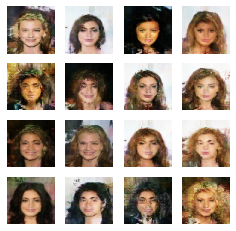

Epoch 18910, Discriminator: Loss: 0.11952714249491692 Accuracy: 0.978515625, Generator Loss: 8.521864891052246, Time: 6555.424978017807
Epoch 18920, Discriminator: Loss: 0.14038864523172379 Accuracy: 0.9765625, Generator Loss: 7.6243205070495605, Time: 6558.783310413361
Epoch 18930, Discriminator: Loss: 0.06454690545797348 Accuracy: 0.986328125, Generator Loss: 6.479923248291016, Time: 6562.131535291672
Epoch 18940, Discriminator: Loss: 0.06303343176841736 Accuracy: 0.986328125, Generator Loss: 6.38109827041626, Time: 6565.497473955154
Epoch 18950, Discriminator: Loss: 0.1124023087322712 Accuracy: 0.978515625, Generator Loss: 6.364190578460693, Time: 6568.8442170619965
Epoch 18960, Discriminator: Loss: 0.07504722941666842 Accuracy: 0.98828125, Generator Loss: 6.118497848510742, Time: 6572.1839962005615
Epoch 18970, Discriminator: Loss: 0.0738726444542408 Accuracy: 0.990234375, Generator Loss: 6.609164714813232, Time: 6575.537024974823
Epoch 18980, Discriminator: Loss: 0.065701857209205

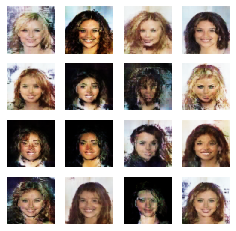

Epoch 19010, Discriminator: Loss: 0.15693031251430511 Accuracy: 0.978515625, Generator Loss: 7.034717559814453, Time: 6589.685982465744
Epoch 19020, Discriminator: Loss: 0.01938297552987933 Accuracy: 0.998046875, Generator Loss: 6.801288604736328, Time: 6593.031085252762
Epoch 19030, Discriminator: Loss: 0.1116393655538559 Accuracy: 0.98046875, Generator Loss: 6.822365760803223, Time: 6596.382810592651
Epoch 19040, Discriminator: Loss: 0.031150780618190765 Accuracy: 0.994140625, Generator Loss: 7.13464879989624, Time: 6599.740857124329
Epoch 19050, Discriminator: Loss: 0.14565904065966606 Accuracy: 0.970703125, Generator Loss: 6.29817008972168, Time: 6603.081209659576
Epoch 19060, Discriminator: Loss: 0.05521952547132969 Accuracy: 0.990234375, Generator Loss: 6.240276336669922, Time: 6606.42117357254
Epoch 19070, Discriminator: Loss: 0.09422394260764122 Accuracy: 0.986328125, Generator Loss: 5.922142028808594, Time: 6609.777884721756
Epoch 19080, Discriminator: Loss: 0.0506859719753265

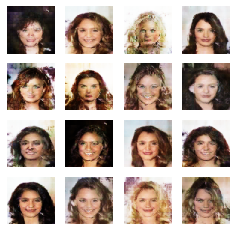

Epoch 19110, Discriminator: Loss: 0.09907961823046207 Accuracy: 0.9765625, Generator Loss: 6.17140531539917, Time: 6624.199395656586
Epoch 19120, Discriminator: Loss: 0.06073335371911526 Accuracy: 0.9921875, Generator Loss: 7.599456787109375, Time: 6627.541069507599
Epoch 19130, Discriminator: Loss: 0.0872938372194767 Accuracy: 0.98046875, Generator Loss: 7.118618488311768, Time: 6630.893176317215
Epoch 19140, Discriminator: Loss: 0.06640204414725304 Accuracy: 0.984375, Generator Loss: 5.836254119873047, Time: 6634.256103038788
Epoch 19150, Discriminator: Loss: 0.059339506551623344 Accuracy: 0.986328125, Generator Loss: 7.15666389465332, Time: 6637.594114303589
Epoch 19160, Discriminator: Loss: 0.12245578318834305 Accuracy: 0.974609375, Generator Loss: 7.45965576171875, Time: 6640.938683748245
Epoch 19170, Discriminator: Loss: 0.04220786690711975 Accuracy: 0.994140625, Generator Loss: 6.439509391784668, Time: 6644.289954900742
Epoch 19180, Discriminator: Loss: 0.057917093858122826 Accu

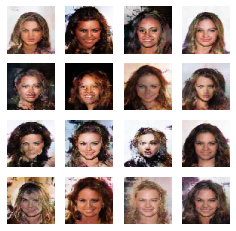

Epoch 19210, Discriminator: Loss: 0.10886026546359062 Accuracy: 0.982421875, Generator Loss: 6.8042731285095215, Time: 6658.47137761116
Epoch 19220, Discriminator: Loss: 0.07447792030870914 Accuracy: 0.994140625, Generator Loss: 7.030635356903076, Time: 6661.824860572815
Epoch 19230, Discriminator: Loss: 0.051756877452135086 Accuracy: 0.990234375, Generator Loss: 6.412481784820557, Time: 6665.166766405106
Epoch 19240, Discriminator: Loss: 0.0832008495926857 Accuracy: 0.990234375, Generator Loss: 6.626918315887451, Time: 6668.513747930527
Epoch 19250, Discriminator: Loss: 0.05873151309788227 Accuracy: 0.994140625, Generator Loss: 7.997061729431152, Time: 6671.856416225433
Epoch 19260, Discriminator: Loss: 0.4462396465241909 Accuracy: 0.91796875, Generator Loss: 8.519599914550781, Time: 6675.213603973389
Epoch 19270, Discriminator: Loss: 0.19713827967643738 Accuracy: 0.958984375, Generator Loss: 4.3628830909729, Time: 6678.563869476318
Epoch 19280, Discriminator: Loss: 0.1399353258311748

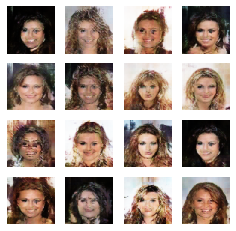

Epoch 19310, Discriminator: Loss: 0.09725104086101055 Accuracy: 0.9765625, Generator Loss: 5.91169548034668, Time: 6692.676186084747
Epoch 19320, Discriminator: Loss: 0.0778021290898323 Accuracy: 0.98828125, Generator Loss: 6.167054176330566, Time: 6696.017000436783
Epoch 19330, Discriminator: Loss: 0.07446479424834251 Accuracy: 0.982421875, Generator Loss: 5.431636810302734, Time: 6699.356929302216
Epoch 19340, Discriminator: Loss: 0.050515612587332726 Accuracy: 0.9921875, Generator Loss: 6.642740726470947, Time: 6702.702399492264
Epoch 19350, Discriminator: Loss: 0.08352160826325417 Accuracy: 0.984375, Generator Loss: 6.439289569854736, Time: 6706.0479555130005
Epoch 19360, Discriminator: Loss: 0.1024315282702446 Accuracy: 0.986328125, Generator Loss: 6.202383041381836, Time: 6709.393029212952
Epoch 19370, Discriminator: Loss: 0.04710263013839722 Accuracy: 0.990234375, Generator Loss: 7.1690239906311035, Time: 6712.752712249756
Epoch 19380, Discriminator: Loss: 0.31458535976707935 Ac

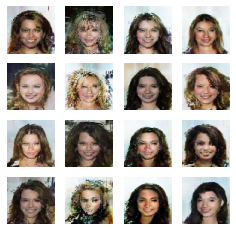

Epoch 19410, Discriminator: Loss: 0.08865842595696449 Accuracy: 0.98828125, Generator Loss: 5.921133041381836, Time: 6726.862268447876
Epoch 19420, Discriminator: Loss: 0.07998473383486271 Accuracy: 0.98828125, Generator Loss: 5.956446647644043, Time: 6730.204422712326
Epoch 19430, Discriminator: Loss: 0.07826992683112621 Accuracy: 0.98828125, Generator Loss: 6.418178558349609, Time: 6733.553647518158
Epoch 19440, Discriminator: Loss: 0.08758795261383057 Accuracy: 0.986328125, Generator Loss: 6.413846015930176, Time: 6736.911208868027
Epoch 19450, Discriminator: Loss: 0.04942163825035095 Accuracy: 0.9921875, Generator Loss: 6.638401031494141, Time: 6740.251491308212
Epoch 19460, Discriminator: Loss: 0.10401704907417297 Accuracy: 0.978515625, Generator Loss: 6.632057189941406, Time: 6743.600578784943
Epoch 19470, Discriminator: Loss: 0.06821850966662169 Accuracy: 0.990234375, Generator Loss: 6.630995273590088, Time: 6746.982248544693
Epoch 19480, Discriminator: Loss: 0.14252222701907158

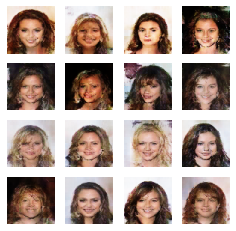

Epoch 19510, Discriminator: Loss: 0.12101966887712479 Accuracy: 0.982421875, Generator Loss: 6.818469524383545, Time: 6761.392241001129
Epoch 19520, Discriminator: Loss: 0.10859232395887375 Accuracy: 0.982421875, Generator Loss: 5.198622226715088, Time: 6764.743537902832
Epoch 19530, Discriminator: Loss: 0.10915359389036894 Accuracy: 0.9765625, Generator Loss: 5.322889804840088, Time: 6768.096396446228
Epoch 19540, Discriminator: Loss: 0.07864790223538876 Accuracy: 0.986328125, Generator Loss: 5.9122772216796875, Time: 6771.447001695633
Epoch 19550, Discriminator: Loss: 0.08117394335567951 Accuracy: 0.984375, Generator Loss: 6.630972385406494, Time: 6774.803345441818
Epoch 19560, Discriminator: Loss: 0.07551490887999535 Accuracy: 0.98828125, Generator Loss: 6.591032981872559, Time: 6778.124373674393
Epoch 19570, Discriminator: Loss: 0.08767948299646378 Accuracy: 0.982421875, Generator Loss: 7.254915714263916, Time: 6781.47012090683
Epoch 19580, Discriminator: Loss: 0.056944336742162704

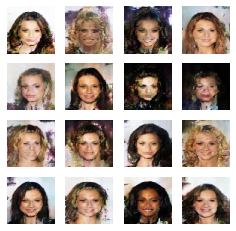

Epoch 19610, Discriminator: Loss: 0.04956430941820145 Accuracy: 0.9921875, Generator Loss: 6.229642868041992, Time: 6795.690460443497
Epoch 19620, Discriminator: Loss: 0.07844498753547668 Accuracy: 0.984375, Generator Loss: 6.4332075119018555, Time: 6799.030754804611
Epoch 19630, Discriminator: Loss: 0.06185704842209816 Accuracy: 0.98828125, Generator Loss: 6.522942543029785, Time: 6802.364561319351
Epoch 19640, Discriminator: Loss: 0.05459496192634106 Accuracy: 0.9921875, Generator Loss: 6.87583065032959, Time: 6805.7091274261475
Epoch 19650, Discriminator: Loss: 0.017851727083325386 Accuracy: 0.99609375, Generator Loss: 6.698827743530273, Time: 6809.062531471252
Epoch 19660, Discriminator: Loss: 0.07848379481583834 Accuracy: 0.986328125, Generator Loss: 6.4918131828308105, Time: 6812.407171964645
Epoch 19670, Discriminator: Loss: 0.06273399107158184 Accuracy: 0.990234375, Generator Loss: 6.321819305419922, Time: 6815.756619215012
Epoch 19680, Discriminator: Loss: 0.053456785157322884

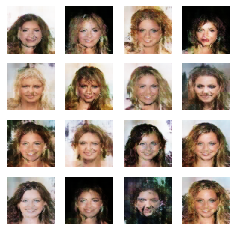

Epoch 19710, Discriminator: Loss: 0.04865537118166685 Accuracy: 0.9921875, Generator Loss: 6.769750595092773, Time: 6829.846160173416
Epoch 19720, Discriminator: Loss: 0.06892926804721355 Accuracy: 0.990234375, Generator Loss: 6.110599994659424, Time: 6833.197864532471
Epoch 19730, Discriminator: Loss: 0.16819211468100548 Accuracy: 0.97265625, Generator Loss: 8.178193092346191, Time: 6836.5560801029205
Epoch 19740, Discriminator: Loss: 0.12656867131590843 Accuracy: 0.984375, Generator Loss: 6.06696891784668, Time: 6839.907411813736
Epoch 19750, Discriminator: Loss: 0.04589401837438345 Accuracy: 0.990234375, Generator Loss: 6.712841033935547, Time: 6843.277145862579
Epoch 19760, Discriminator: Loss: 0.06360088475048542 Accuracy: 0.986328125, Generator Loss: 6.366546630859375, Time: 6846.6122534275055
Epoch 19770, Discriminator: Loss: 0.075272087007761 Accuracy: 0.990234375, Generator Loss: 6.728820323944092, Time: 6849.990875005722
Epoch 19780, Discriminator: Loss: 0.4414631128311157 Ac

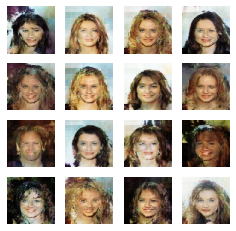

Epoch 19810, Discriminator: Loss: 0.07210217230021954 Accuracy: 0.982421875, Generator Loss: 6.4525933265686035, Time: 6864.422453403473
Epoch 19820, Discriminator: Loss: 0.058888135477900505 Accuracy: 0.986328125, Generator Loss: 7.335186958312988, Time: 6867.773366928101
Epoch 19830, Discriminator: Loss: 0.08345573581755161 Accuracy: 0.982421875, Generator Loss: 6.68881893157959, Time: 6871.138948440552
Epoch 19840, Discriminator: Loss: 0.03899610321968794 Accuracy: 0.998046875, Generator Loss: 7.1548943519592285, Time: 6874.491126537323
Epoch 19850, Discriminator: Loss: 0.06352705135941505 Accuracy: 0.984375, Generator Loss: 7.421253204345703, Time: 6877.852073192596
Epoch 19860, Discriminator: Loss: 0.05873320996761322 Accuracy: 0.990234375, Generator Loss: 6.713874340057373, Time: 6881.198999643326
Epoch 19870, Discriminator: Loss: 0.08270244300365448 Accuracy: 0.984375, Generator Loss: 7.40967321395874, Time: 6884.558963298798
Epoch 19880, Discriminator: Loss: 0.07182007469236851

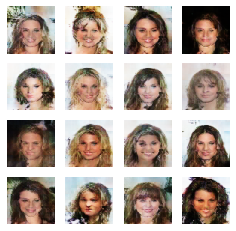

Epoch 19910, Discriminator: Loss: 0.16689731925725937 Accuracy: 0.970703125, Generator Loss: 6.105629920959473, Time: 6898.693503141403
Epoch 19920, Discriminator: Loss: 0.057744765654206276 Accuracy: 0.994140625, Generator Loss: 5.819066524505615, Time: 6902.05566906929
Epoch 19930, Discriminator: Loss: 0.11680566263385117 Accuracy: 0.9765625, Generator Loss: 7.552875518798828, Time: 6905.407581567764
Epoch 19940, Discriminator: Loss: 0.14425064623355865 Accuracy: 0.974609375, Generator Loss: 6.603397369384766, Time: 6908.770958900452
Epoch 19950, Discriminator: Loss: 0.1580476090312004 Accuracy: 0.970703125, Generator Loss: 6.544844627380371, Time: 6912.114817619324
Epoch 19960, Discriminator: Loss: 0.07062624953687191 Accuracy: 0.986328125, Generator Loss: 5.843405246734619, Time: 6915.466427564621
Epoch 19970, Discriminator: Loss: 0.07838603109121323 Accuracy: 0.98046875, Generator Loss: 5.888396739959717, Time: 6918.836807012558
Epoch 19980, Discriminator: Loss: 0.1209370158612728

In [50]:
start_time = time.time()

history = train(train_data, get_noise(16), 20000, 512)

Generate New Images

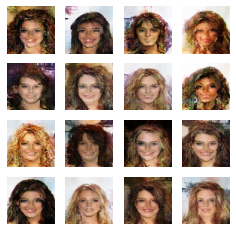

In [54]:
generate_images(16)